# Setup

## Load Libraries

In [2]:
library(tidyverse)
library(data.table)
library(broom)
library(dtplyr)
library(lme4) #for lmer & glmer models
library(lmerTest)
library(ggbeeswarm)
library(cowplot)
library(leaflet) # for maps
library(psych)
library(corrplot)
library(sjPlot) 
library(rstanarm)

── Attaching packages ──────────────────────────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.3.5     ✔ purrr   0.3.4
✔ tibble  3.1.2     ✔ dplyr   1.0.7
✔ tidyr   1.1.3     ✔ stringr 1.4.0
✔ readr   1.4.0     ✔ forcats 0.5.1

── Conflicts ─────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last


The following object is masked from ‘package:purrr’:

    transpose


Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack



Attaching package: ‘lmerTest’


The following object is masked from ‘package:lme4’:

    lmer


The following object is masked from ‘package:stats’:

    step



Attaching package: ‘psych’


The following objects are masked from ‘packa

## Load Sourced Files

In [2]:
#source("https://raw.githubusercontent.com/hauselin/Rcode/master/cleanQuestionnaire.R")
source("https://raw.githubusercontent.com/datavizpyr/data/master/half_flat_violinplot.R")
source('../r_gap_pilot/cleanQuestionnaire.R')

## Load Data

In [1]:
load('../../3_1_2_processed_data/VIB_measure_cleaned_data2022-03-04.RData')

This loads:

- `q_df` | the full Qualtrics dataframe with text responses
- `qn_df` | full Qualtrics dataframe with numeric responses
- `q_df1` | First run on SONA
- `ib_measures_df` | Intention behavior gap measures
- `eisen_quad` | Eisenhower quadrant values
- `validation_measures` | Individual difference questionnaires
- `prescreen` | SONA prescreen info (selected in `01_VIB Gap DataMunge`

In [9]:
ib_measures_df = dplyr::select(ib_measures_df, -belief_achieve_gap, -overall_value_gap)

ERROR: Error: Can't subset columns that don't exist.
[31m✖[39m Column `overall_value_gap` doesn't exist.


# Overview

## Timing

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,259,71.43095,35.11743,60.63333,66.47321,26.01963,21.4,188.6,167.2,1.296398,1.280701,2.182091


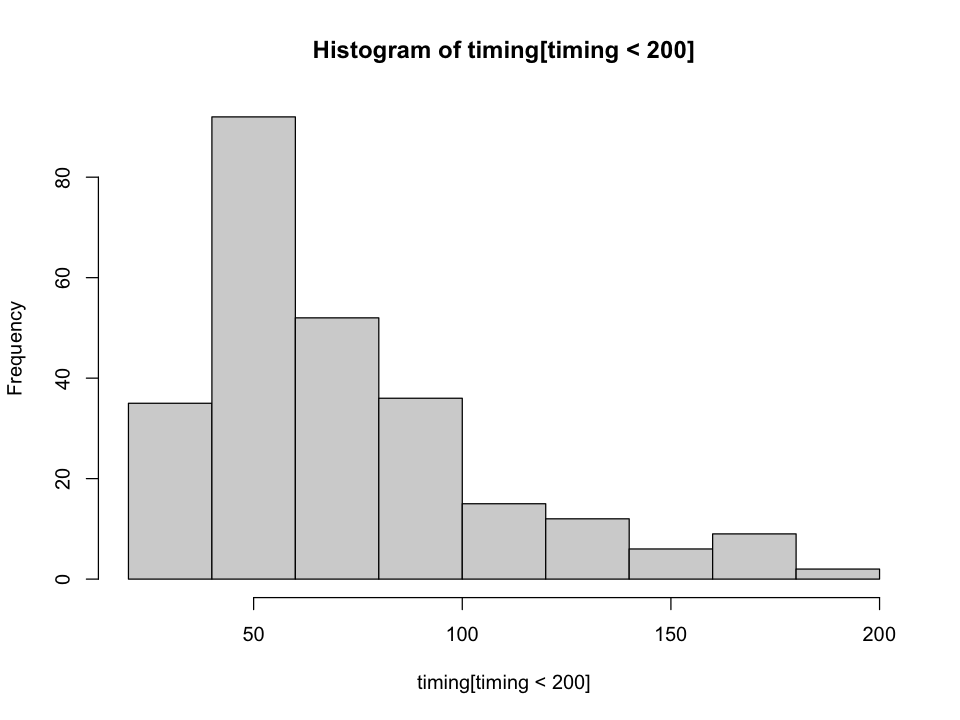

In [3]:
options(repr.plot.width = 8, repr.plot.height = 6)

timing = as.numeric(q_df$`Duration (in seconds)`)/60
hist(timing[timing<200])
describe(timing[timing<200])

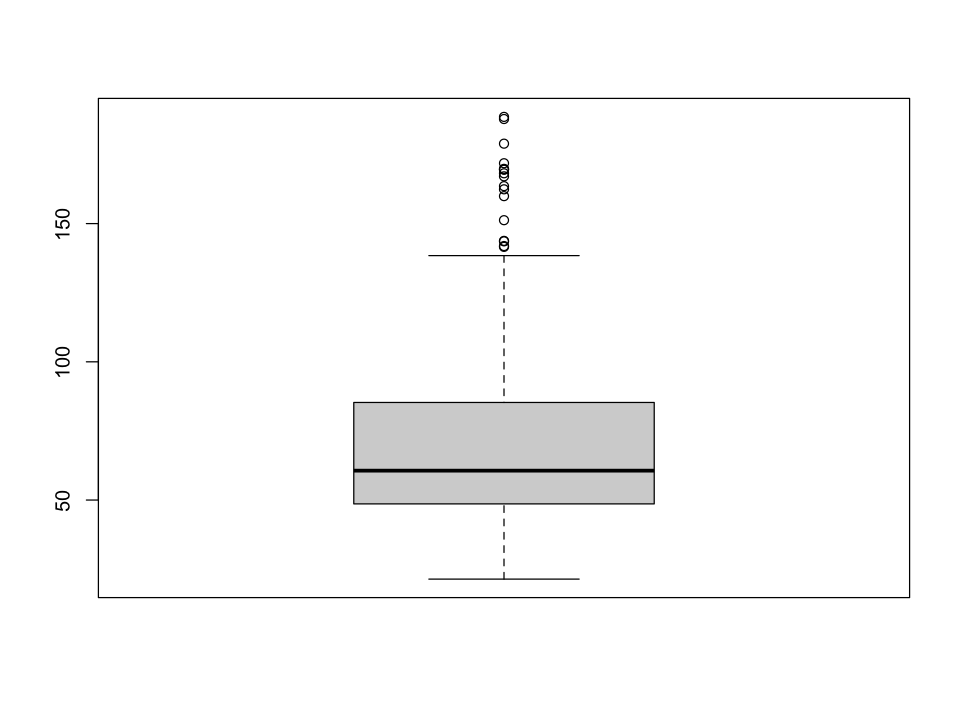

In [4]:
boxplot(timing[timing<200])

In [306]:
install.packages('Hmisc')

also installing the dependencies ‘jpeg’, ‘Formula’, ‘latticeExtra’, ‘htmlTable’





The downloaded binary packages are in
	/var/folders/h0/v65gsytx0_5blv0q7z__d4qm0000gn/T//RtmpTJhJ7Z/downloaded_packages


In [307]:
library(Hmisc)

Loading required package: lattice

Loading required package: survival

Loading required package: Formula


Attaching package: ‘Hmisc’


The following object is masked from ‘package:jtools’:

    %nin%


The following object is masked from ‘package:psych’:

    describe


The following objects are masked from ‘package:dplyr’:

    src, summarize


The following objects are masked from ‘package:base’:

    format.pval, units




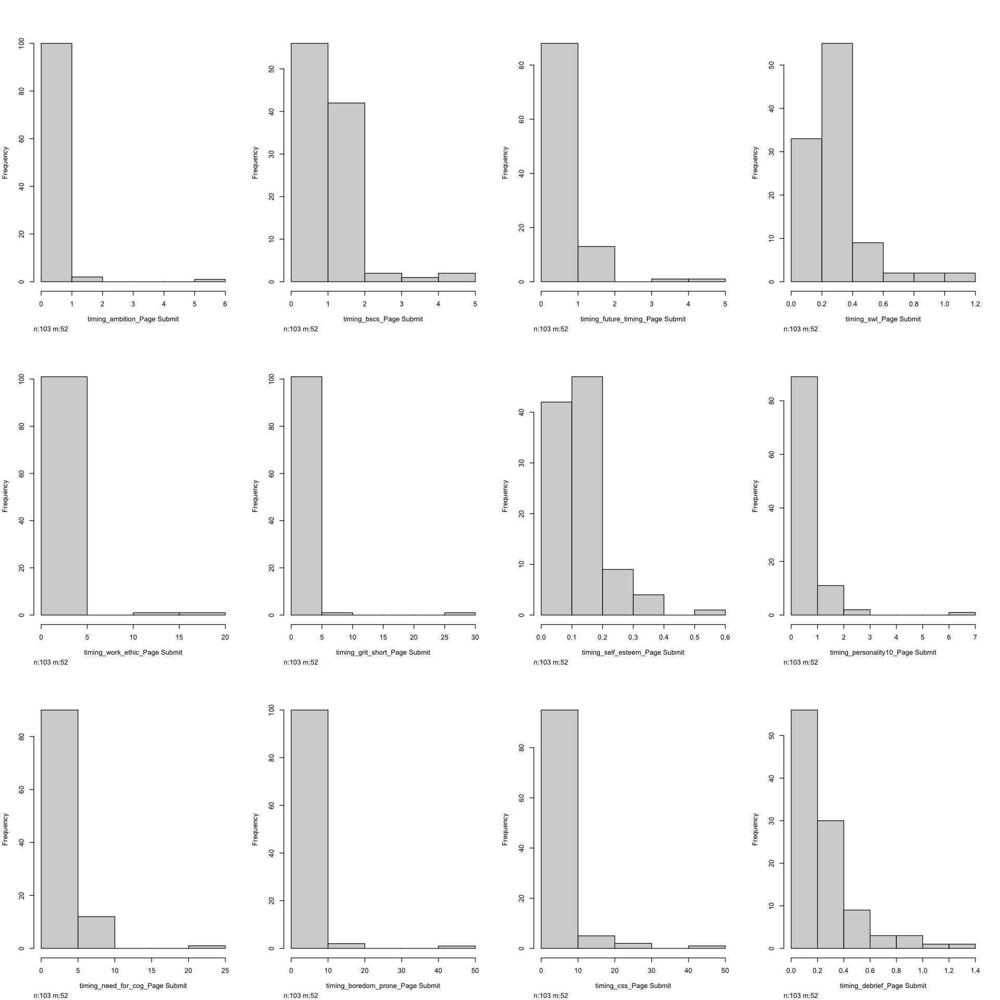

In [313]:
q_df %>%
as_tibble %>%
select(contains('submit')) %>%
lapply(as.numeric)%>%
lapply(function(x){x/60}) %>%
as_tibble %>%
hist.data.frame()


## Demographics

Select all columns that contain demographic information.

This is pulled from the two demographic blocks in the questionnaire: 
1. `demographic-standard`
2. `demographic-vib`

BMI was calculated from `height` and `weight`

### Geography

Take a look at where people are who are doing the questionnaire

In [5]:
leaflet() %>%
  addTiles() %>%
  addMarkers(lng = as.numeric(demographics$LocationLongitude), lat=as.numeric(demographics$LocationLatitude))

HTML widgets cannot be represented in plain text (need html)

### Gender

Breakdown...

In [6]:
options(repr.plot.width = 8, repr.plot.height = 6)


Female   Male  Other 
   203     80      6 

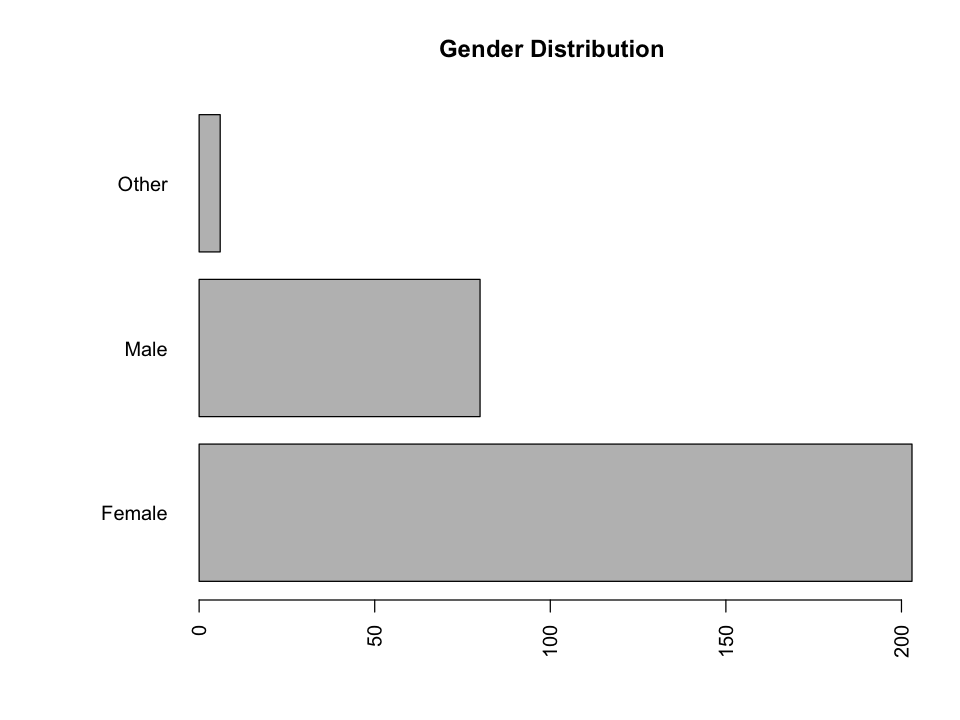

In [7]:
# Fitting Labels
par(las=2) # make label text perpendicular to axis
par(mar=c(5,8,4,2)) # increase y-axis margin.

counts <- table(demographics$gender)
barplot(counts, main="Gender Distribution", horiz=TRUE)
table(demographics$gender)

### Age

Breakdown...

**Note to self:** I changed the formatting of age from categorical to continuous which is giving all `na` values when applied to the old data...will be fixed when collecting new data

Also would be nice to look at effects of age on the gap...look at fluctuation of swl over lifespan and see how that maps to intention behavior gap

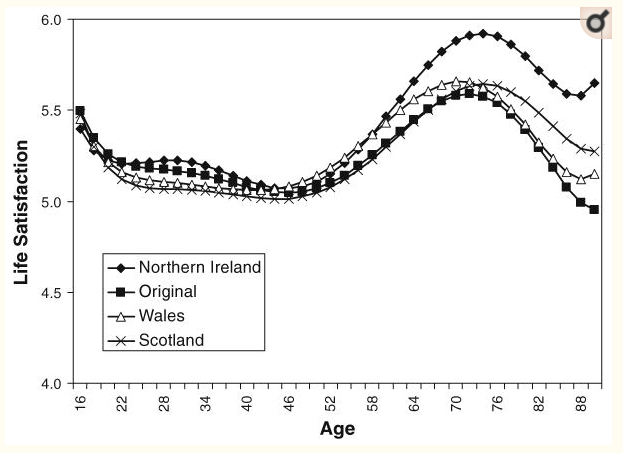

From [this paper](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2990956/)

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,289,18.76471,2.587362,18,18.29185,0,18,47,29,8.118396,78.58454,0.1521978


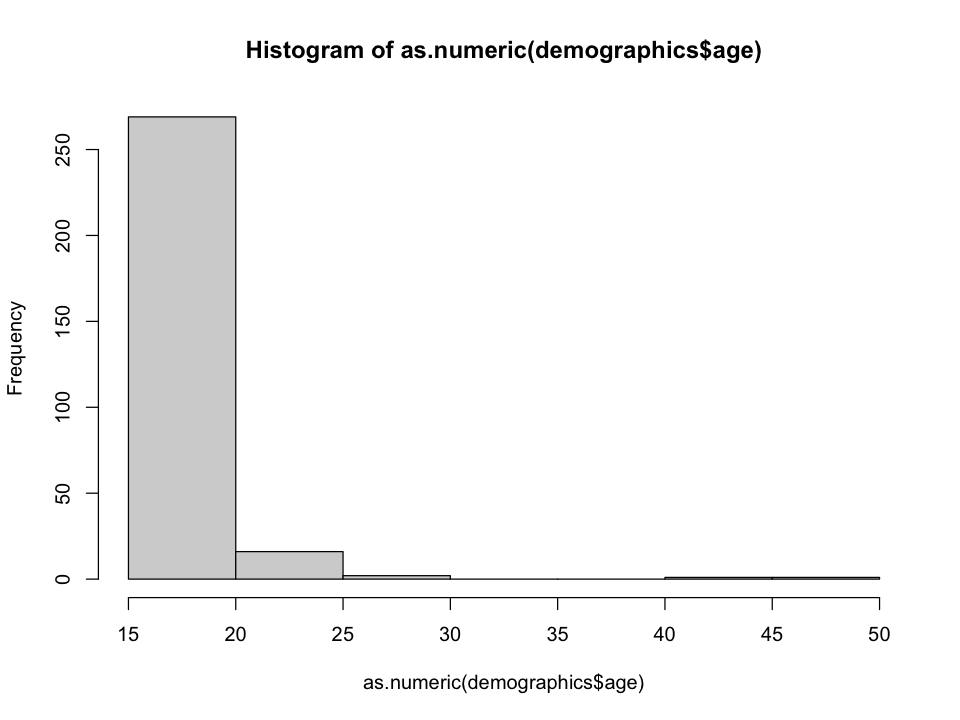

In [8]:
hist(as.numeric(demographics$age))
describe(as.numeric(demographics$age))

### Additional Characteristics

Breakdown...

**Note to self:** This is currently missing a number of additional questions which have since been added, including:

5. Past illegal activity charges/convictions (pending REB ammendment)



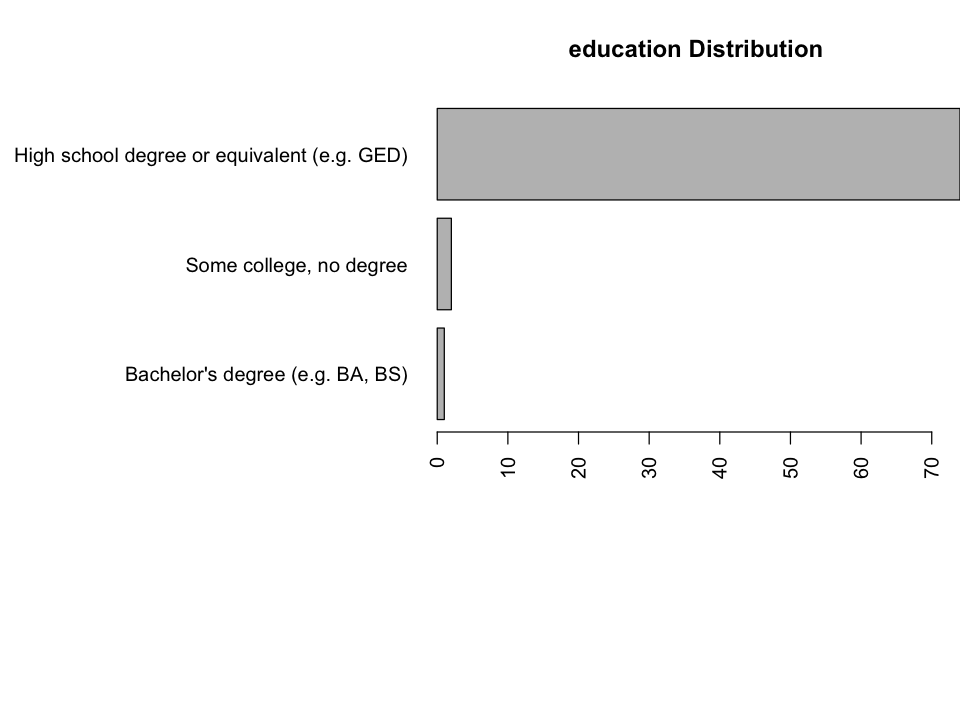

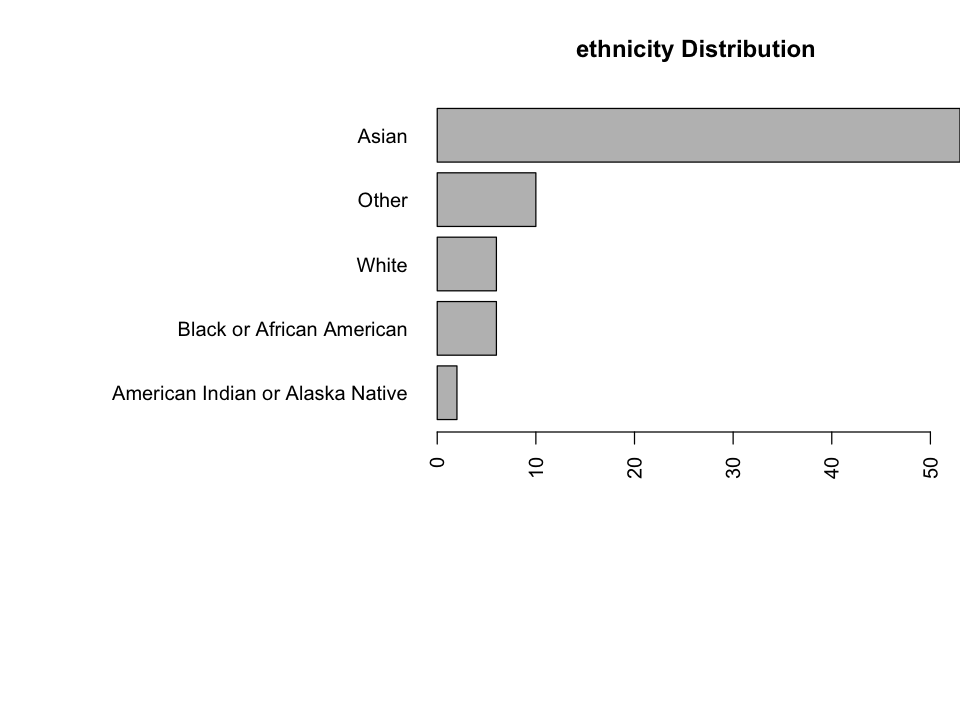

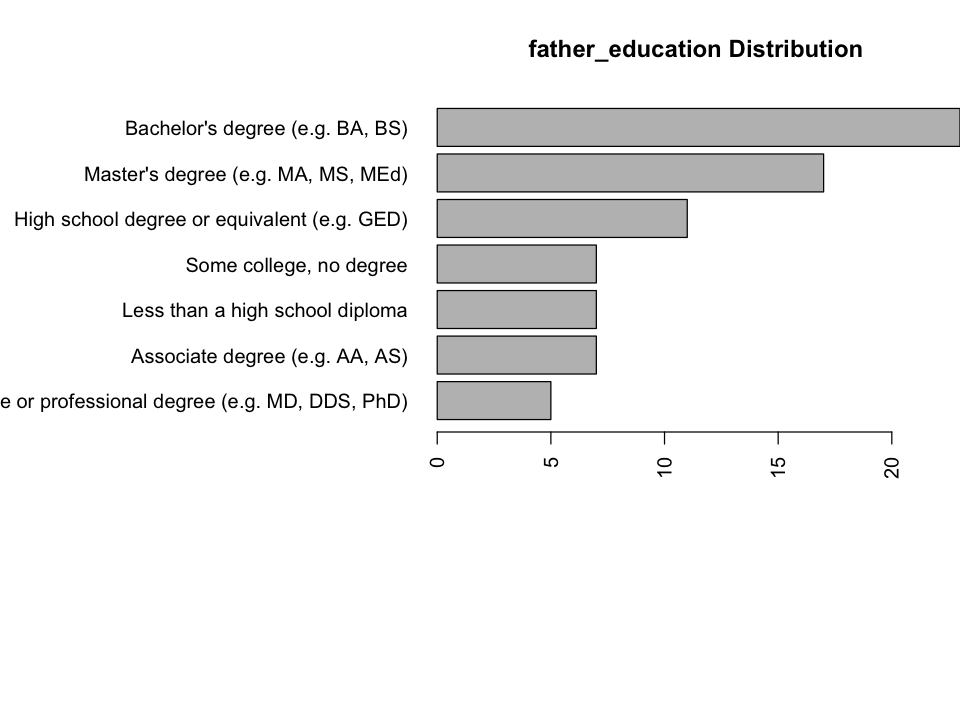

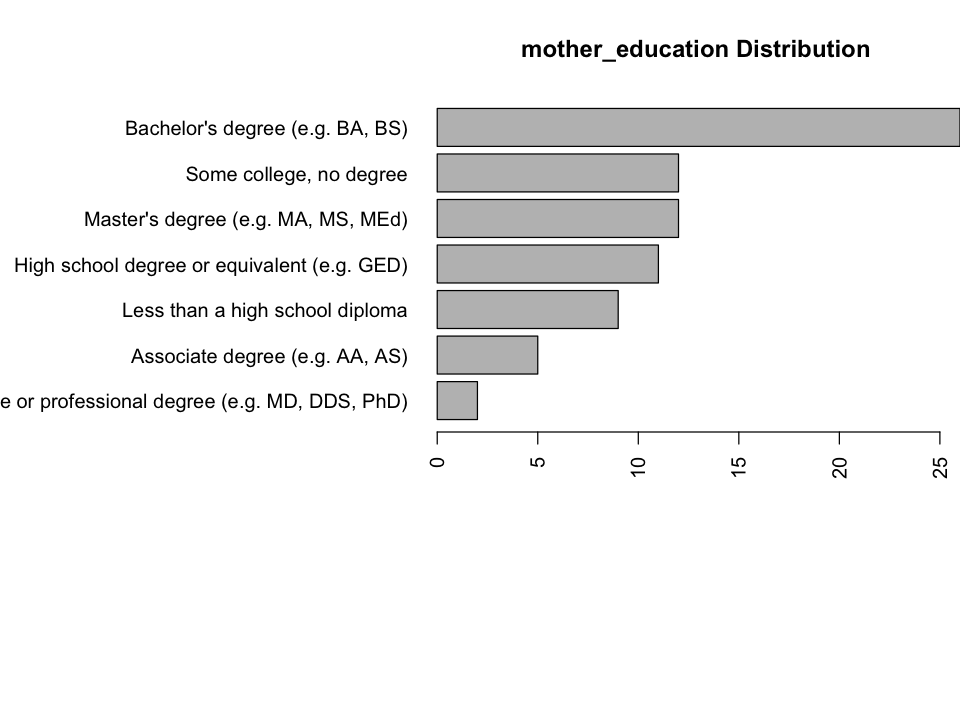

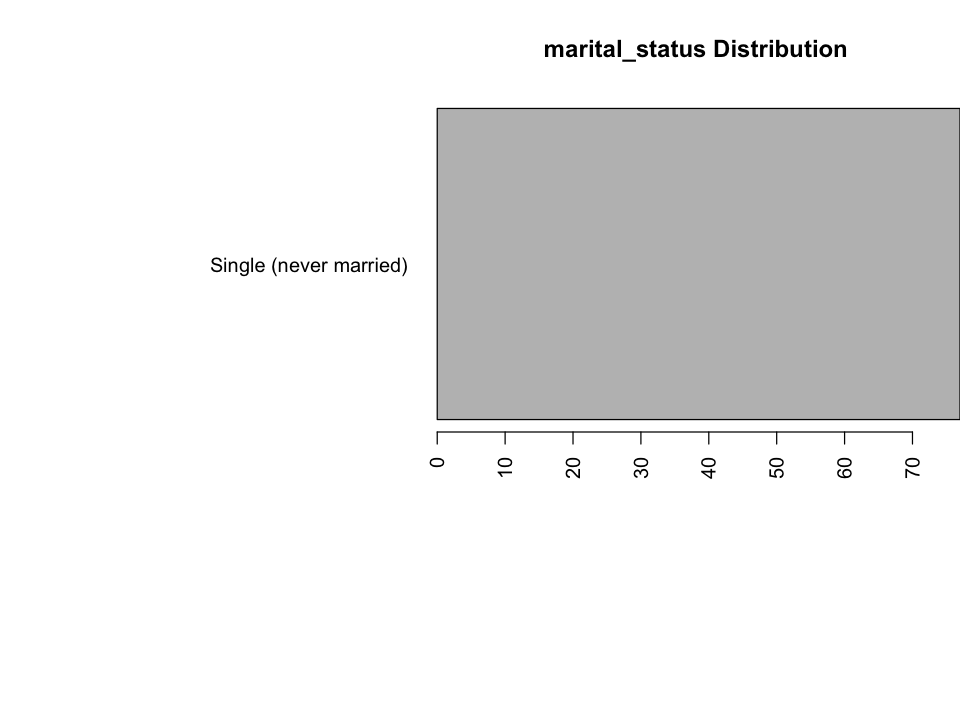

...

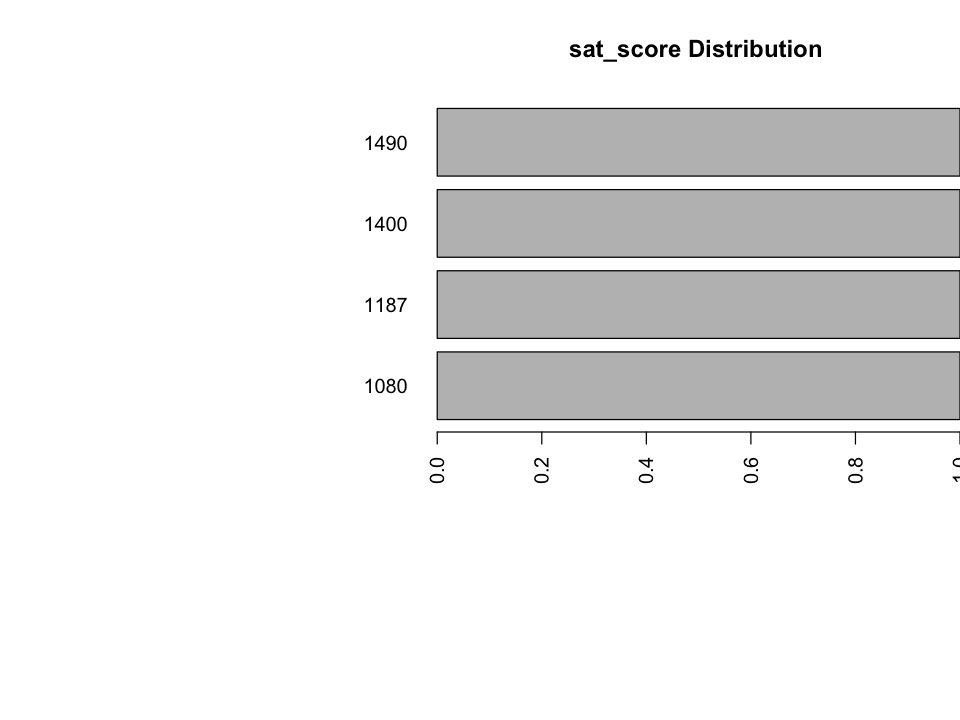

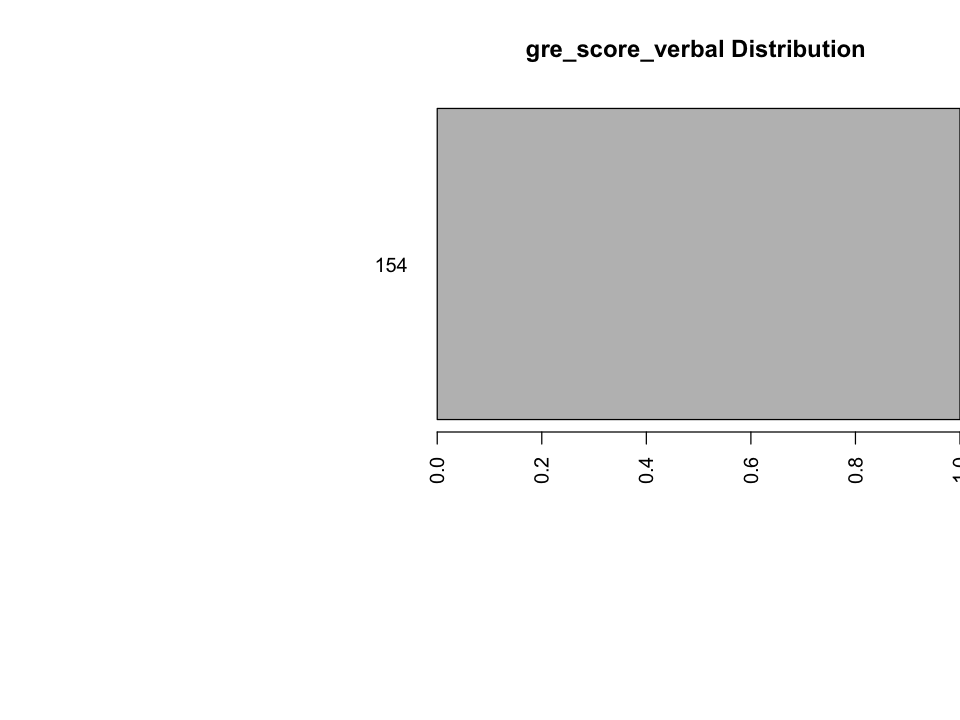

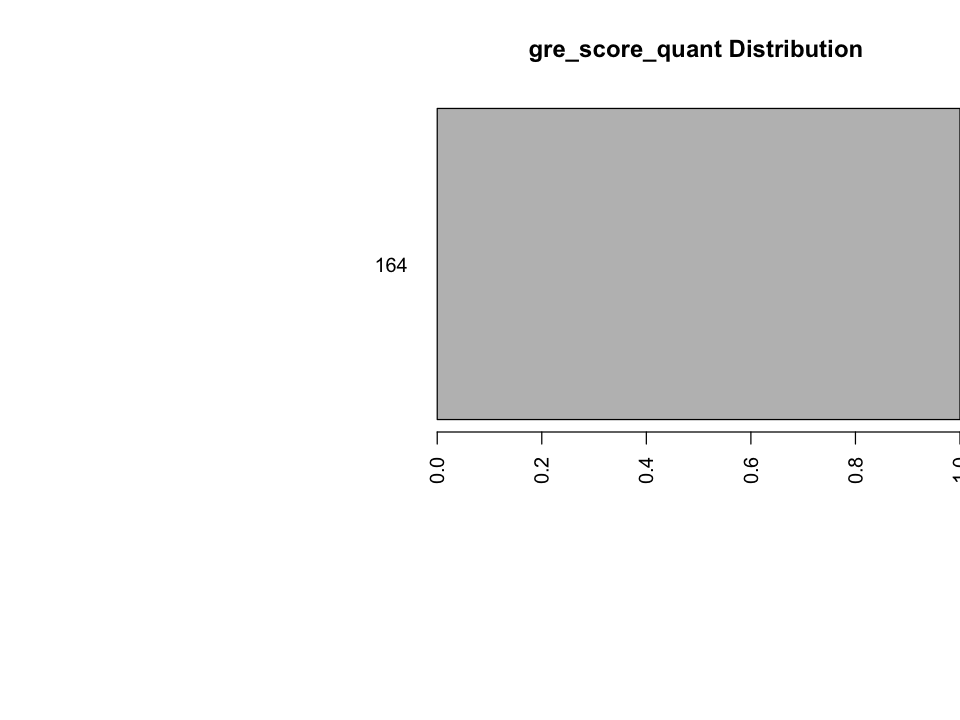

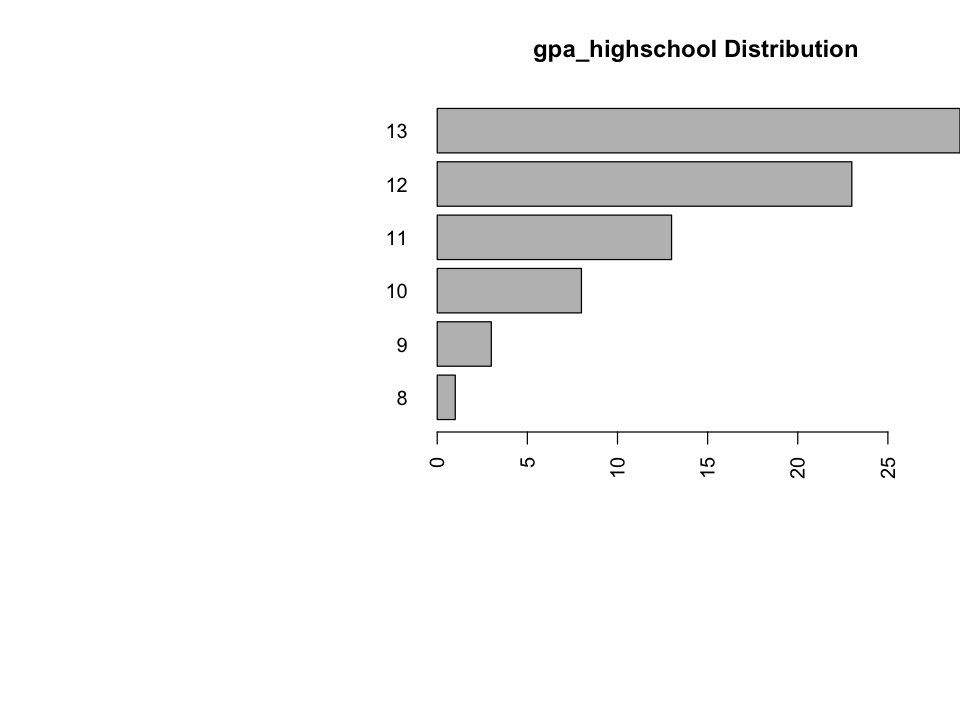

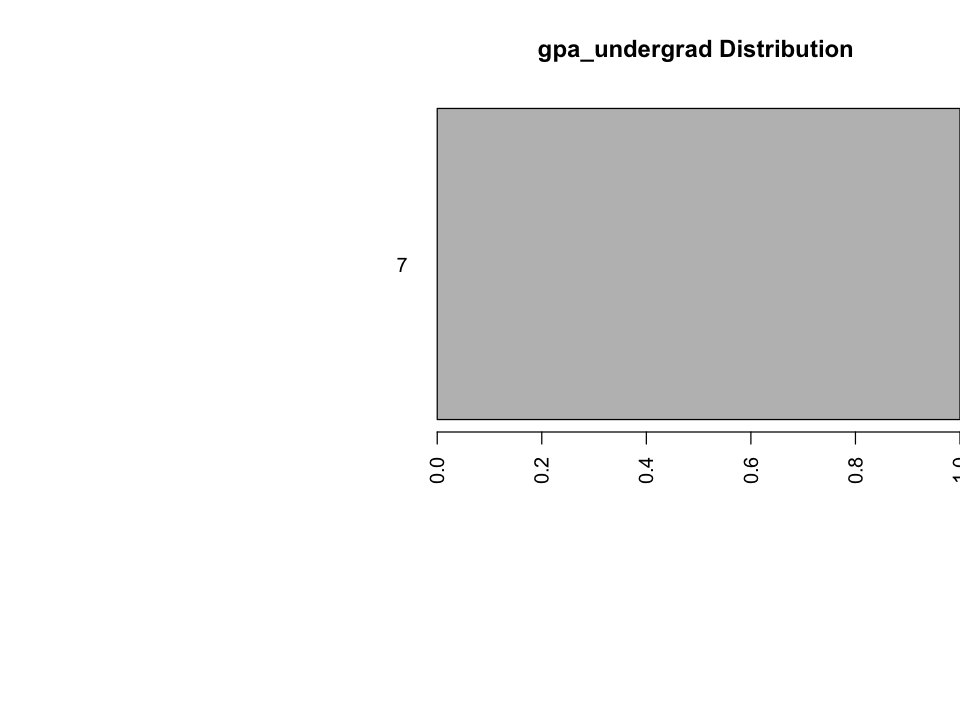

In [291]:
df = demographics[, education:gpa_undergrad]

for (i in seq_along(df)) {
    x = as.data.frame(df)[,i]

    # Fitting Labels
    par(las=2) # make label text perpendicular to axis
    par(mar=c(12,18,4,0)) # increase y-axis margin.

    counts <- table(x)
    barplot(sort(counts), main=paste0(names(df)[i],' Distribution'), horiz=TRUE)
    #print(table(x))
    
}

### Job

In [156]:
print(demographics$job)

 [1] "student"                                        
 [2] "Student"                                        
 [3] "student"                                        
 [4] "Student and library employee"                   
 [5] "student"                                        
 [6] "Student"                                        
 [7] "Student and employee at a food court restaurant"
 [8] "Student"                                        
 [9] "full time student"                              
[10] "student"                                        
[11] "student"                                        
[12] "student"                                        
[13] "student"                                        
[14] "student"                                        
[15] "student"                                        
[16] "Student, McDonald employee"                     
[17] "student"                                        
[18] "Student"                                        
[19] "Stud

### Accomplishments

In [314]:
print(demographics$accomplishments)

ERROR: Error in h(simpleError(msg, call)): error in evaluating the argument 'x' in selecting a method for function 'print': object 'demographics' not found


## Intention-Behavior

### Prescreen Gap

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,289,33.0346,17.74586,30,31.46352,14.826,0,91,91,0.7817596,0.0963634,1.043874


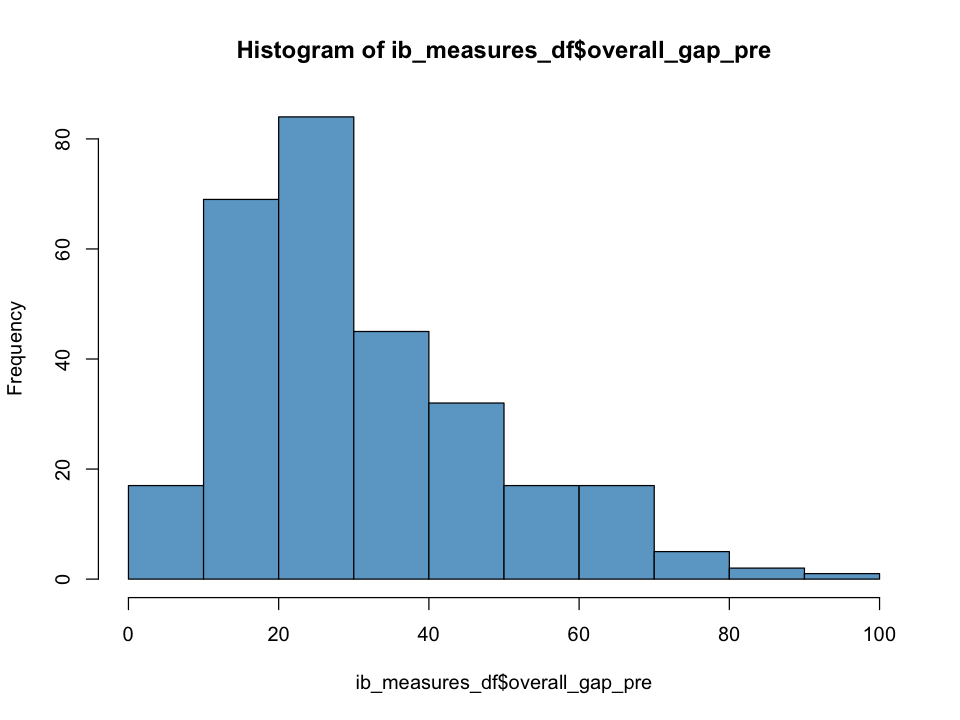

In [10]:
# plot
hist(ib_measures_df$overall_gap_pre, col = 'skyblue3')
describe(ib_measures_df$overall_gap_pre)

### Overall Gap | Pre/Post

Before beginning the measure we had subjects provide an initial estimate of their **Intention Behavior Gap**.

We asked:

>When you consider the intentions or goals that you have for yourself, to what degree do you feel like you are successful in actually accomplishing those goals?

>Please consider both big and small intentions or goals.

We asked them to respond on a scale of `0` to `100`, where `100` would indicate that they had *NO GAP*

Therefore the gap is calculated by:
$$IBGap{_{pre}} = 100 - Score$$

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,155,33.32258,18.49217,30,31.48,14.826,0,91,91,0.8911622,0.1996985,1.485327


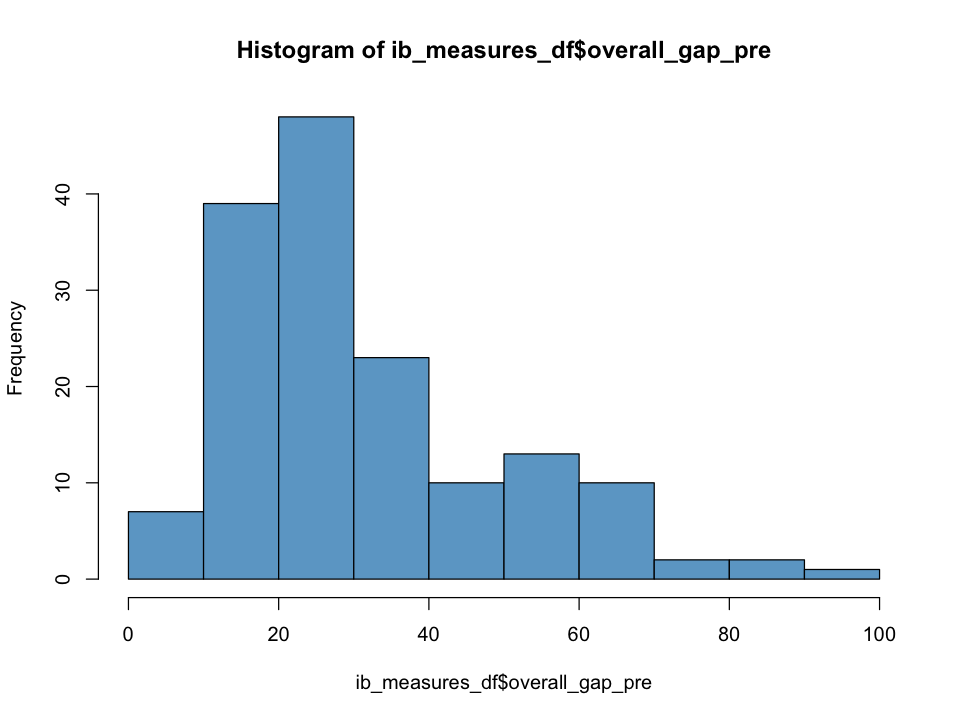

In [8]:
# plot
hist(ib_measures_df$overall_gap_pre, col = 'skyblue3')
describe(ib_measures_df$overall_gap_pre)

At the end of the measure we then asked the same question, requesting that they provide a single overall **Intention Behavior Gap** score.

We asked:

> Overall, When you consider all of the intentions and goals that you have for yourself, to what
degree do you feel like you are successful in actually accomplishing these goals and intentions?

> Please consider both big and small intentions or goals.

Again we asked them to respond on a scale of `0` to `100`, where `100` would indicate that they had *NO GAP*

Therefore the gap is calculated by:
$$IBGap{_{post}} = 100 - Score$$

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,155,36.93548,17.38214,35,36.48,20.7564,0,91,91,0.2965337,-0.2881636,1.396167


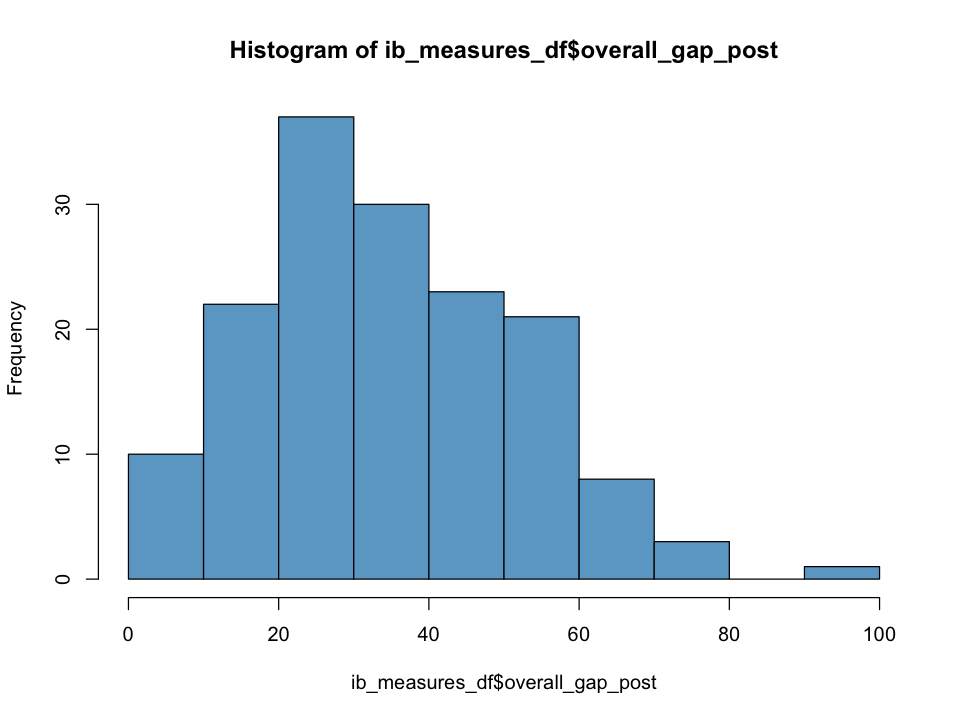

In [9]:
# plot
hist(ib_measures_df$overall_gap_post, col = 'skyblue3')
describe(ib_measures_df$overall_gap_post)

In [11]:
cor(ib_measures_df$overall_gap_pre, ib_measures_df$overall_gap_post)

[1] 0.6059377

In [12]:
t.test(ib_measures_df$overall_gap_pre, ib_measures_df$overall_gap_post, paired = TRUE)


	Paired t-test

data:  ib_measures_df$overall_gap_pre and ib_measures_df$overall_gap_post
t = -4.0026, df = 288, p-value = 7.976e-05
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -5.414669 -1.844847
sample estimates:
mean of the differences 
              -3.629758 


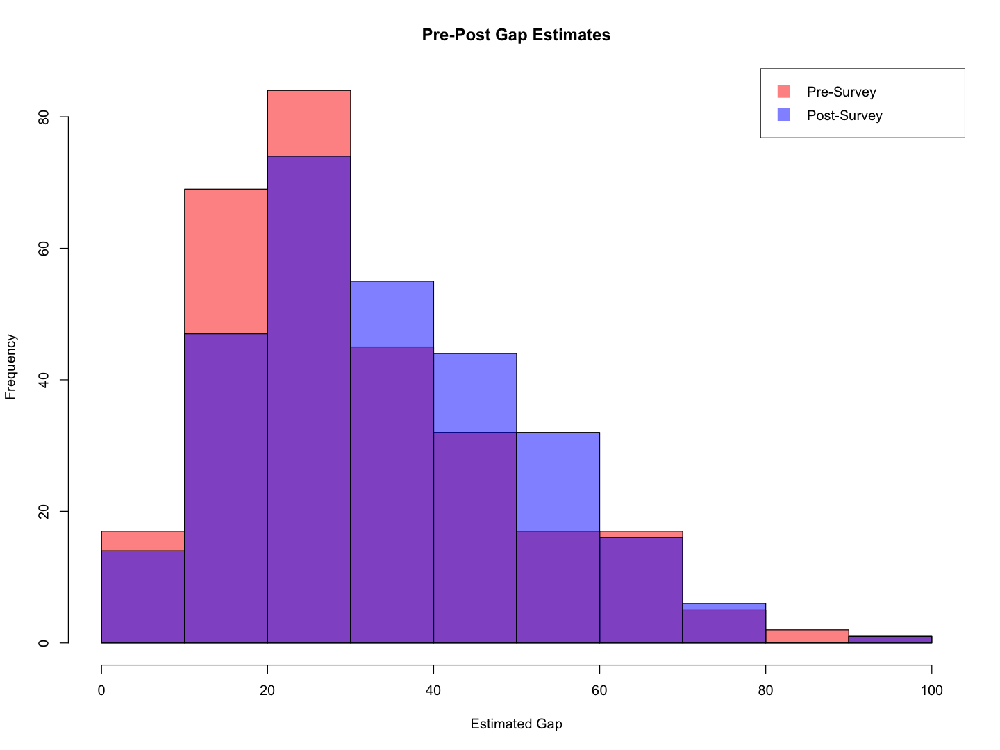

In [13]:
options(repr.plot.width = 12, repr.plot.height = 9)

# First distribution
hist(ib_measures_df$overall_gap_pre, breaks=10, xlim=c(0,100), col=rgb(1,0,0,0.5), xlab="Estimated Gap", 
     ylab="Frequency", main="Pre-Post Gap Estimates" )

# Second with add=T to plot on top
hist(ib_measures_df$overall_gap_post, breaks=10, xlim=c(0,100), col=rgb(0,0,1,0.5), add=T)

# Add legend
legend("topright", legend=c("Pre-Survey","Post-Survey"), col=c(rgb(1,0,0,0.5), 
     rgb(0,0,1,0.5)), pt.cex=2, pch=15 )

### Global Gap

The global action measure was an attempt to have people consider all the different **goals** and **intentions** they might set out for themselves across different timeframes:
- day
- week
- month
- year

We then asked them to estimate both their:
1. Beginning of day **belief** about what percentage of their intentions they would accomplish
2. End of day actual **achievement** of their goals and intentions

For example, for `day` the questions were:

**Achievement**
```
Please estimate to what extent, on AVERAGE, you achieve your goals, intentions, tasks and responsibilities on a DAILY basis.

For example, at the END OF THE DAY when you think about all of the things you hoped to do that day, what percentage do you usually accomplish?
```

**Belief**
```
A similar question but...

Now we would like to know at the BEGINNING OF EACH DAY, what percentage of your DAILY goals, tasks and responsibilities do you BELIEVE you will accomplish?

In other words, sometimes we set goals for ourselves without really believing we’ll get to them, but at least hoping we will. We want you to estimate what percentage of your goals you really, honestly believe you will accomplish each day.
```

We asked the same two questions for each timeframe listed above.

In [548]:
describe(ib_measures_df$overall_gap_pre)

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,156,33.29487,18.43567,30,31.46032,14.826,0,91,91,0.8980131,0.223745,1.476035


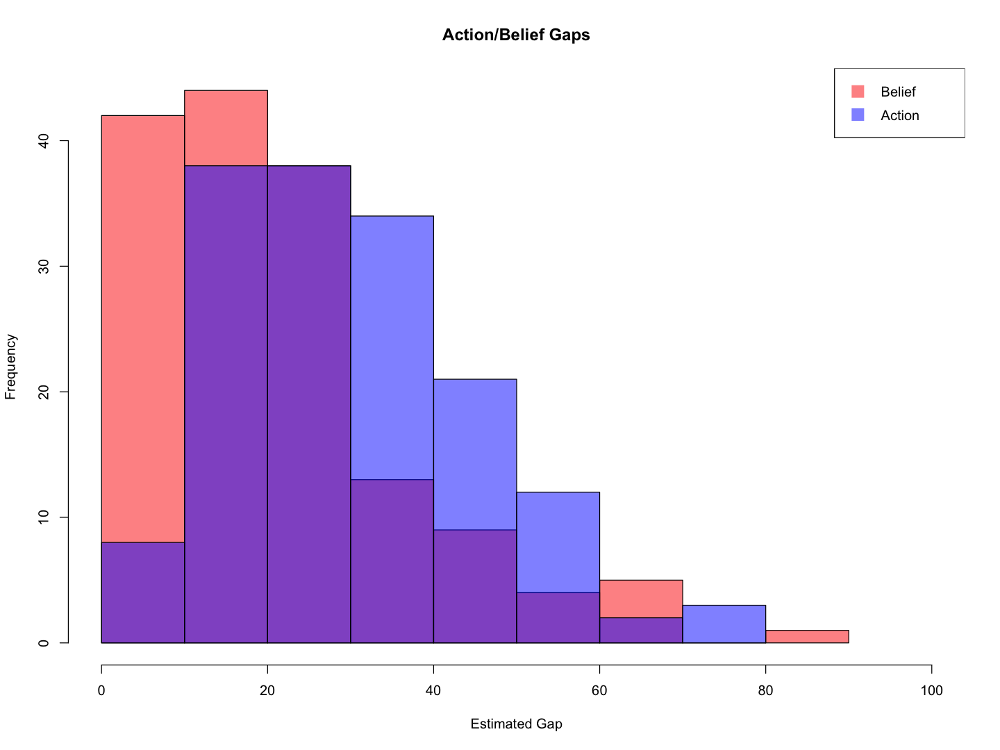

In [537]:
# First distribution
hist(ib_measures_df$global_belief_gap, breaks=10, xlim=c(0,100), col=rgb(1,0,0,0.5), xlab="Estimated Gap", 
     ylab="Frequency", main="Action/Belief Gaps" )

# Second with add=T to plot on top
hist(ib_measures_df$global_achieve_gap, breaks=10, xlim=c(0,100), col=rgb(0,0,1,0.5), add=T)

# Add legend
legend("topright", legend=c("Belief","Action"), col=c(rgb(1,0,0,0.5), 
     rgb(0,0,1,0.5)), pt.cex=2, pch=15 )

In [538]:
cor(ib_measures_df$global_achieve_gap, ib_measures_df$global_belief_gap)

[1] 0.4213996

In [539]:
t.test(ib_measures_df$global_achieve_gap, ib_measures_df$global_belief_gap, paired = TRUE)


	Paired t-test

data:  ib_measures_df$global_achieve_gap and ib_measures_df$global_belief_gap
t = 6.7585, df = 155, p-value = 2.664e-10
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
  6.391018 11.669880
sample estimates:
mean of the differences 
               9.030449 


**Note to self**:

Not sure how to think of `belief_achieve_gap` as a metric?

Perhaps should be correlated with **optimism** and or **ambition**?

### Categorical Gap

This version of the measure asked people to estimate the time they spent **on average per weekday** for a number of time use categories.

Subjects filled out how many hours they **actually** spent on each of these categories and also how much time they **intended** to spend on each category.

To calculate the gap we calculate as follows:

$$Gap = \frac{(\sum_{i=1}^{i=k} intendCategory_{i}) - 24}{24} * 100$$

where `k` is the number of categories of activities, and `intendCategory` is the duration of the activity

**Note to self:** Could be interesting to see what categories have the biggest/smallest gaps and in which direction...

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,156,19.63942,28.95755,12.5,15.66799,18.5325,-100,225,325,2.504157,17.03787,2.318459


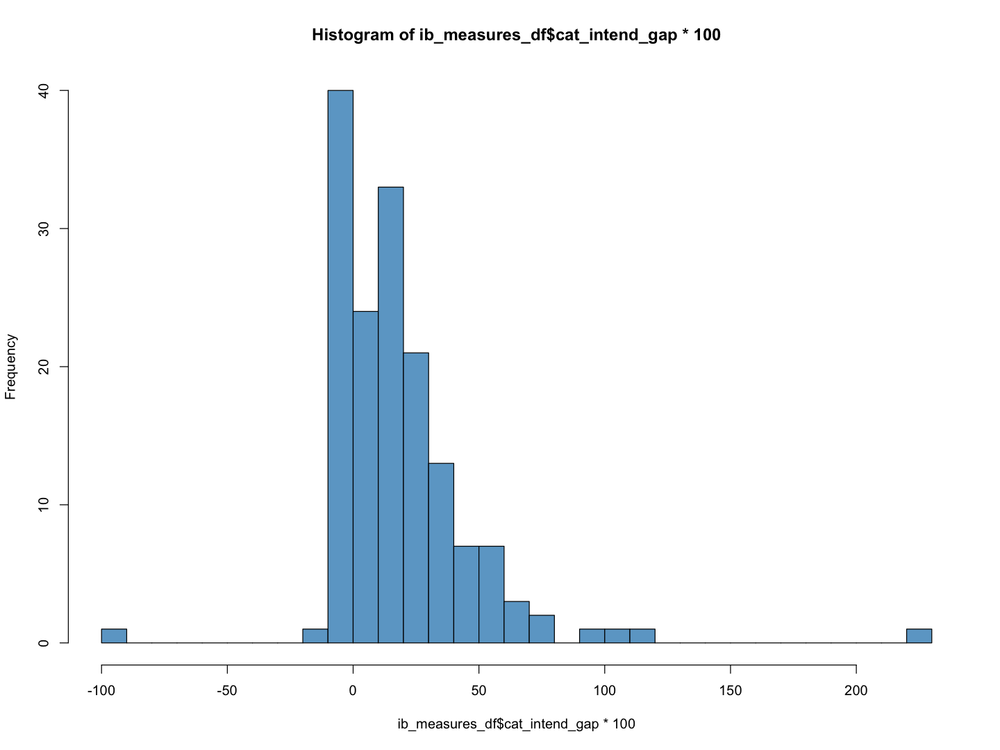

In [543]:
hist(ib_measures_df$cat_intend_gap*100, col = 'skyblue3', breaks = 25)
describe(ib_measures_df$cat_intend_gap*100)

Interesting how this is much more skewed toward zero than the `global_gap` measure. 

One interpretation could be that we actually spend our time doing what we plan to do, we just are bad at estimating how much we can get done during that time. i.e. the problem is not procrastination... More one of productivity and over-estimation...

### Domain Gap

The domain questions is similar to the `categorical gap` measure in that it asks about specific categories of activity but it differs in a few ways:

1. Many more (32) categories (i.e. greater specificity)
2. Opportunity to indicate that you do not have a goal in a category. e.g. perhaps you sleep a certain number of hours each night but you really do not have any sort of sleep goal. If you don't have a goal then we do not count it
3. Opportunity to indicate how important your goal is in each category. This can be used to "weight" the intention behavior gap if we like.
4. Indicate additional attributes of your goals in each category including:
    - `specificity`
    - `satisfaction`
    - `goal setting style`
    - `internal motivation`
    - `external motivation`
    - `gap cause`
    - `gap rank`
    
**Note to self:** Many other things to look at here, for example:
- what is the average gap if grouped by how important the goal is?
- what is the average gap if grouped by external motivation vs. internal motivation?
- etc...

### Unweighted

In [550]:
describe(ib_measures_df$domain_gap)

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,156,3.32865,1.022387,3.395652,3.365703,1.031374,0,6,6,-0.3044406,-0.06268065,0.0818565


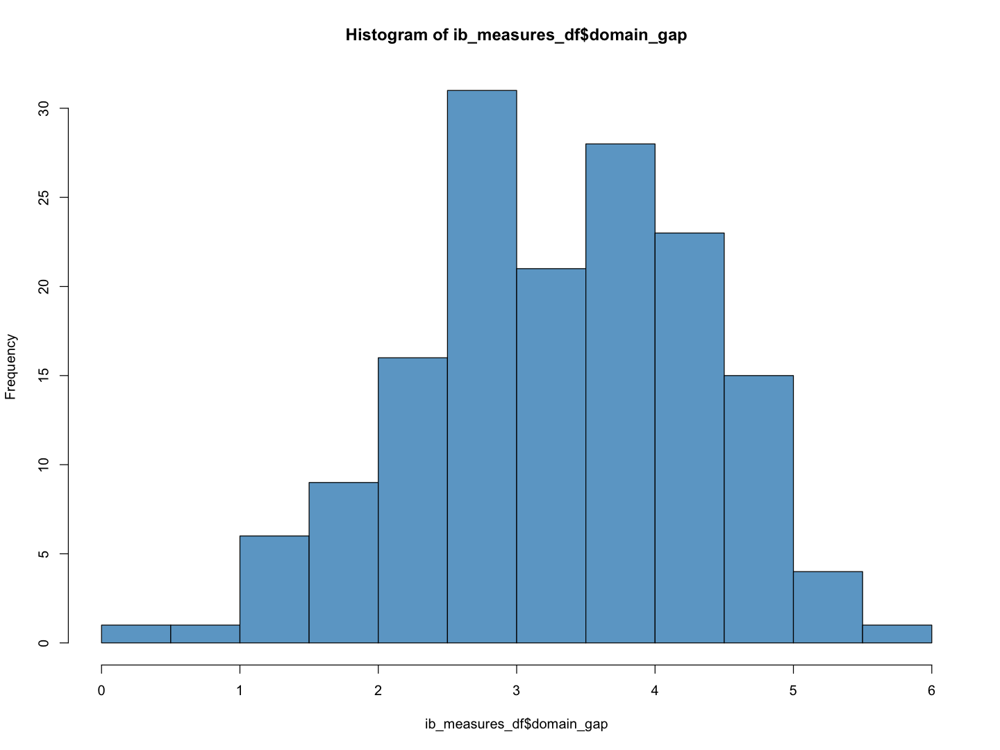

In [549]:
hist(ib_measures_df$domain_gap, col = 'skyblue3')

### Weighted

Assuming that people don't care about all domains equally, we think that the gap should reflect this.

In other words if you only care a bit about sleep and a lot about diet then a gap of 10% matters **more** in terms of diet.

**Note to self**: There is probably some point of indifference where improving diet and improving sleep converge...

---

The methods we are using is to use the following formula:

$$Gap = \frac{\sum_{i=1}^{i=k} ibDomainGap_{i} * ibDomainImportance_{i}}{k}$$

where `k` is the number of categories of domains, `ibDomainGap` is the goal domain, and `ibDomainImportance` is how important that domain is to the subject.

Note that `ibDomainImportance` was originally on a 7 point Likert scale but has been re-scaled to a 0.5 - 1.5 scale so that the gap is downweighted for domains that are less important and upweighted for domains that are more important.

In [552]:
describe(ib_measures_df$w_domain_gap)

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,156,3.662807,1.123142,3.579613,3.661335,0.9866643,0,7.5,7.5,0.08688617,0.7783026,0.08992334


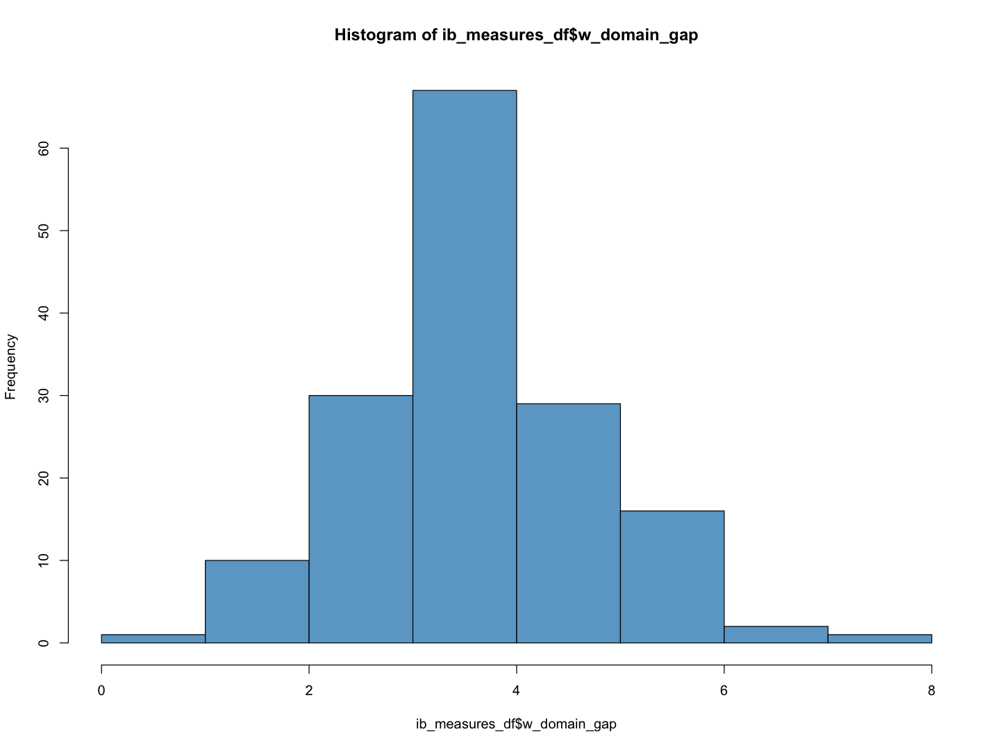

In [554]:
hist(ib_measures_df$w_domain_gap, col = 'skyblue3', breaks = 10)

### Goal Frequency

In [102]:
library(wordcloud)

Loading required package: RColorBrewer



In [138]:
head(scaled_domains_long)

,domain_num,subjectID,domains_specific,domains_success,domains_satis,domains_import,domains_ambitious,domains_internal,domains_external,domains_gapcause,domain_gap,w_domain_gap,domain_names,domain_names_short
,<int>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1,1,1,4.0,5.5,5.5,1.25,5.5,5.5,5.5,5.5,1.5,1.875,Diet,Diet
2,1,3,7.0,5.5,5.5,1.50,4.0,7.0,5.5,2.5,1.5,2.250,Diet,Diet
3,1,5,5.5,4.0,2.5,1.25,5.5,7.0,1.0,5.5,3.0,3.750,Diet,Diet
4,1,6,7.0,1.0,1.0,1.50,7.0,7.0,1.0,4.0,6.0,9.000,Diet,Diet
5,1,7,2.5,2.5,2.5,1.25,2.5,2.5,2.5,7.0,4.5,5.625,Diet,Diet
6,1,9,1.0,1.0,1.0,1.25,7.0,7.0,7.0,1.0,6.0,7.500,Diet,Diet


In [139]:
# use long dataframe from dataMunge step...
# get freqs

domain_freq = scaled_domains_long %>%
    as_tibble() %>%
    group_by(domain_names_short) %>%
    summarise(
        count = n(),
        importance = mean(domains_import),
        gap = mean(domain_gap),
        w_gap = mean(w_domain_gap),
        internal = mean(domains_internal)
    )

#### Word Cloud

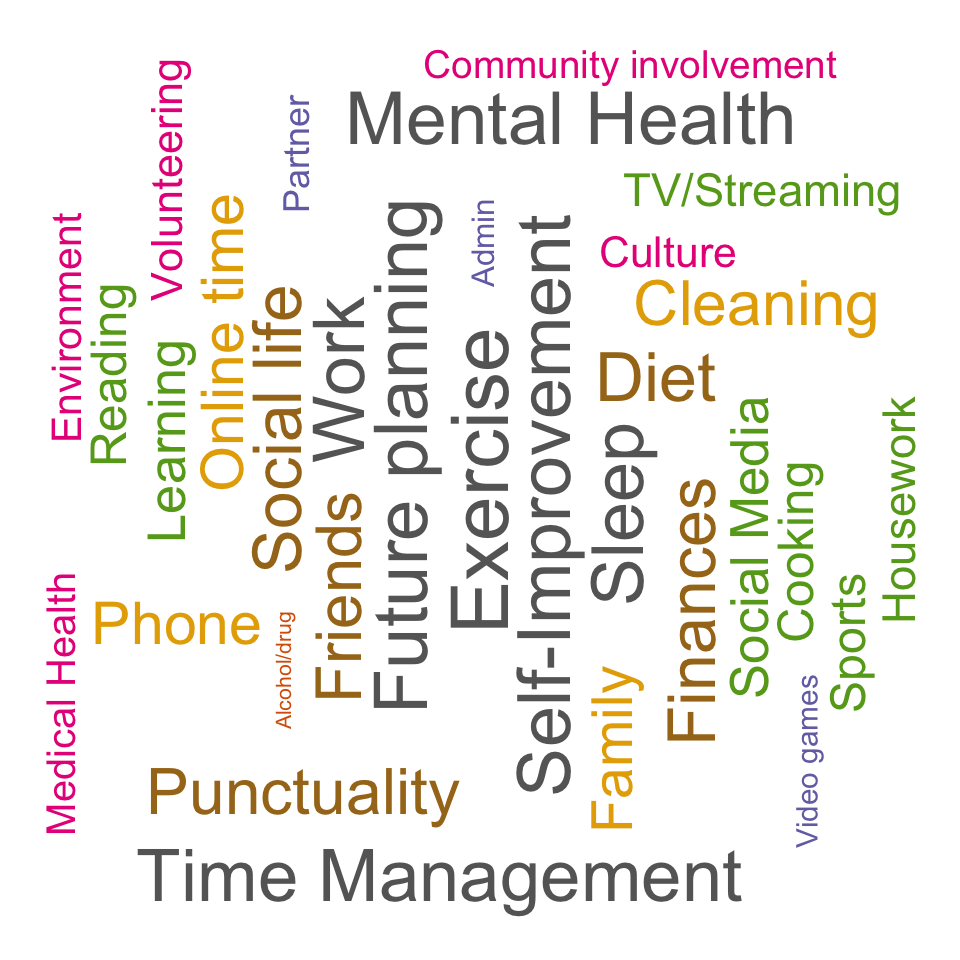

In [104]:
options(repr.plot.width = 8, repr.plot.height = 8)

set.seed(1234)
wordcloud(words = domain_freq$domain_names_short, freq = domain_freq$count, min.freq = 1,
          max.words=200, random.order=FALSE, rot.per=0.35, 
          colors=brewer.pal(8, "Dark2"))

#### Bar Plot

In [105]:
library(viridis)

Loading required package: viridisLite



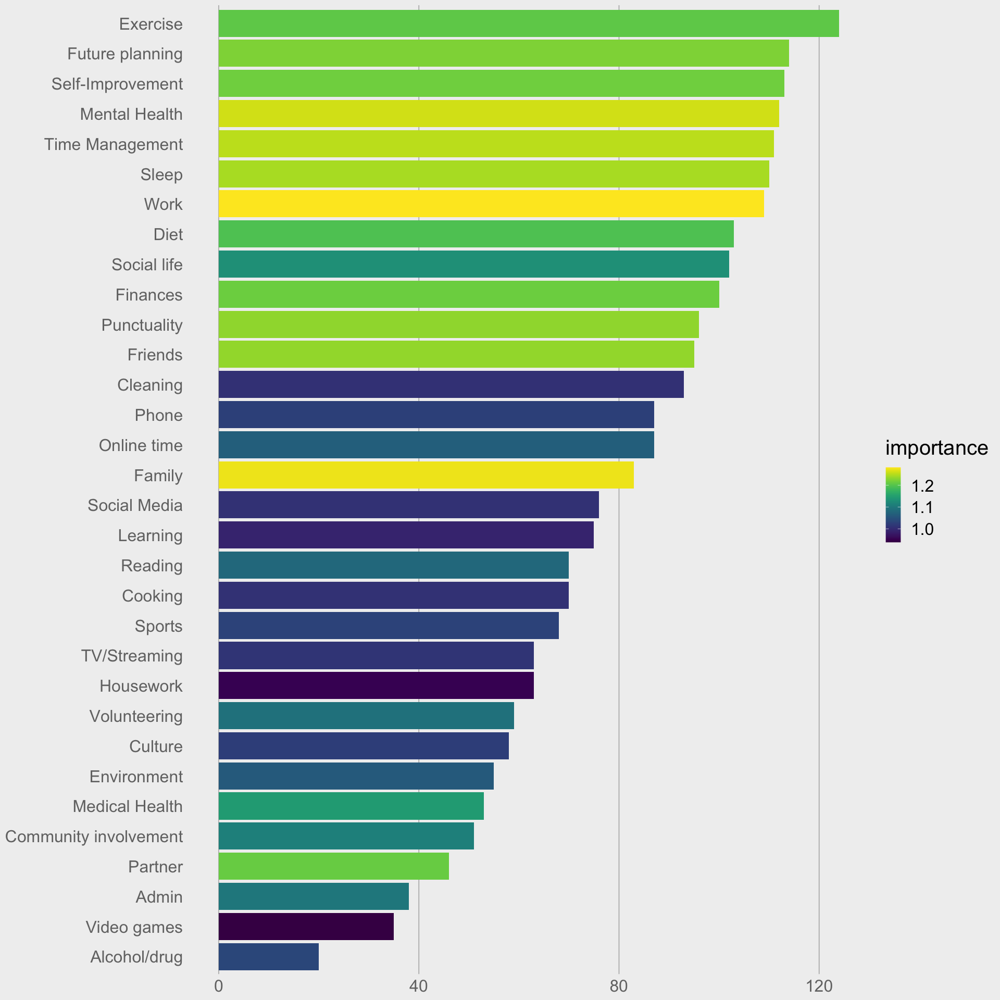

In [113]:
options(repr.plot.width = 16, repr.plot.height = 16)

ggplot(domain_freq, aes(x= reorder(domain_names_short, count), y=count, fill = importance)) +
    geom_bar(stat='identity') +
    scale_fill_viridis() +
    coord_flip() +
    theme_538() +
    theme(text = element_text(size=24),
          axis.title.x = element_blank(),
          axis.title.y = element_blank())

### Intention Importance

In [109]:
library(ggridges)

Picking joint bandwidth of 0.0967



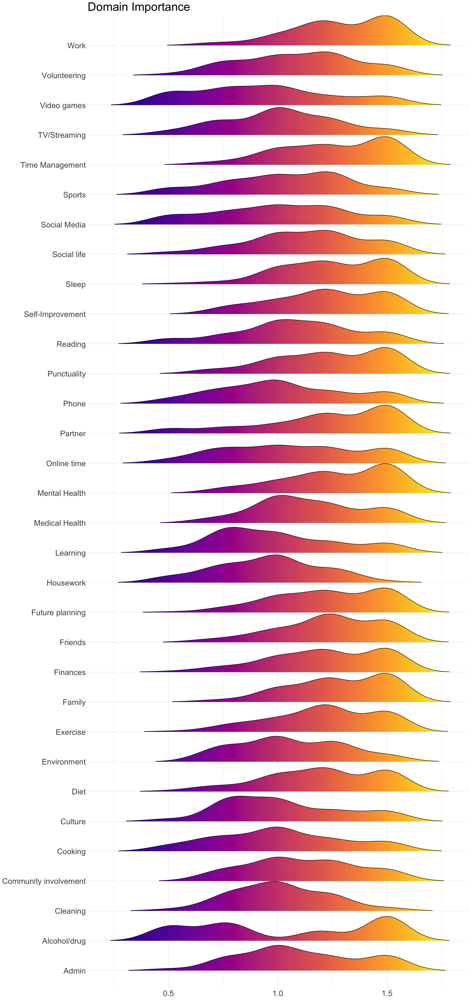

In [110]:
options(repr.plot.width = 16, repr.plot.height = 34)

ggplot(scaled_domains_long, aes(x = domains_import, y = domain_names_short, fill = ..x..)) +
  geom_density_ridges_gradient(scale = 1, rel_min_height = 0.01) +
  scale_fill_viridis(name = "Domain Importance", option = "C") +
  labs(title = 'Domain Importance') +
  theme_minimal() +
    theme(
      legend.position="none",
      panel.spacing = unit(0.1, "lines"),
      strip.text.x = element_text(size = 8),
        text = element_text(size=24),
          axis.title.x = element_blank(),
          axis.title.y = element_blank()
    )

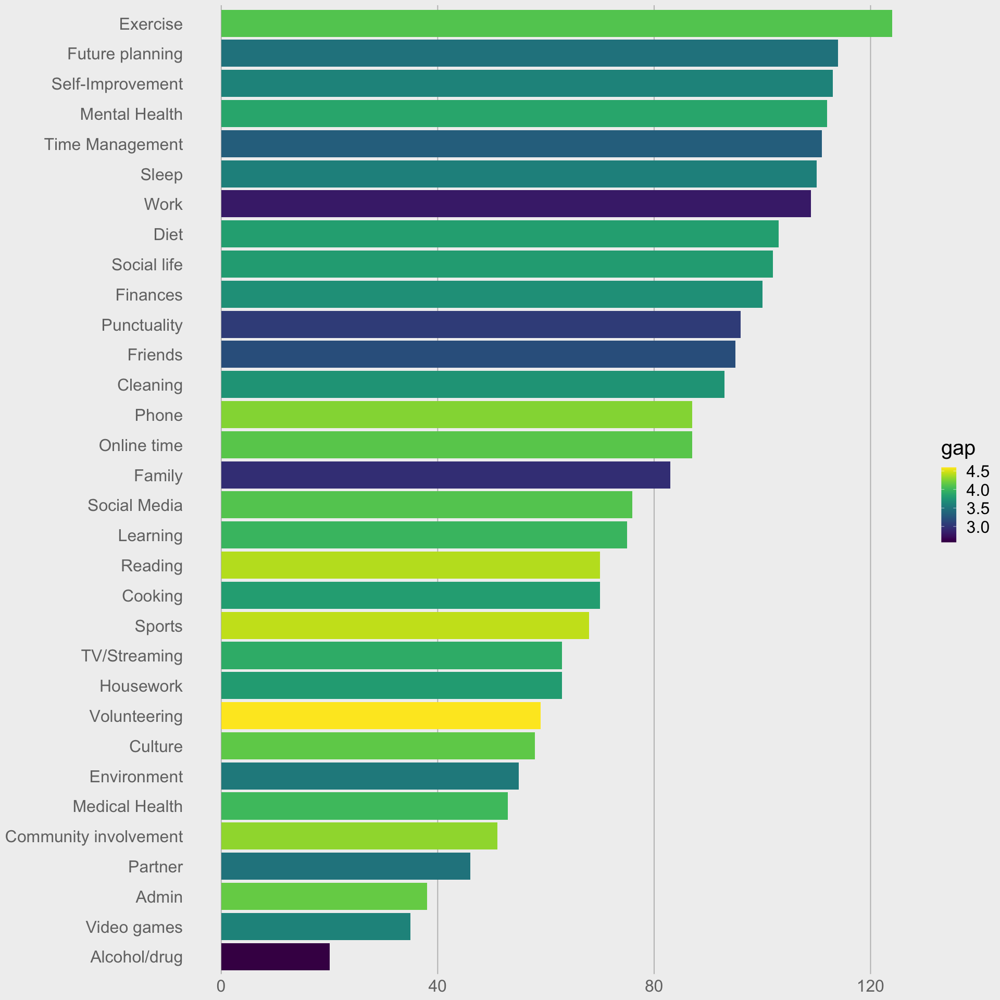

In [117]:
options(repr.plot.width = 16, repr.plot.height = 16)

ggplot(domain_freq, aes(x= reorder(domain_names_short, count), y=count, fill = gap)) +
    geom_bar(stat='identity') +
    scale_fill_viridis() +
    coord_flip() +
    theme_538() +
    theme(text = element_text(size=24),
          axis.title.x = element_blank(),
          axis.title.y = element_blank())

### Gap + Importance + Frequency (of Domain)

In [140]:
head(domain_freq)

domain_names_short,count,importance,gap,w_gap,internal
<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
Admin,38,1.098684,4.171053,4.373904,3.526316
Alcohol/drug,20,1.033333,2.575000,2.237500,4.575000
Cleaning,93,1.006272,3.741935,3.637545,3.553763
Community involvement,51,1.109477,4.303922,4.694444,4.303922
Cooking,70,1.007143,3.800000,3.660119,3.635714
Culture,58,1.022989,4.146552,4.011494,3.413793


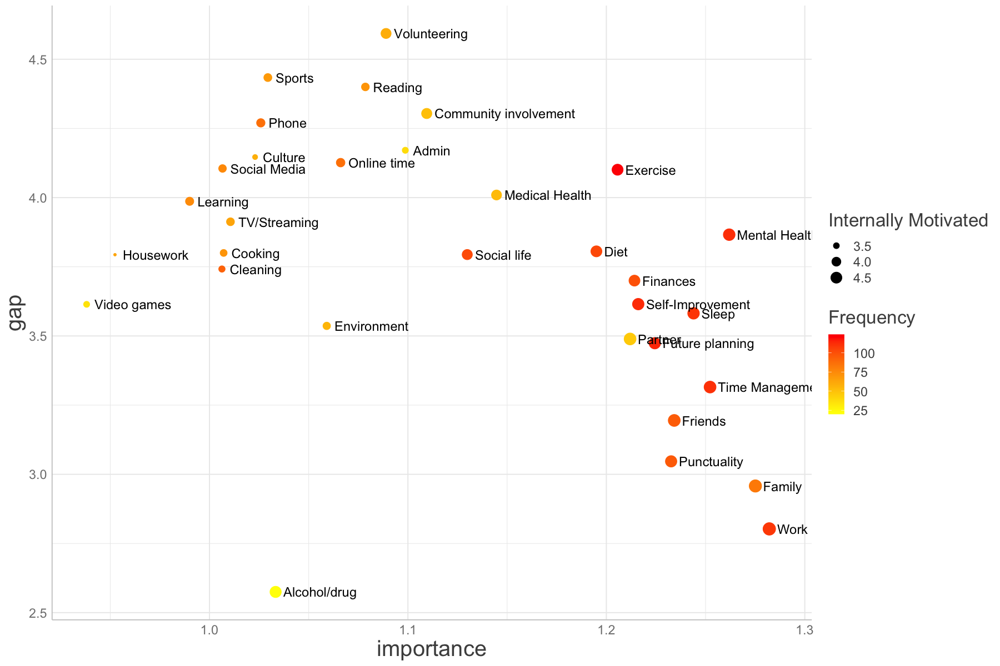

In [155]:
options(repr.plot.width = 15, repr.plot.height = 10)

p <- ggplot(domain_freq, aes(importance, gap, label = domain_names_short))
p + geom_point(aes(colour = count, size = internal)) + 
geom_text(hjust = 0, nudge_x = 0.004, size=5) +
labs(color = "Frequency",
     size = "Internally Motivated"
    ) +
scale_colour_gradient(low = "yellow", high = "red", na.value = NA) +
theme_sjplot() +
theme(
    legend.text = element_text(size = 14),
    legend.title = element_text(size = 20),
    axis.title = element_text(size = 24),
    axis.text = element_text(size = 14)
  )


## Eisenhower Matrix

We asked subjects to estimate the amount of time they spend in each of the four quadrants defiend by the [Eisenhower Matrix](https://jamesclear.com/eisenhower-box).

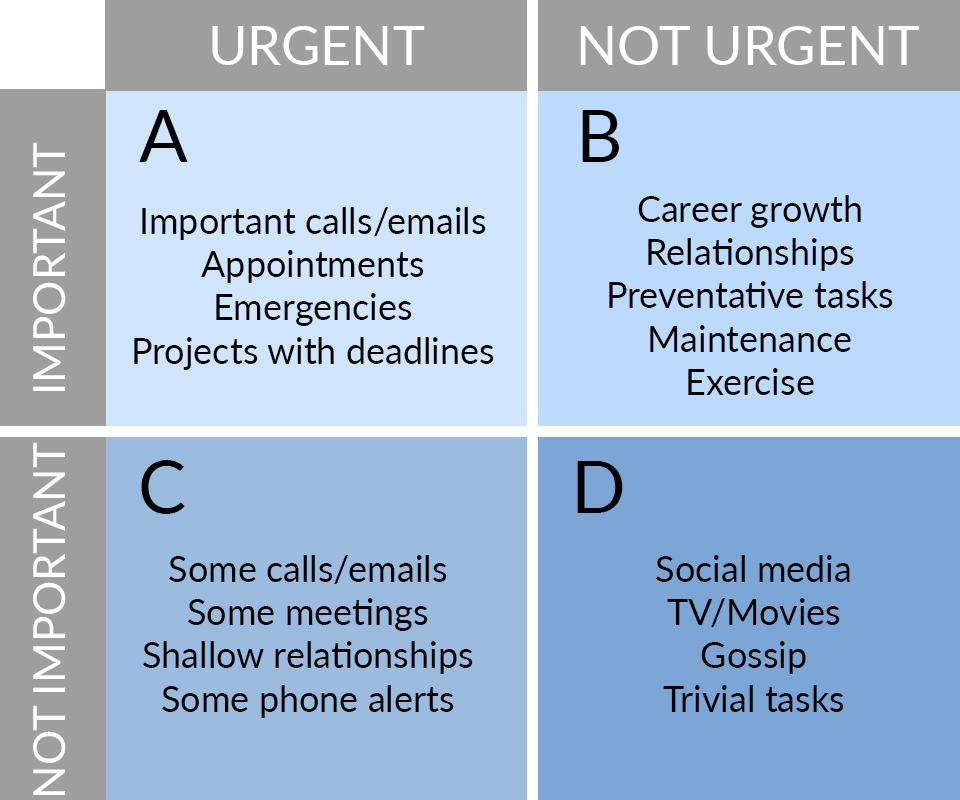

> "What is important is seldom urgent and what is urgent is seldom important."
> 
> -*Dwight Eisenhower, 34th President of the United States*


Note: Using an external vector in selections is ambiguous.
ℹ Use `all_of(dummyvar)` instead of `dummyvar` to silence this message.
ℹ See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.
This message is displayed once per session.



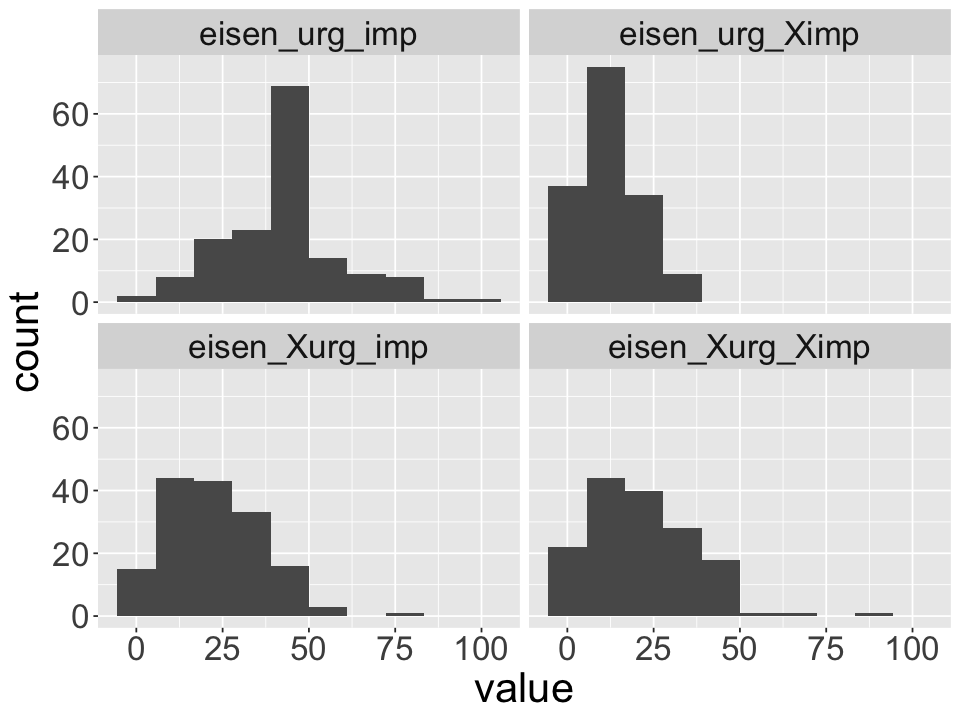

In [28]:
# plot distributions
var_to_plot = c("eisen_urg_imp","eisen_Xurg_imp","eisen_urg_Ximp","eisen_Xurg_Ximp")
dummyvar = "subjectID"

ggplot(pivot_longer(eisen_quad[,c(var_to_plot,dummyvar)],-dummyvar),
    aes(x=value)) +
    geom_histogram(bins=10) +
    facet_wrap(~name) + 
    theme(text = element_text(size = 25)) 

## Planning Characteristics

In [151]:
planning = as.data.frame(qn_df) %>%
  select(subjectID, plan_detailed_1, plan_variation_1,
         plan_goalnum_1, plan_goal_select_1,
         plan_goal_focus_1, plan_contingencies_1
        ) %>%
  lapply(as.numeric) %>%
  data.frame()

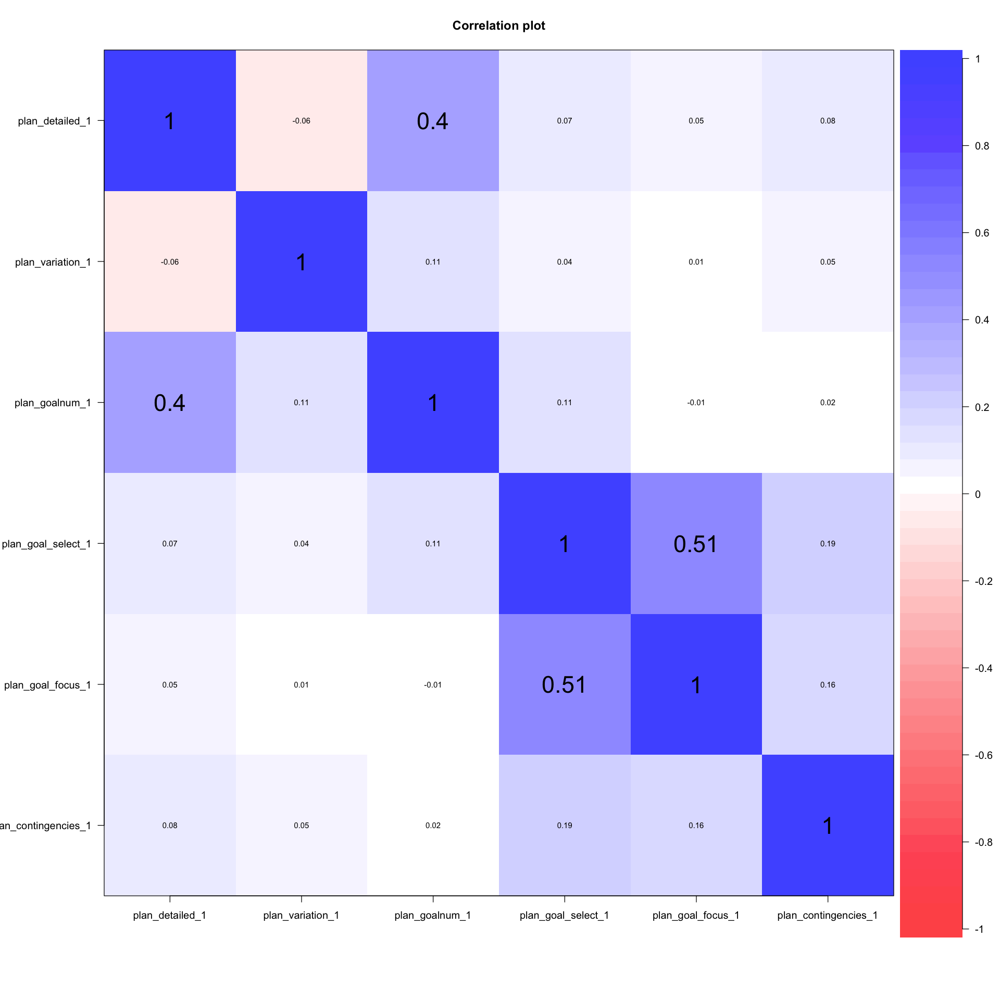

In [152]:
options(repr.plot.width = 16, repr.plot.height = 16)

cor.plot(planning[,2:dim(planning)[2]], cex = 1.5)

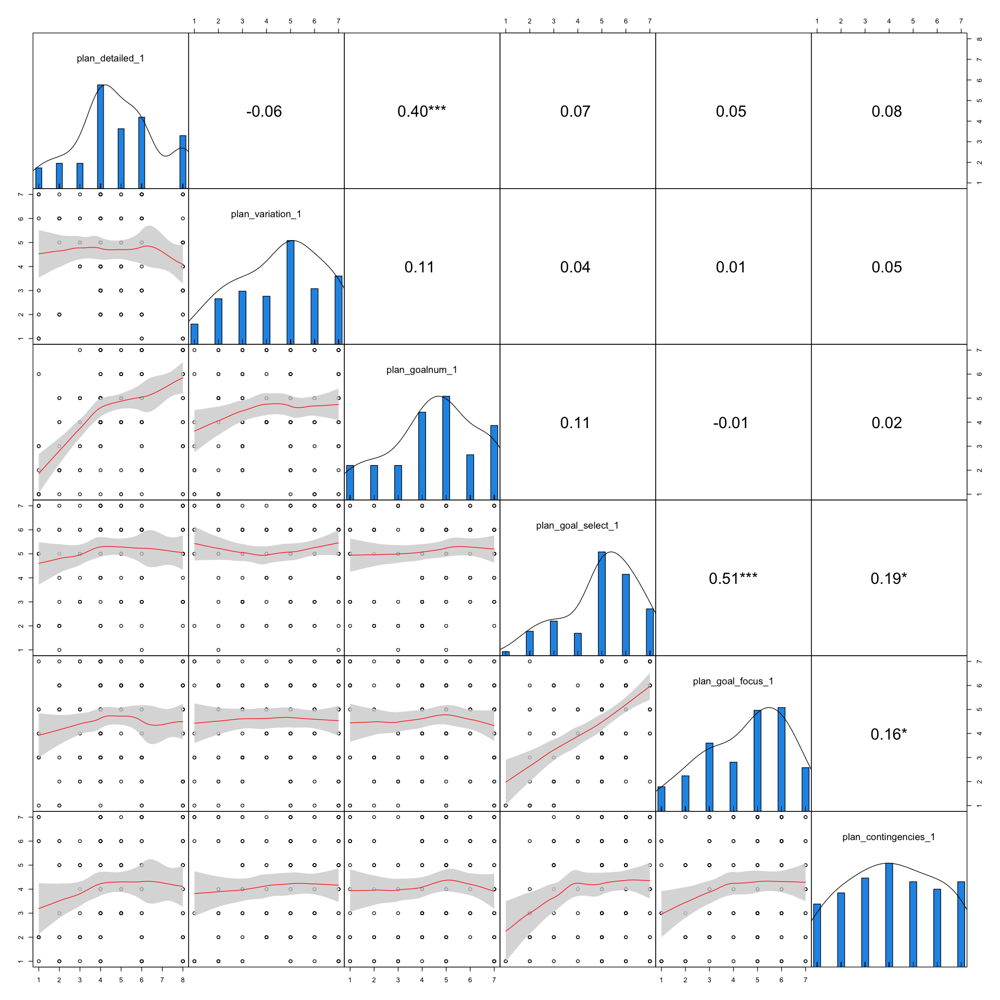

In [153]:
pairs.panels(planning[,2:dim(planning)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

## Goal Characteristics

In [154]:
goal_char = as.data.frame(qn_df) %>%
  select(subjectID, contains('goals_')
        ) %>%
  lapply(as.numeric) %>%
  data.frame()

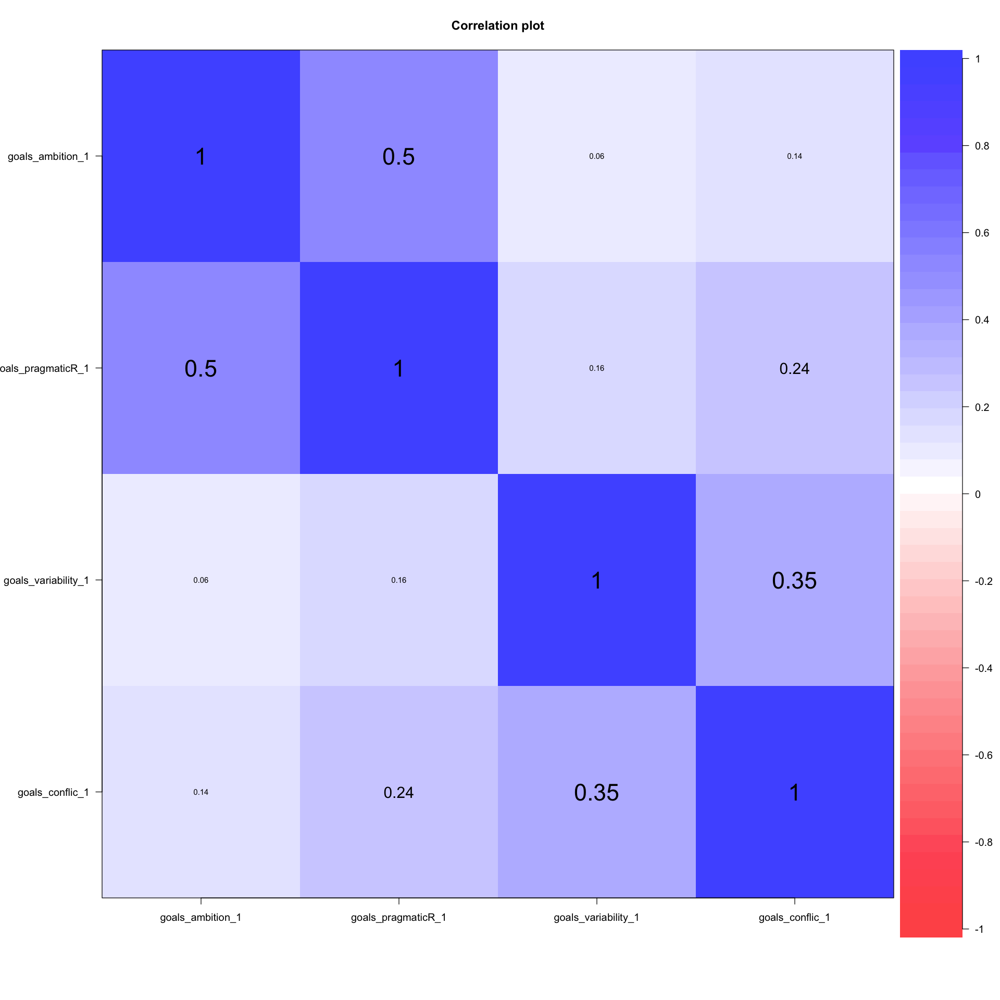

In [155]:
cor.plot(goal_char[,2:dim(goal_char)[2]], cex = 1.5)

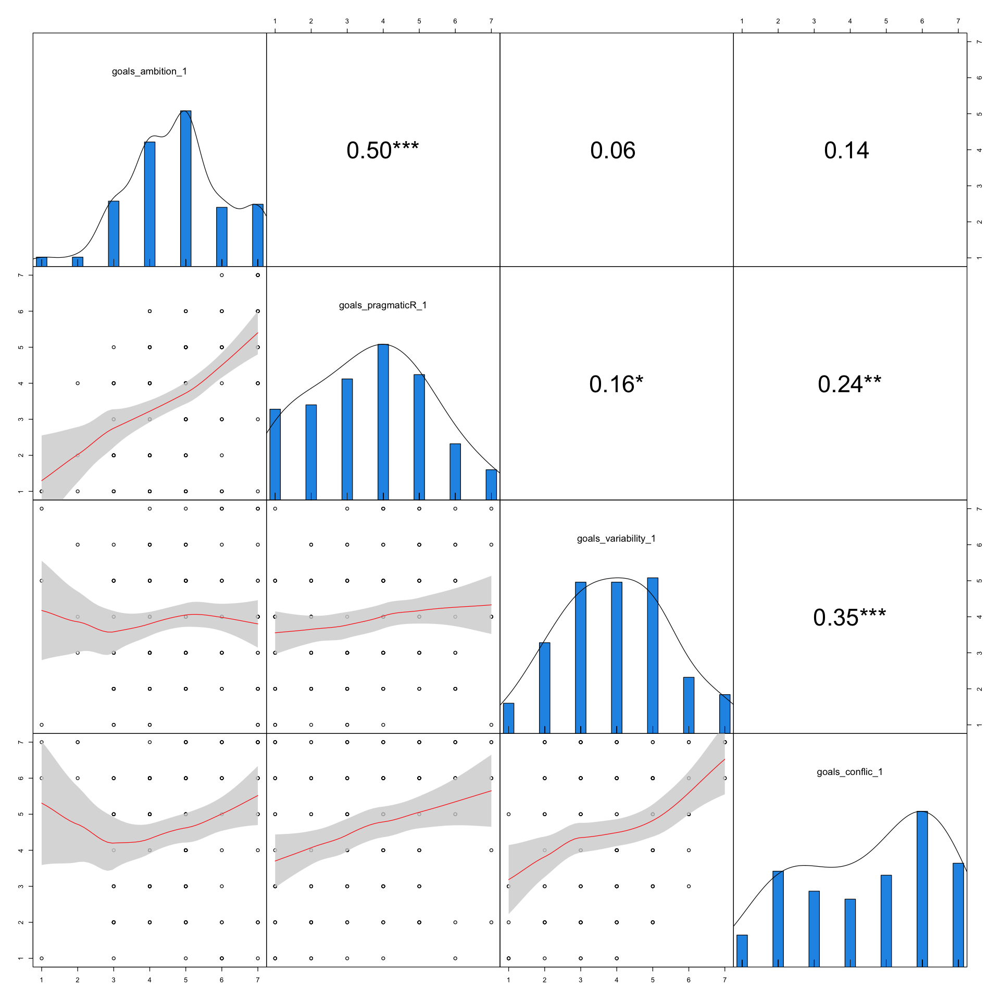

In [156]:
pairs.panels(goal_char[,2:dim(goal_char)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

## Gap Feelings

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,289,3.252595,1.424684,3,3.214592,1.4826,1,7,6,0.2194203,-0.4292609,0.08380493


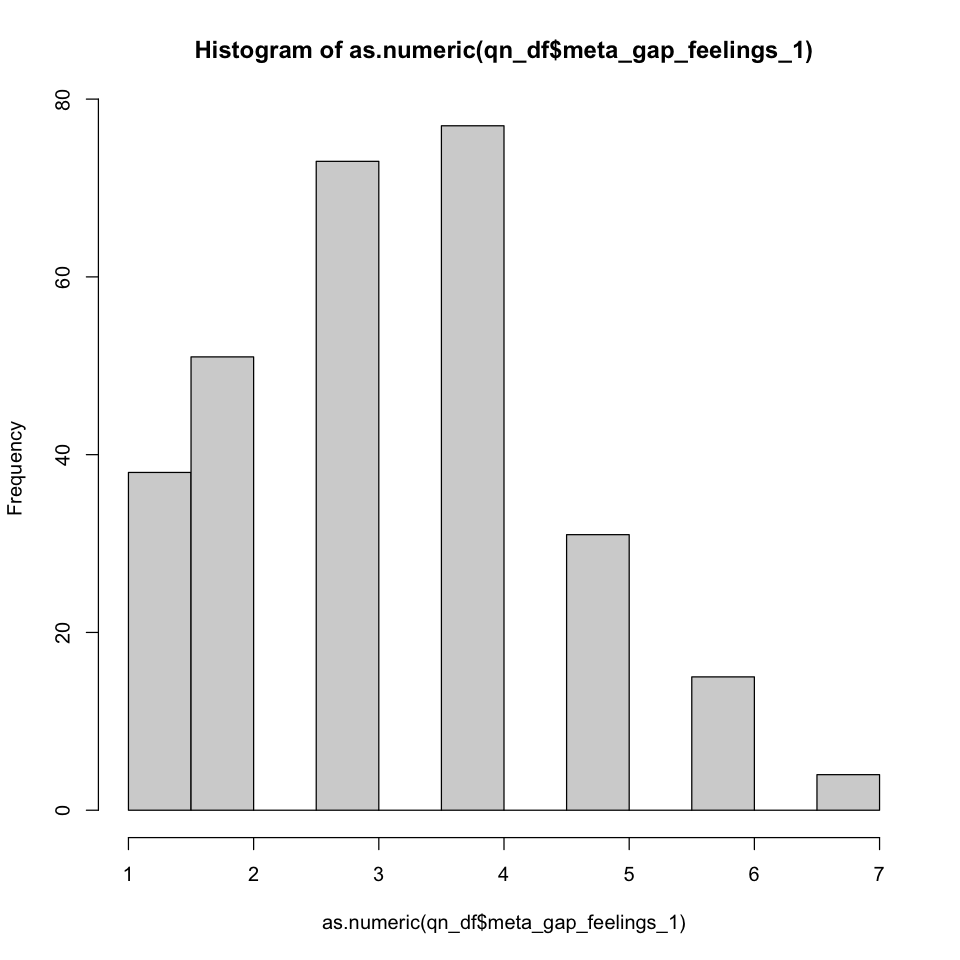

In [116]:
options(repr.plot.width = 8, repr.plot.height = 8)

hist(as.numeric(qn_df$meta_gap_feelings_1))
describe(as.numeric(qn_df$meta_gap_feelings_1))

## Accuracy

We asked subjects:

>How accurately do you feel like the questions you were asked captured your own intuition about your intention-behavior gap (the difference between what you intend to do and what you actually do)?

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,289,5.034602,1.178001,5,5.085837,1.4826,1,7,6,-0.4984859,0.3165419,0.0692942


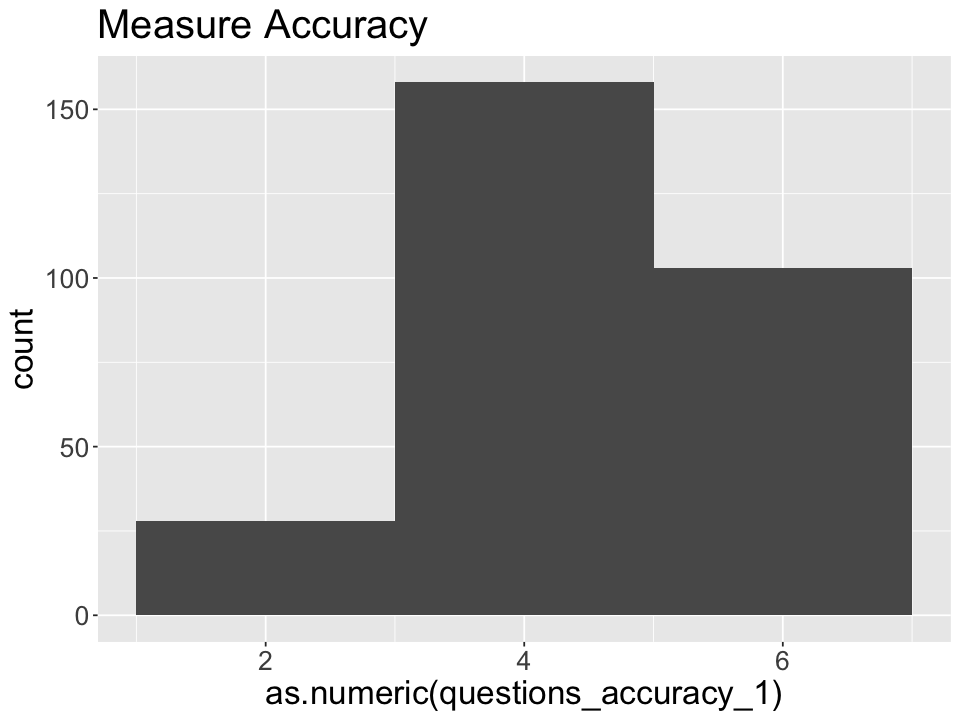

In [9]:
ggplot(qn_df, aes(as.numeric(questions_accuracy_1))) + 
    geom_histogram(bins = 4) +
    labs(title = "Measure Accuracy") +
    theme(text = element_text(size=20))

describe(as.numeric(qn_df$questions_accuracy_1))

## Suggestions

In [38]:
print(q_df$questions_suggestion)

  [1] NA                                                                                                                                                                                                                                                                                                                                                                                                                  
  [2] "N/A"                                                                                                                                                                                                                                                                                                                                                                                                               
  [3] NA                                                                                                                                                                          

## Value-Behavior

### Value Behavior Gap Overall

,vars,n,mean,sd,median,trimmed,mad,min,max,range,skew,kurtosis,se
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
X1,1,155,38.63871,19.62138,39,37.688,22.239,0,90,90,0.415461,-0.3911771,1.576027


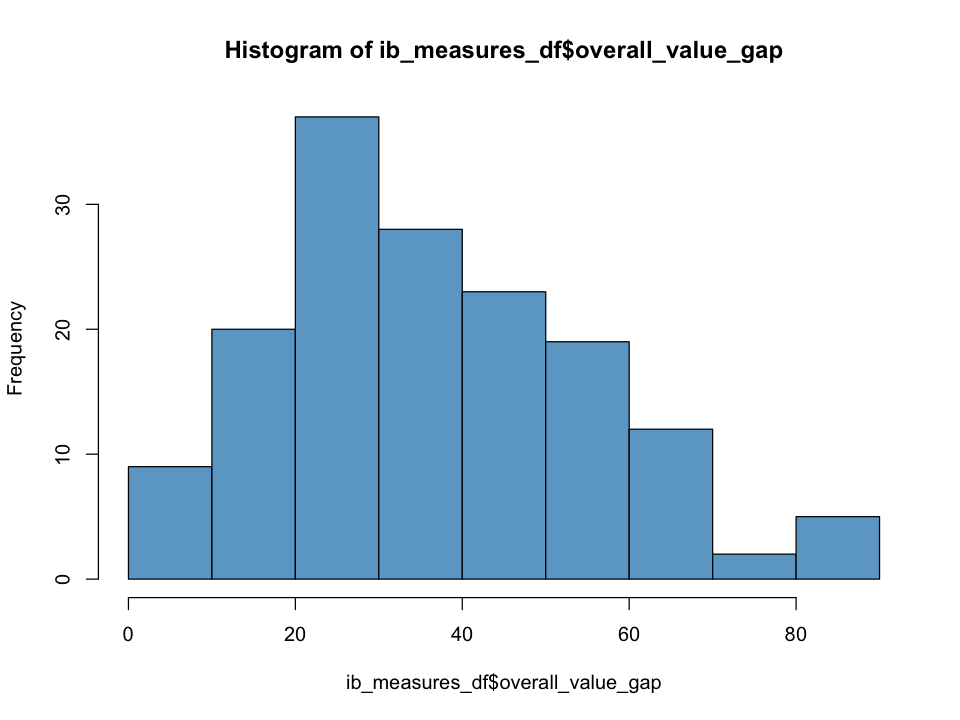

In [40]:
options(repr.plot.width = 8, repr.plot.height = 6)

# plot
hist(ib_measures_df$overall_value_gap, col = 'skyblue3')
describe(ib_measures_df$overall_value_gap)

## Validation

Measure were selected for validation that we thought should correlate with the intention behavior gap measure.

### Ambition

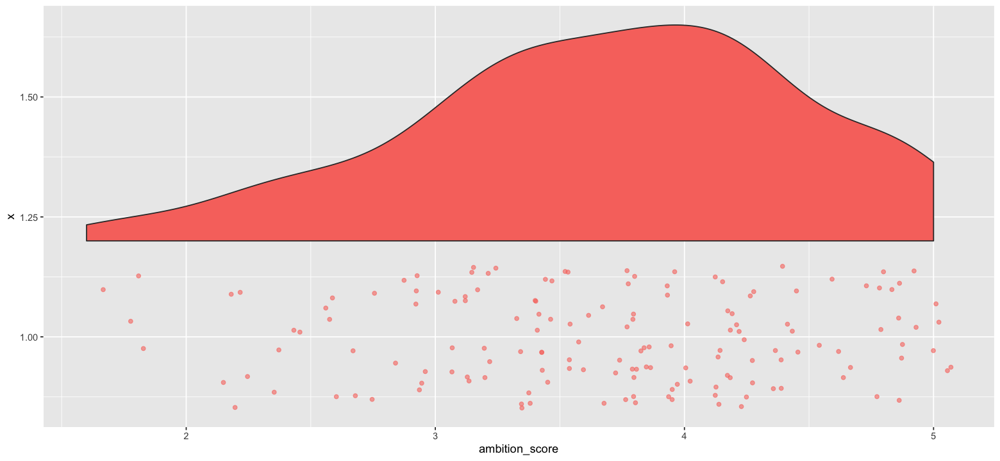

In [41]:
# set plot size
options(repr.plot.width = 13, repr.plot.height = 6)
# plot
ggplot(validation_measures, aes(x = 1, y=ambition_score, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

### Brief Self Control

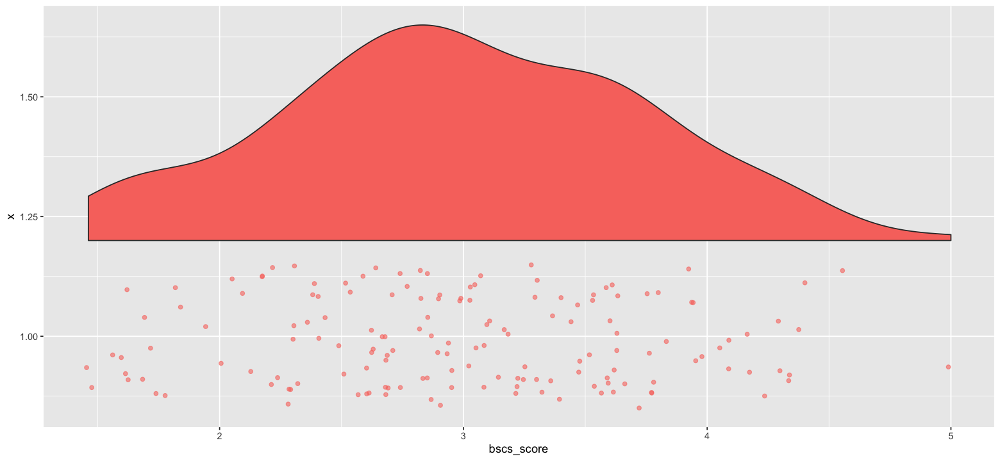

In [42]:
ggplot(validation_measures, aes(x = 1, y=bscs_score, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

### Future Time Perspective

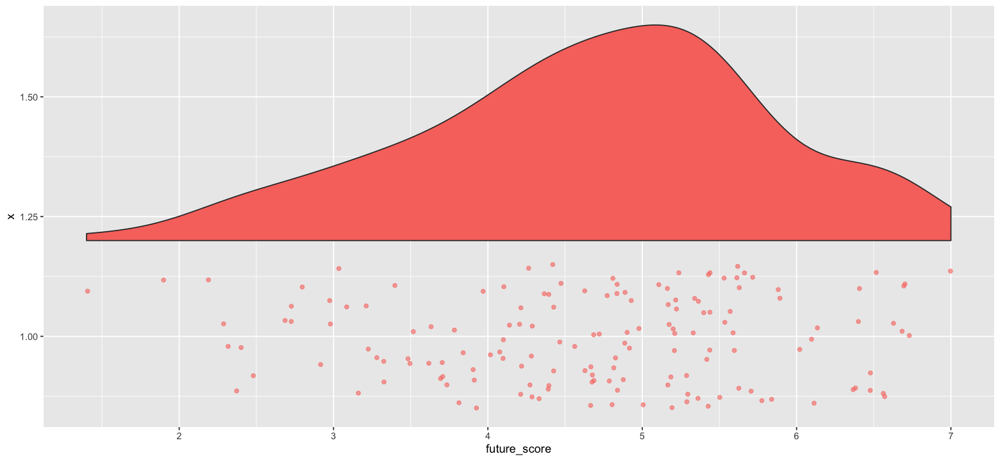

In [43]:
ggplot(validation_measures, aes(x = 1, y=future_score, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

### Secular Work Ethic

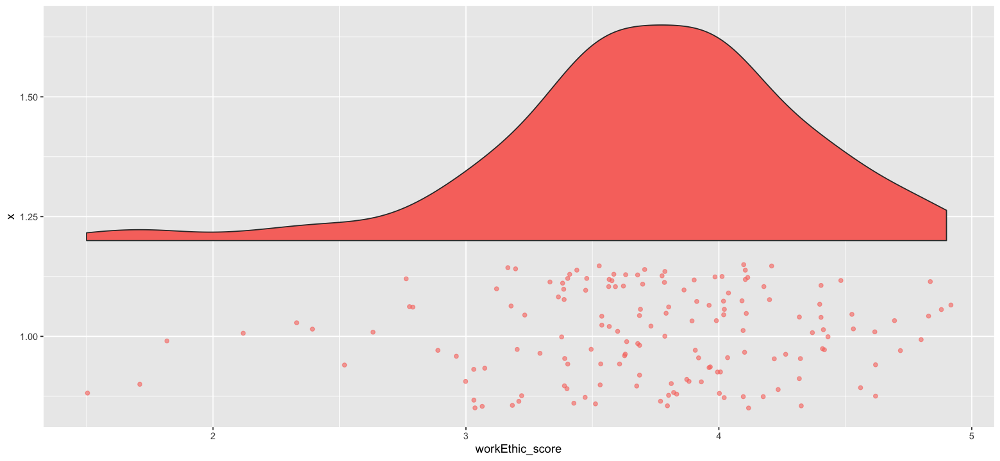

In [44]:
ggplot(validation_measures, aes(x = 1, y=workEthic_score, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

### Short Grit

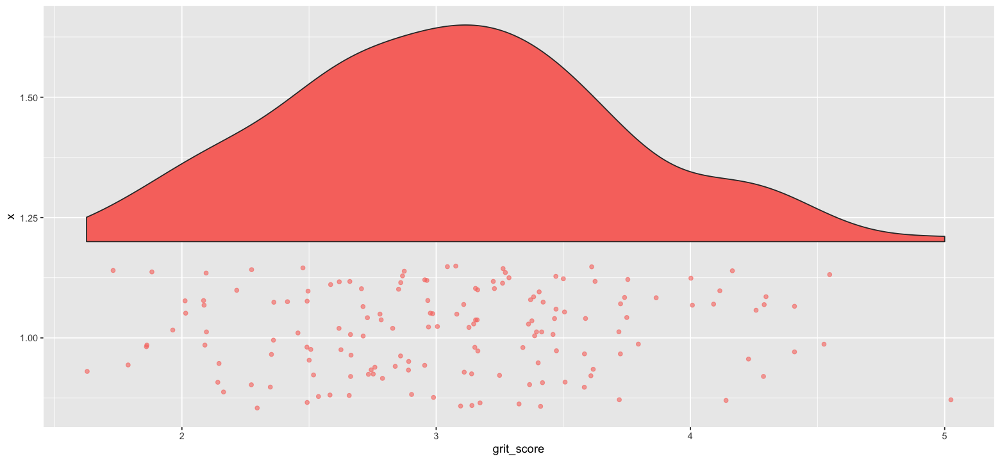

In [45]:
ggplot(validation_measures, aes(x = 1, y=grit_score, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

### Personality Inventory (10)

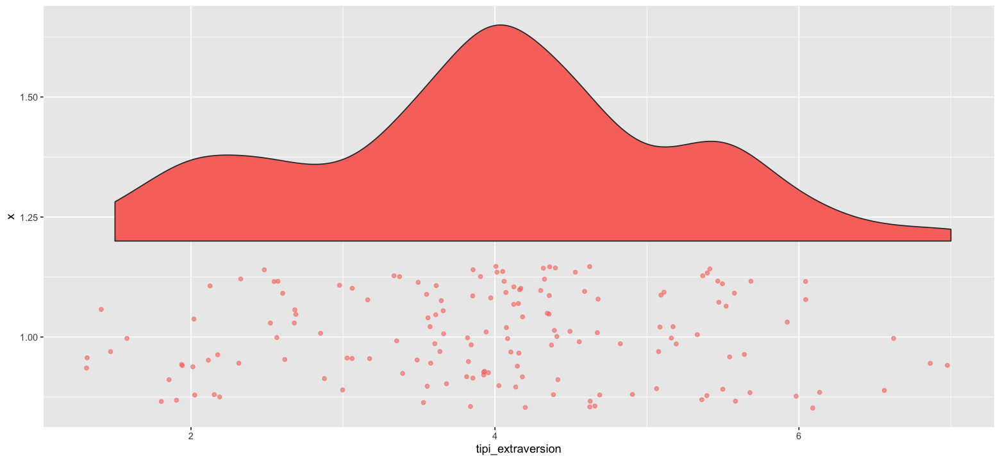

In [46]:
# just looking at extraversion
ggplot(validation_measures, aes(x = 1, y=tipi_extraversion, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

### Boredom Prone

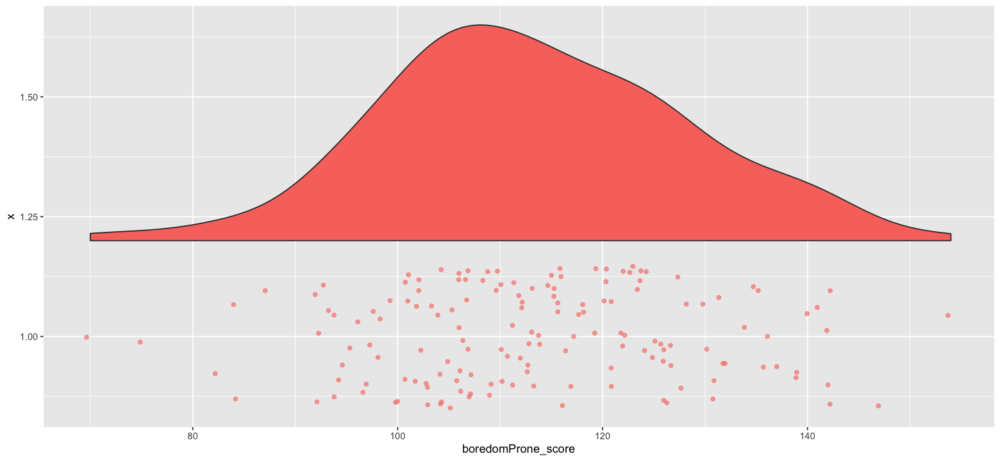

In [47]:
ggplot(validation_measures, aes(x = 1, y=boredomProne_score, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

### Conscientiousness

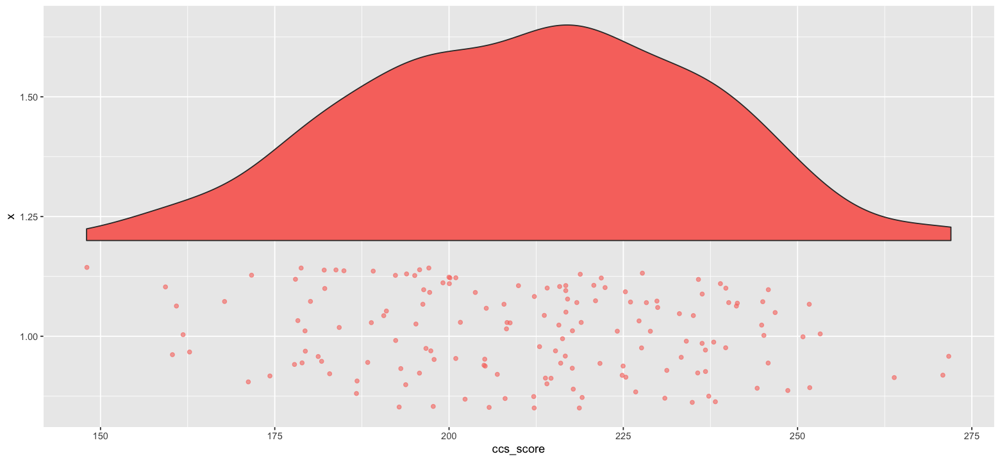

In [49]:
ggplot(validation_measures, aes(x = 1, y=ccs_score, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

### Need for Cognition

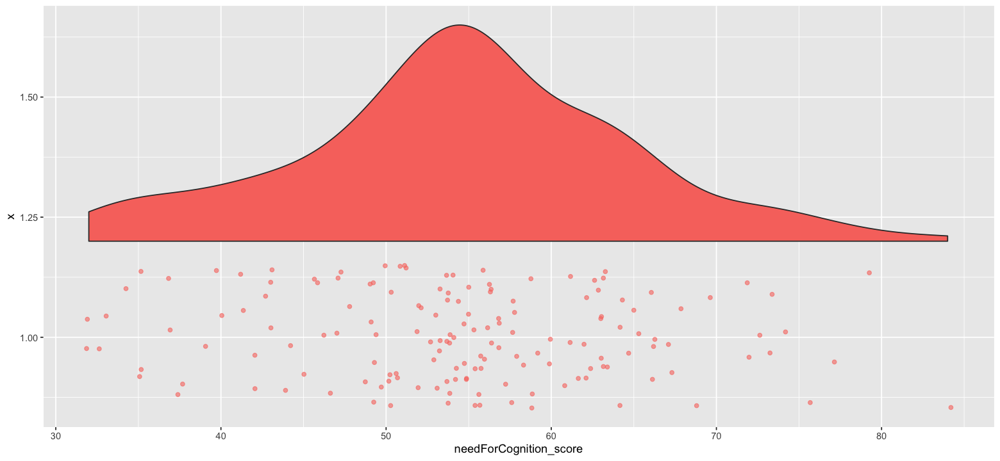

In [50]:
ggplot(validation_measures, aes(x = 1, y=needForCognition_score, fill='red')) +
  geom_flat_violin(position = position_nudge(x = .2, y = 0)) +
  coord_flip()+
  geom_jitter(aes(color = 'red'), width=0.15, alpha = 0.6)+
  theme(legend.position="none")

# Correlations

## Gap Measures

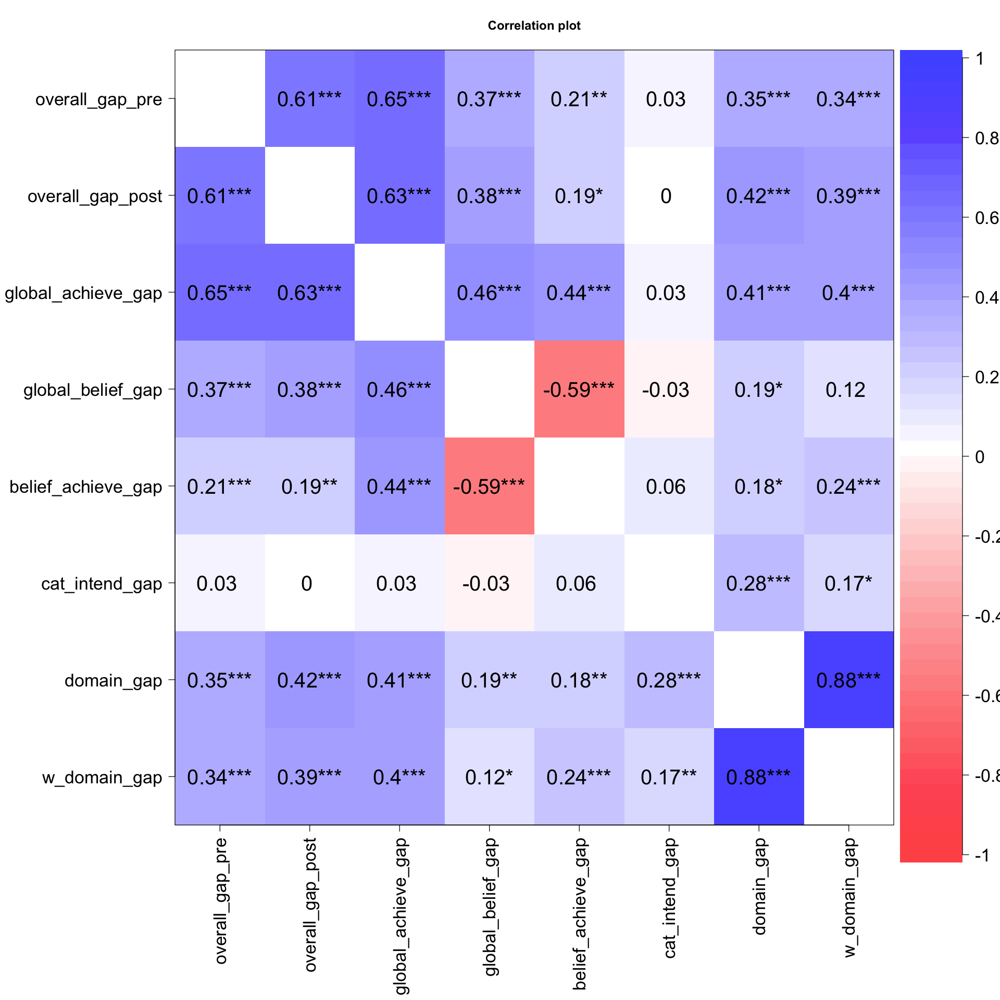

In [10]:
# set plot size
options(repr.plot.width = 16, repr.plot.height = 16)

cor.plot(ib_measures_df[,2:dim(ib_measures_df)[2]], cex = 2, xlas = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

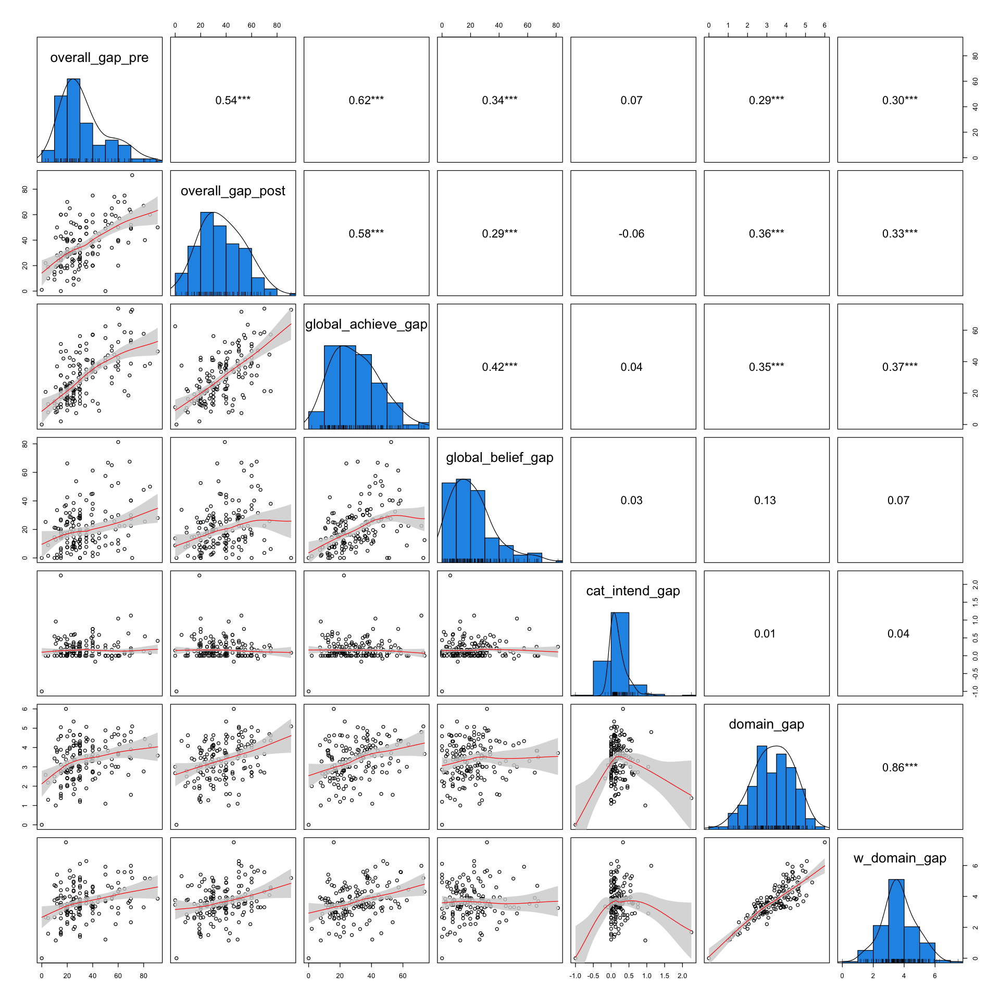

In [519]:
pairs.panels(ib_measures_df[,2:dim(ib_measures_df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=2)          # If TRUE, adds confidence intervals

## Validation Measures

In [11]:
options(repr.plot.width = 16, repr.plot.height = 16)

In [ ]:
cor.plot(validation_measures[,2:dim(validation_measures)[2]], cex = 1, xlas=2)

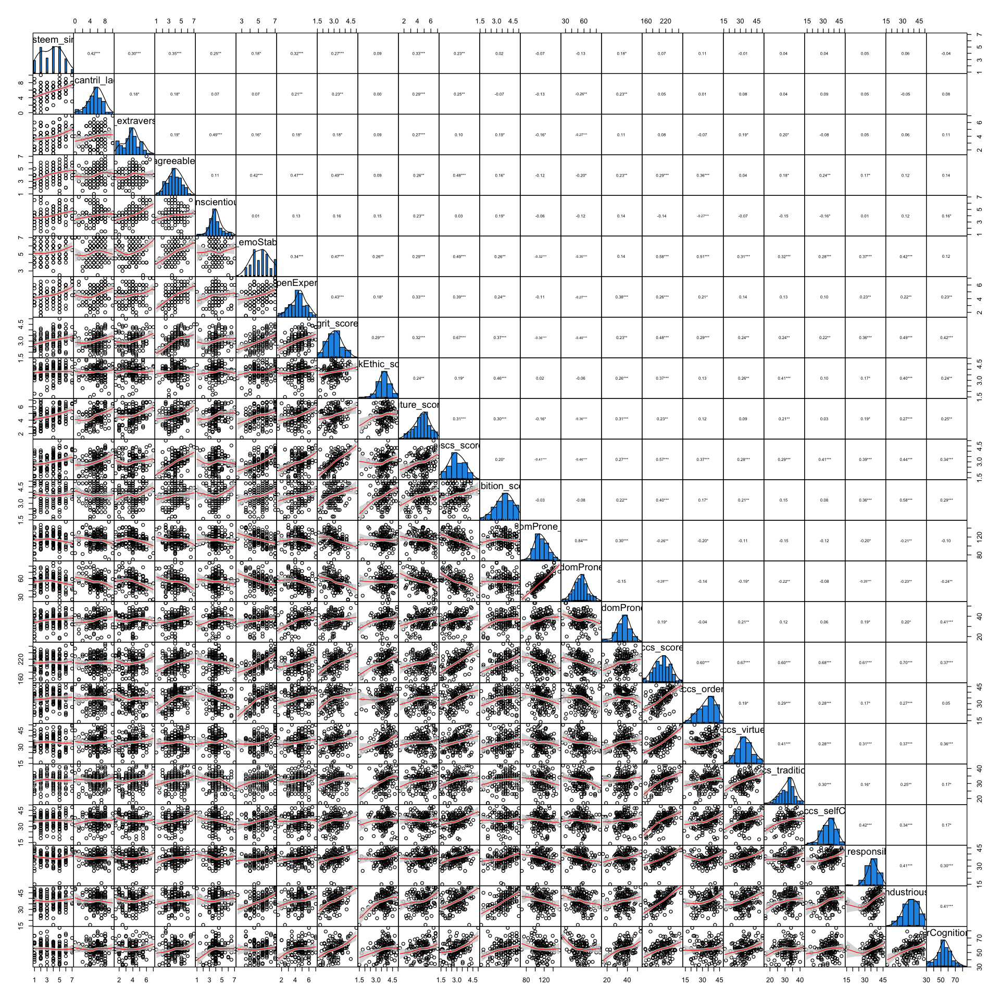

In [194]:
pairs.panels(validation_measures[,2:dim(validation_measures)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

## IB Gap + Validation

### Gap + Ambition

In [572]:
df = merge(x=ib_measures_df, y=dplyr::select(validation_measures, subjectID, ambition_score),
           by="subjectID", all.x=TRUE)

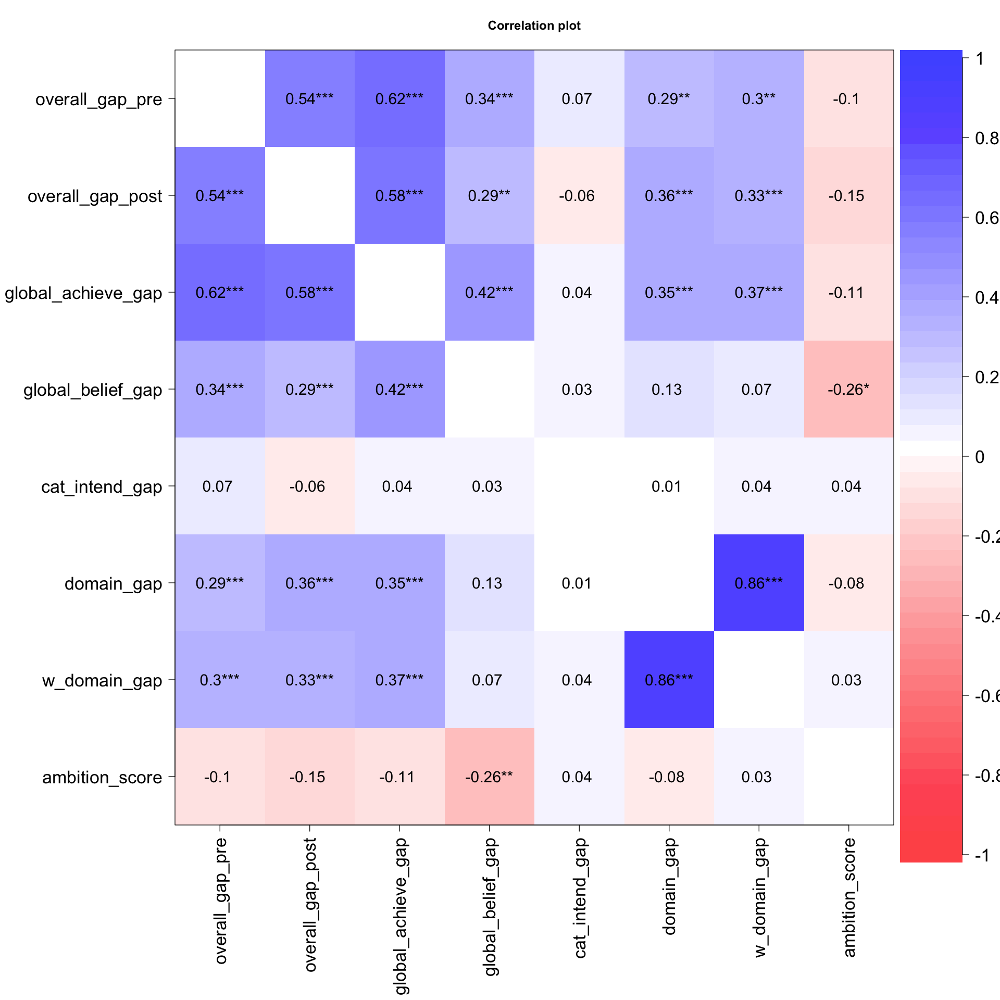

In [573]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

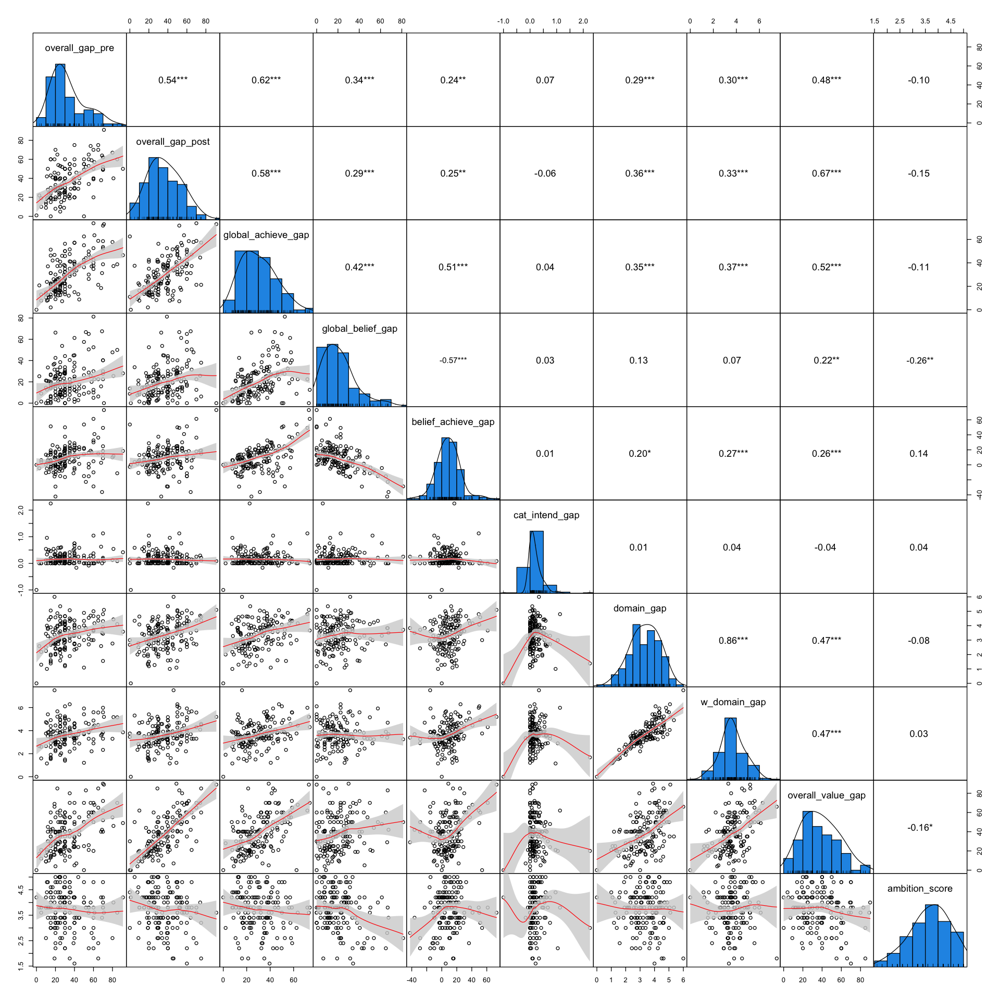

In [163]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Gap + Brief Self Control

In [575]:
df = merge(x=ib_measures_df, y=dplyr::select(validation_measures, subjectID, bscs_score),
           by="subjectID", all.x=TRUE)

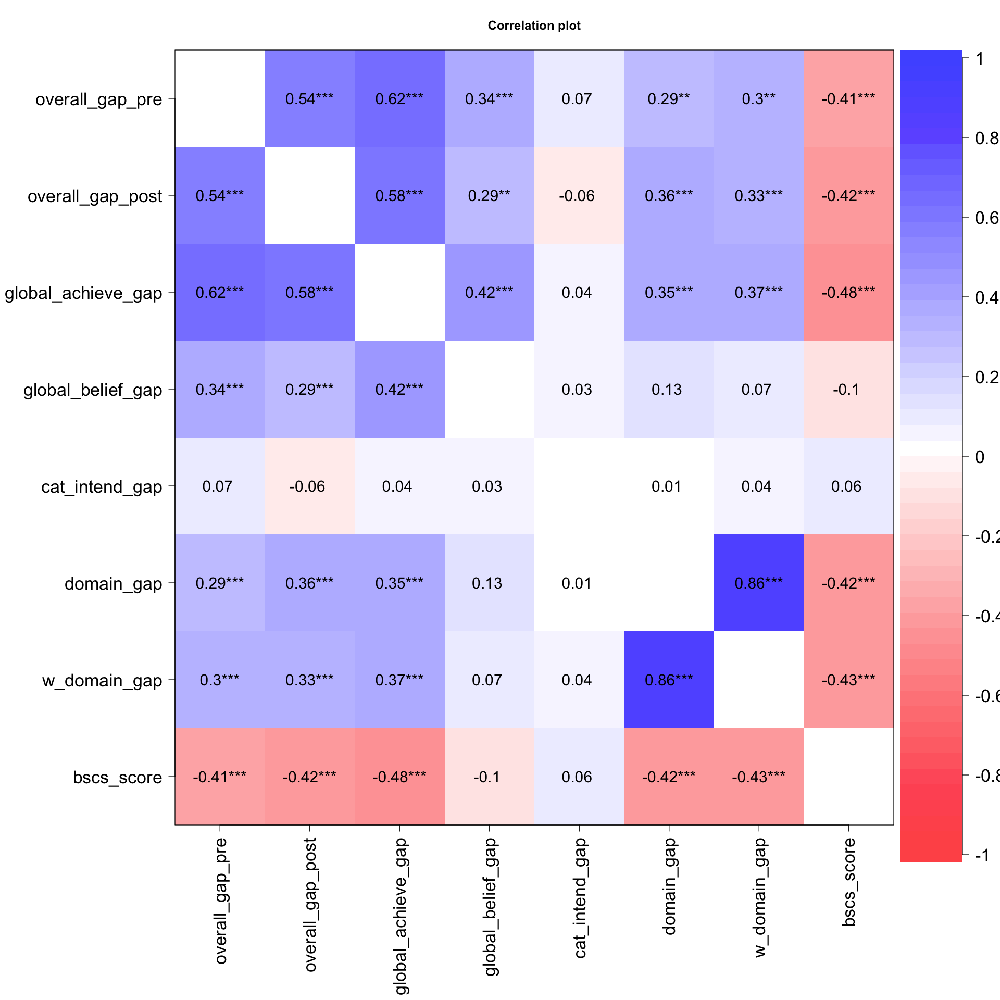

In [576]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

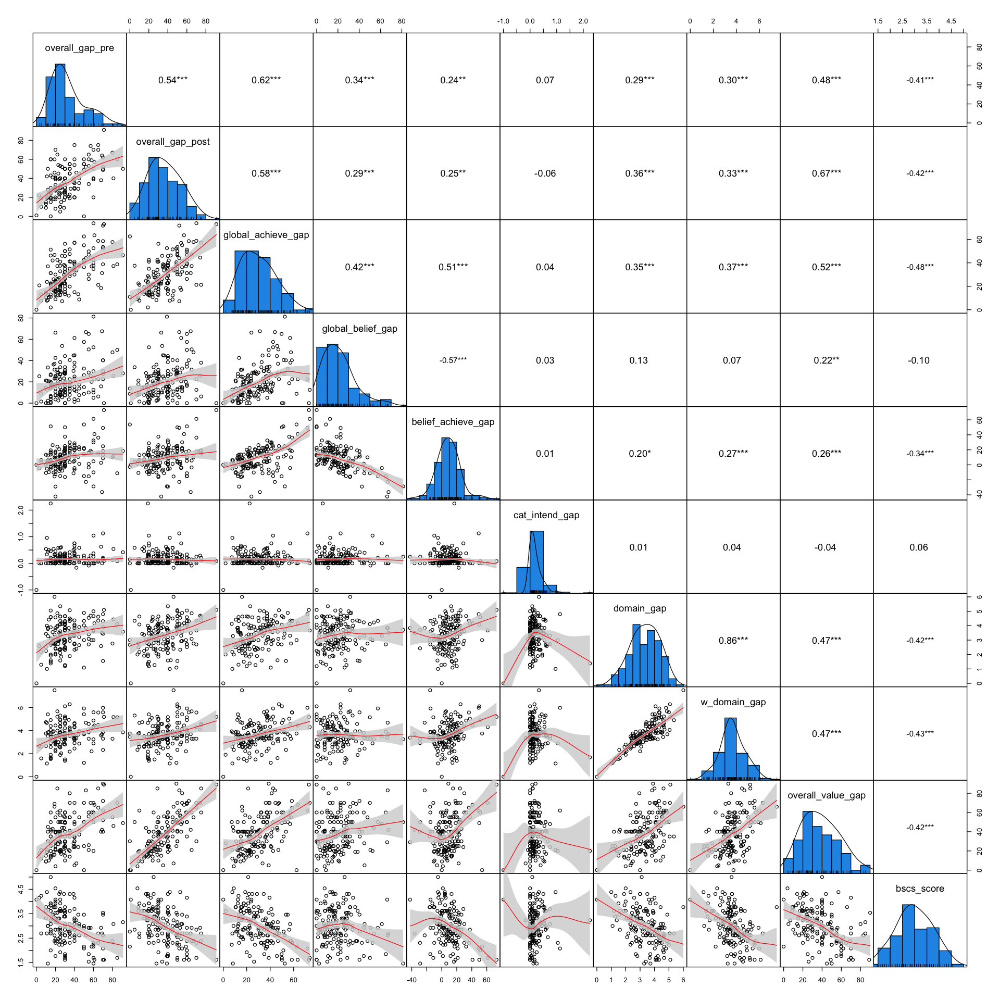

In [166]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Gap + Future Time Perspective

In [577]:
df = merge(x=ib_measures_df, y=dplyr::select(validation_measures, c(subjectID, future_score)),
           by="subjectID", all.x=TRUE)

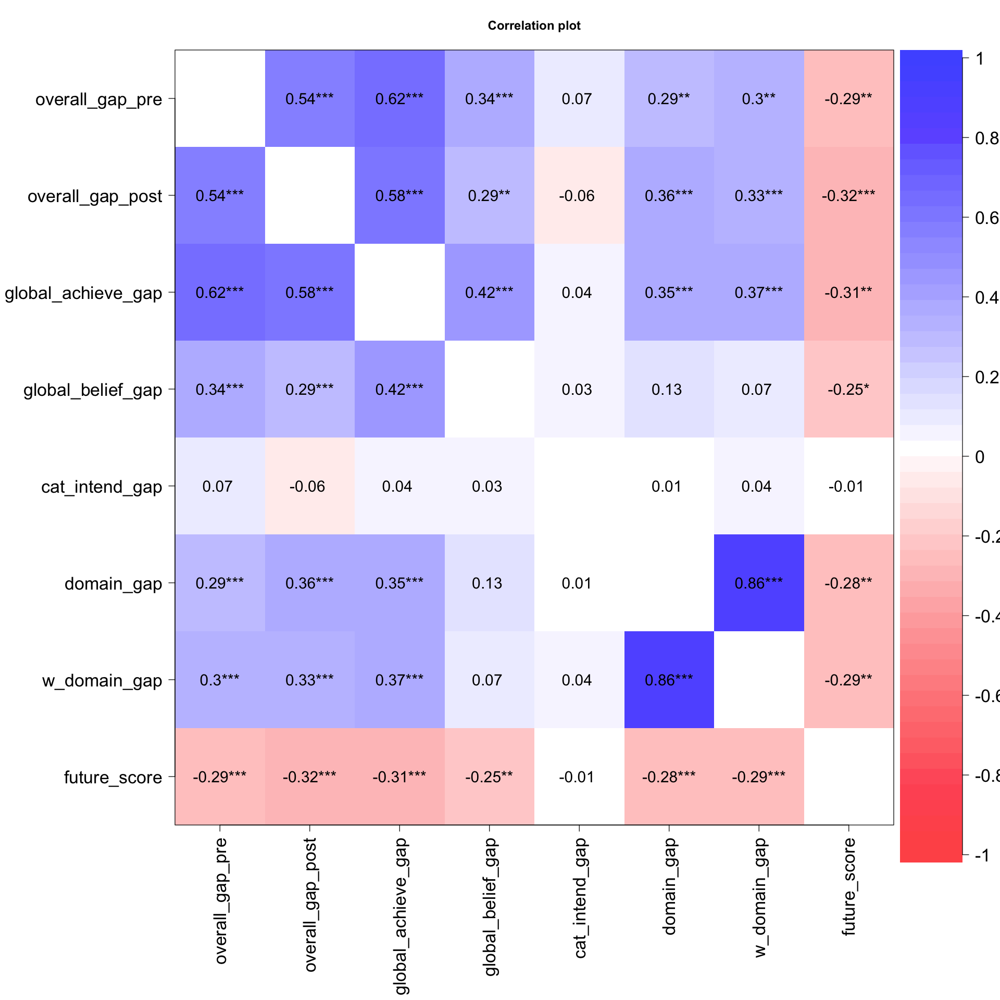

In [578]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas=2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

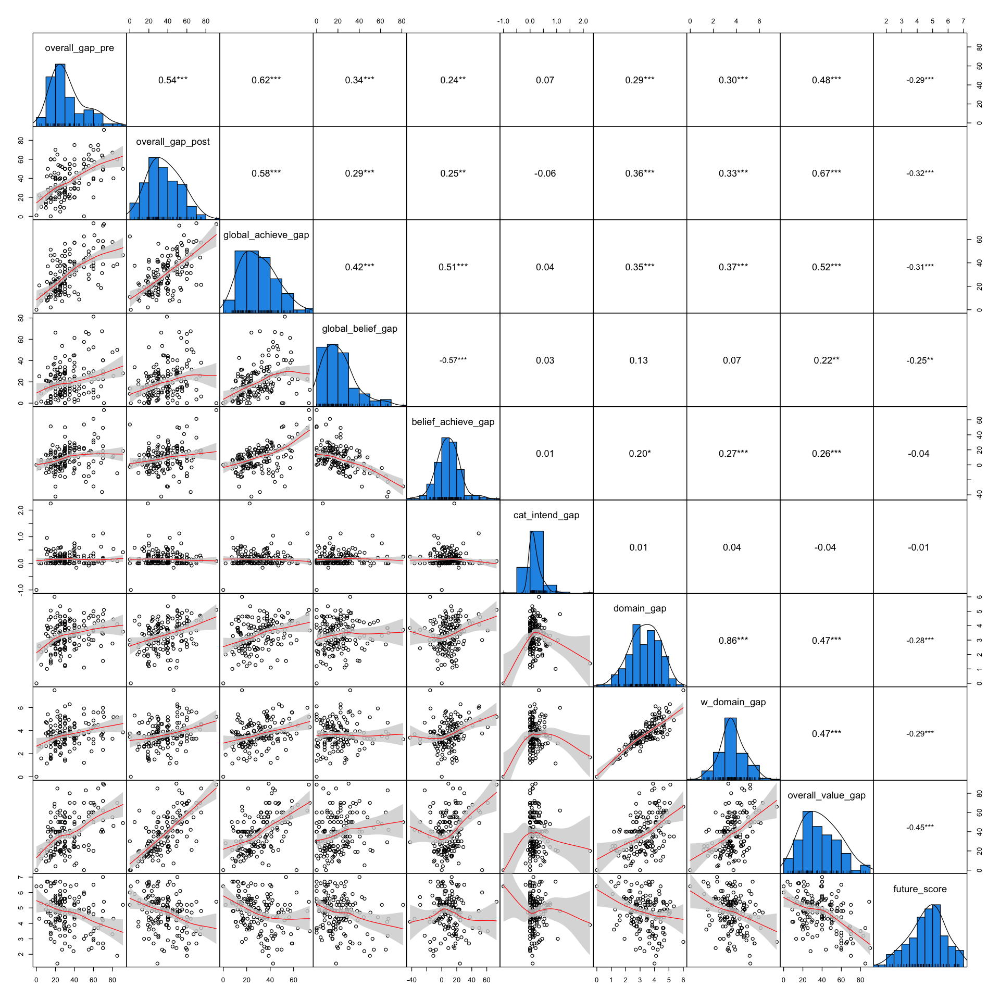

In [169]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Gap + Secular Work Ethic

In [579]:
df = merge(x=ib_measures_df, y=dplyr::select(validation_measures, c(subjectID, workEthic_score)) ,
           by="subjectID", all.x=TRUE)

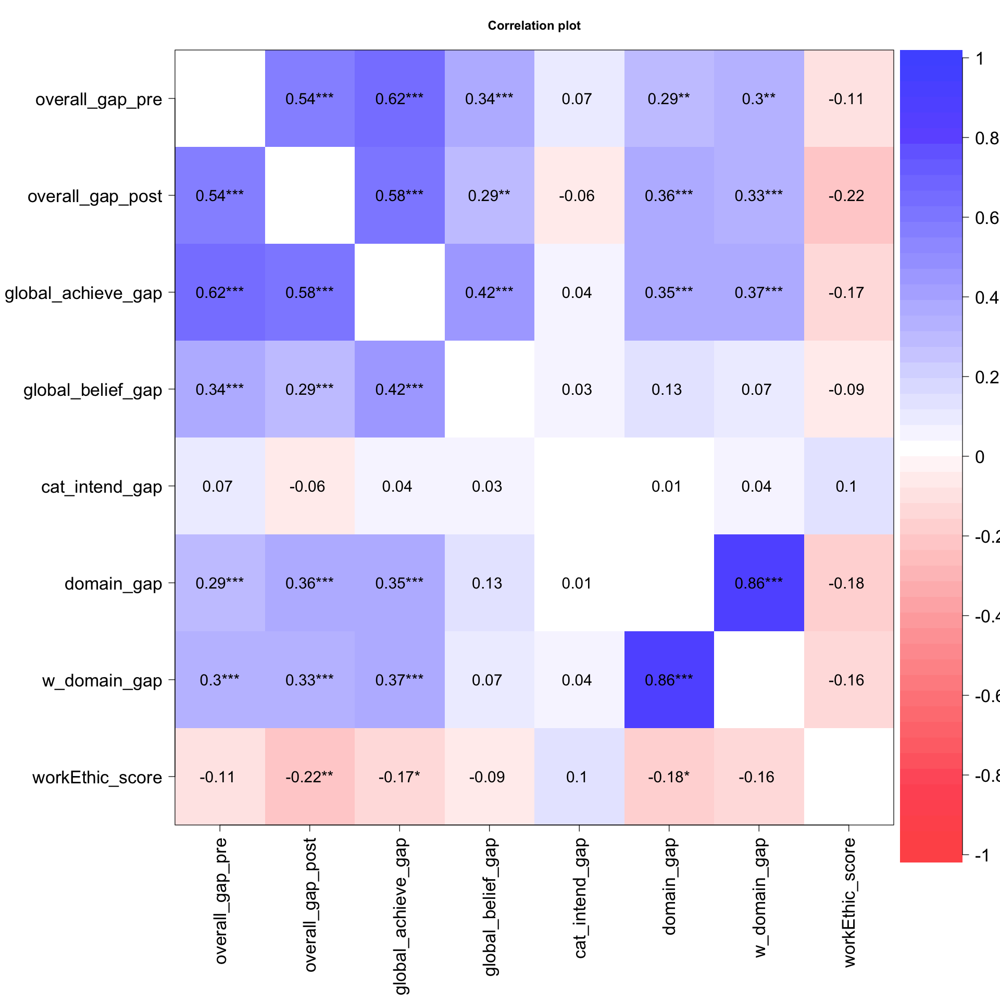

In [580]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

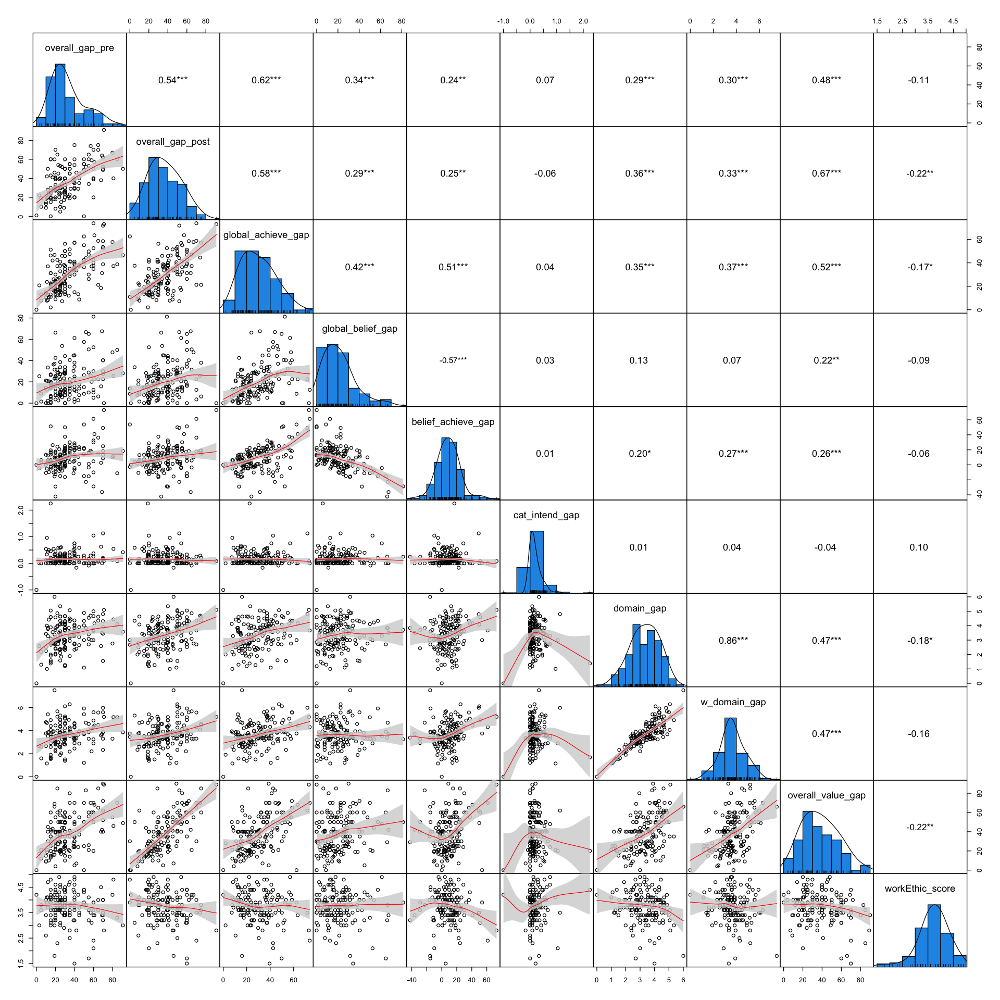

In [172]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

Interesting that work ethic negatively correlated with domain gap but not other measures?

### Gap + Short Grit

In [581]:
df = merge(x=ib_measures_df, y=dplyr::select(validation_measures, c(subjectID, grit_score)) ,
           by="subjectID", all.x=TRUE)

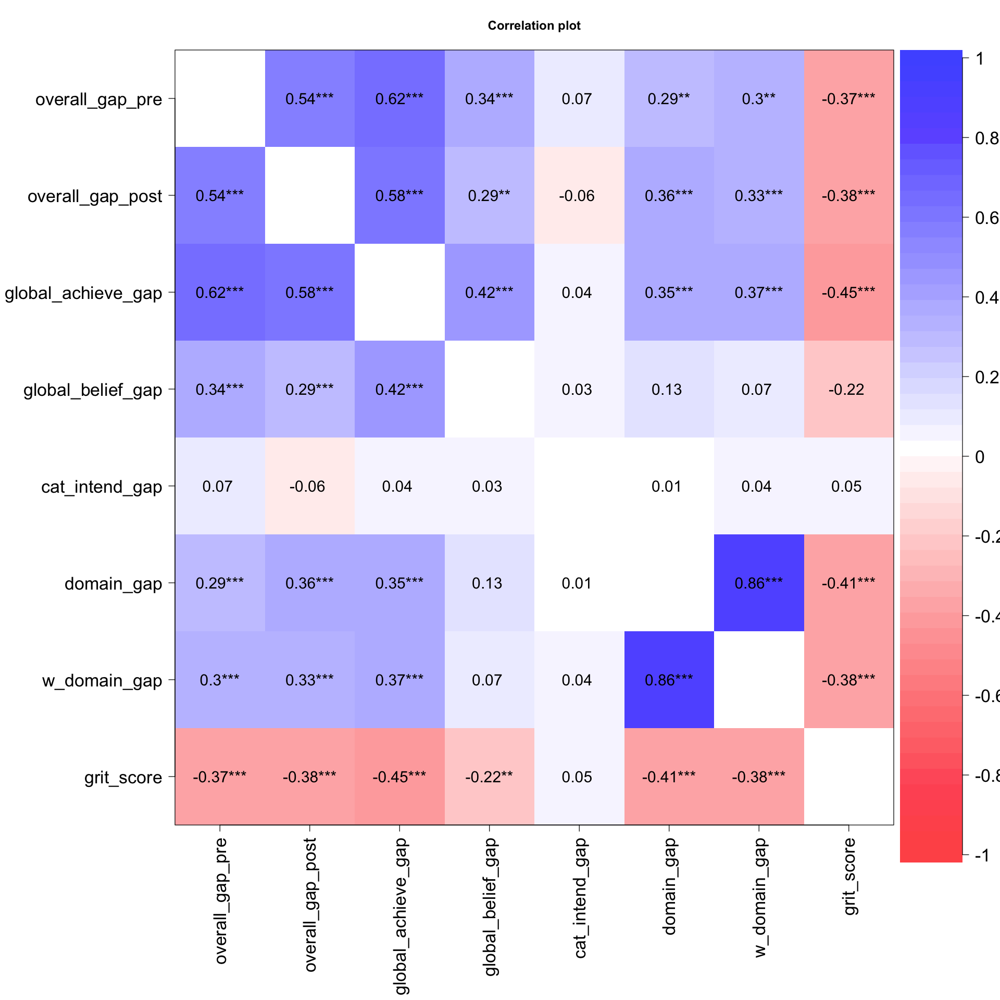

In [582]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas=2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

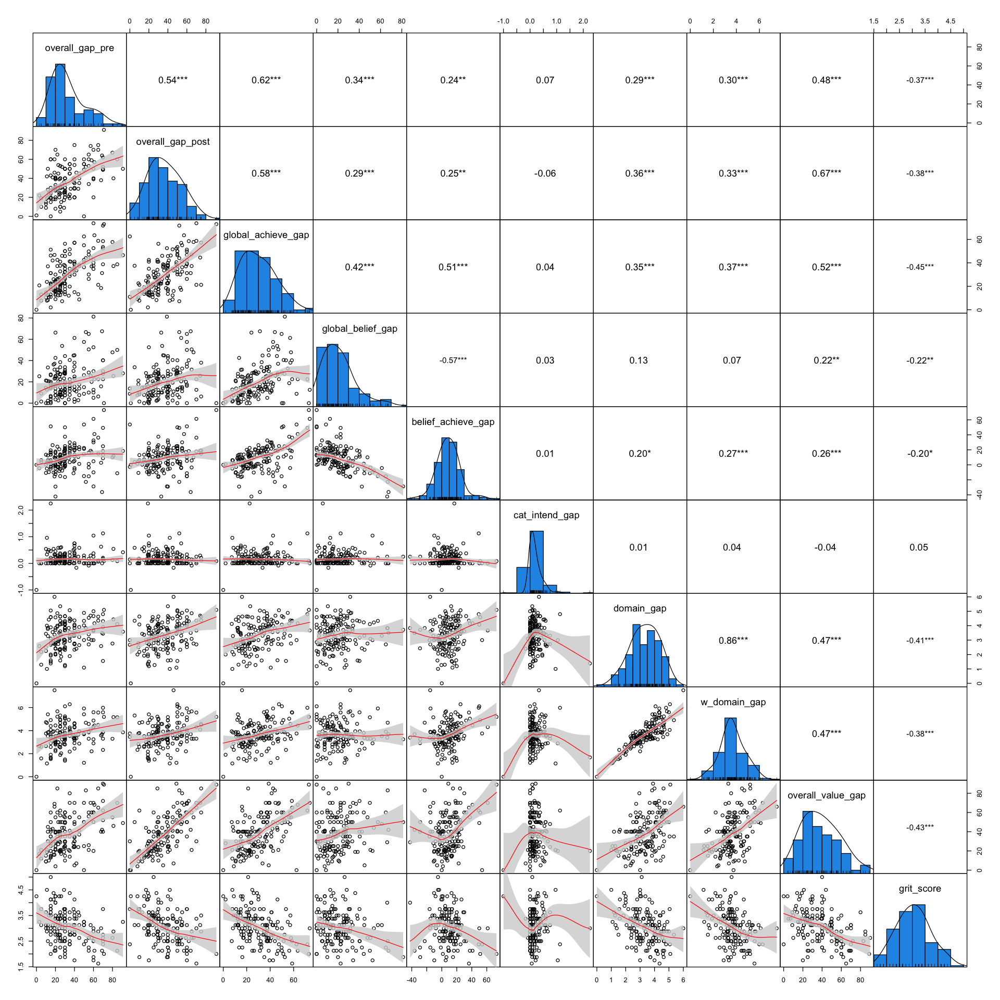

In [175]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Gap + Personality Inventory

In [176]:
df = merge(x=ib_measures_df, y=select(validation_measures, c(subjectID, starts_with('tipi'))) ,
           by="subjectID", all.x=TRUE)

In [177]:
names(as_tibble(select(validation_measures, starts_with('tipi'))))

[1] "tipi_extraversion"      "tipi_agreeableness"     "tipi_conscientiousness"
[4] "tipi_emoStability"      "tipi_openExperience"

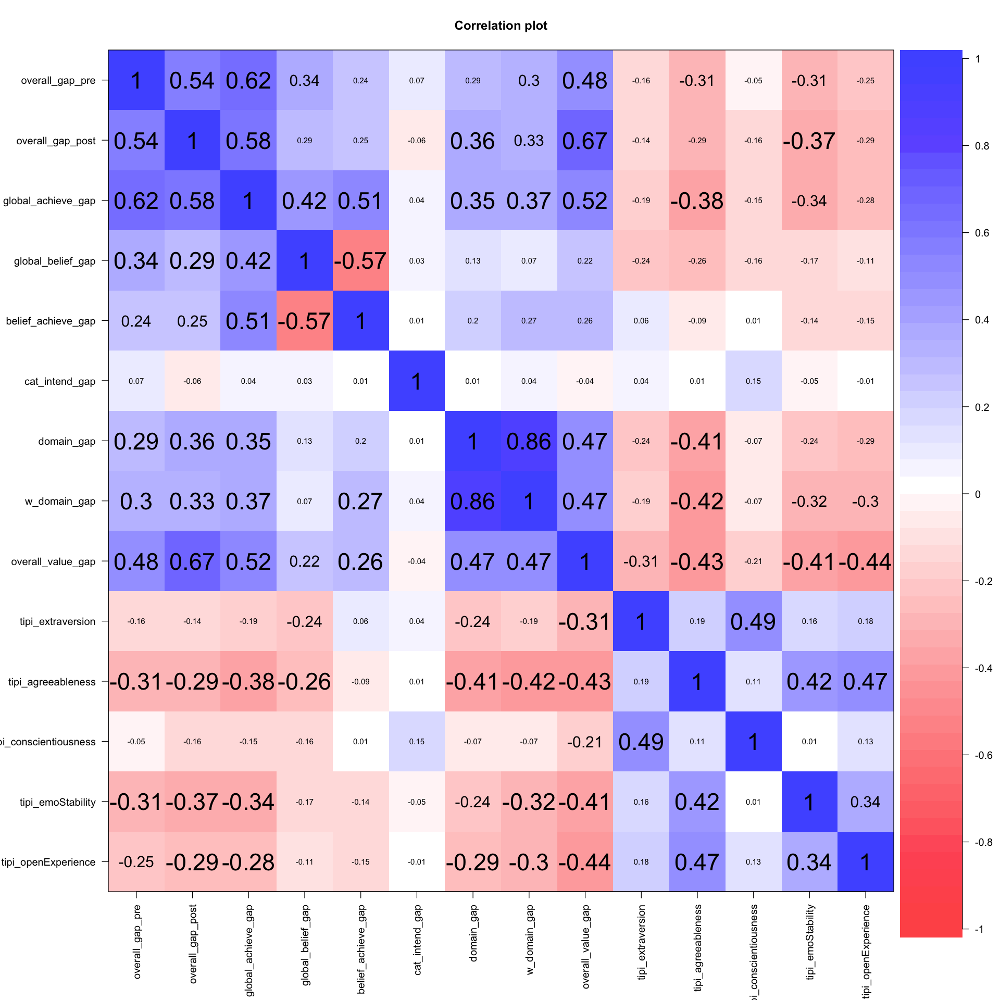

In [178]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas = 2)

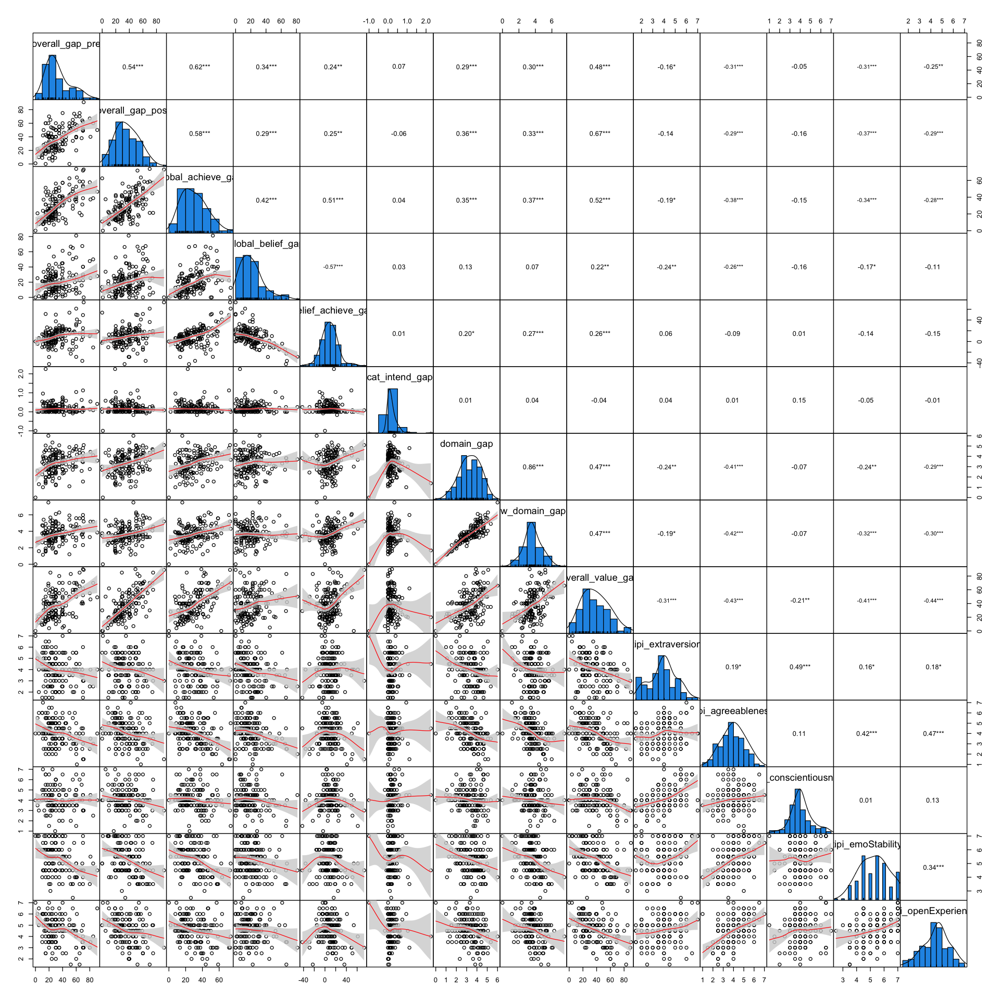

In [179]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Gap + Conscientiousness

In [585]:
df = merge(x=ib_measures_df, y=dplyr::select(validation_measures, c(subjectID, ccs_score)) ,
           by="subjectID", all.x=TRUE)

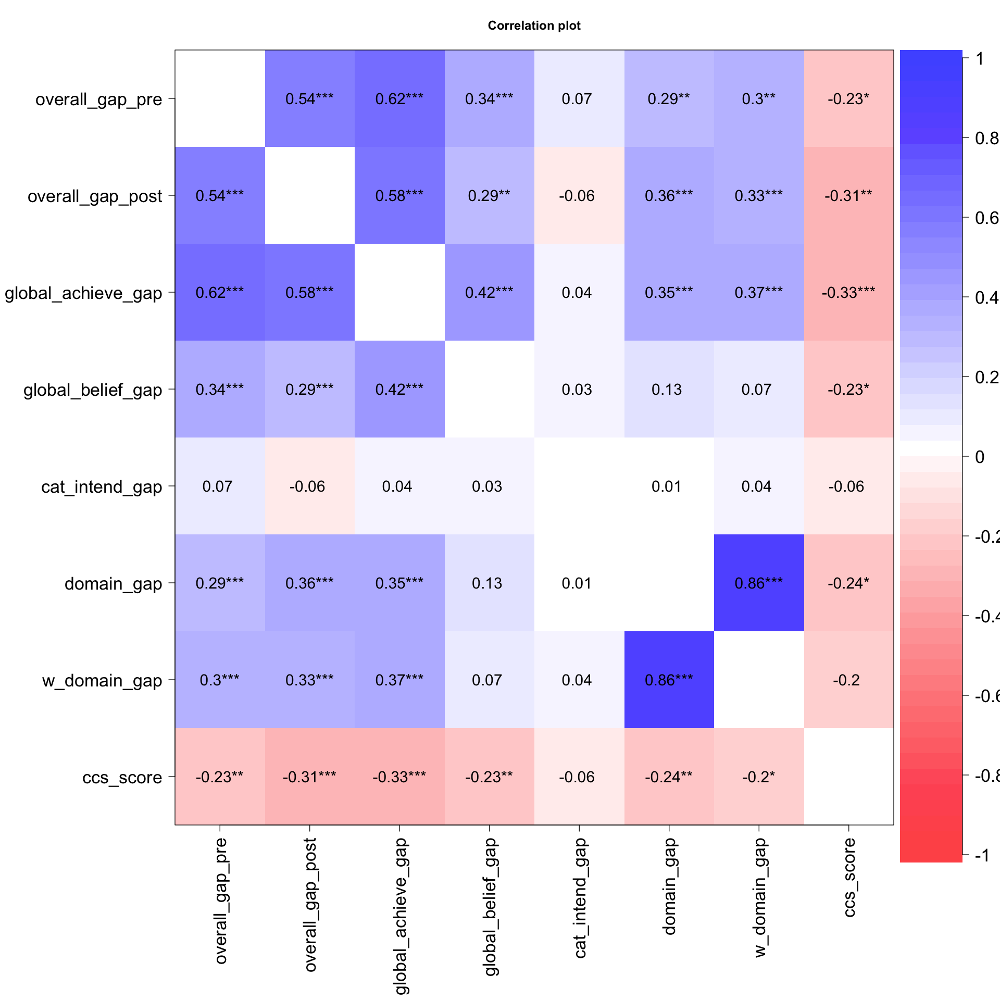

In [586]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas=2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

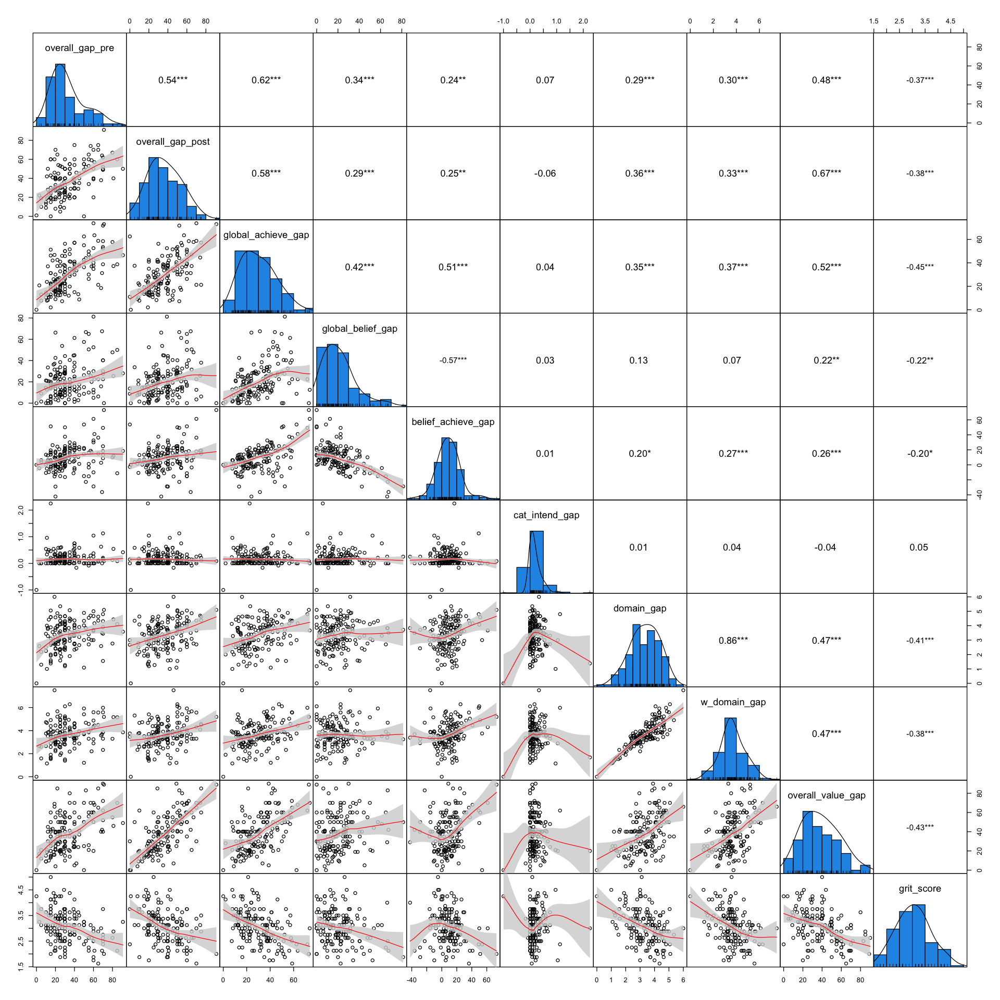

In [175]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Gap + Satisfaction with Life

In [587]:
df = merge(x=ib_measures_df, y=dplyr::select(validation_measures, c(subjectID, swl_cantril_ladder)) ,
           by="subjectID", all.x=TRUE)

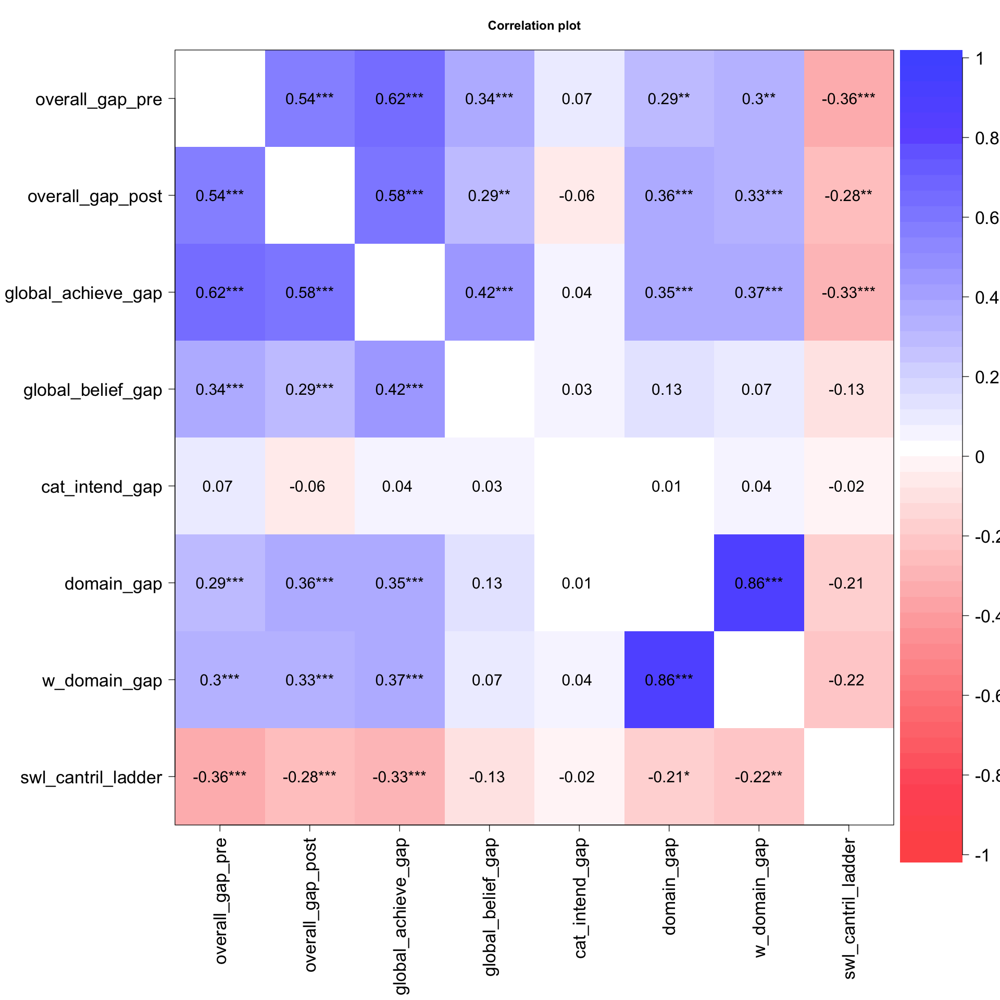

In [588]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, las = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

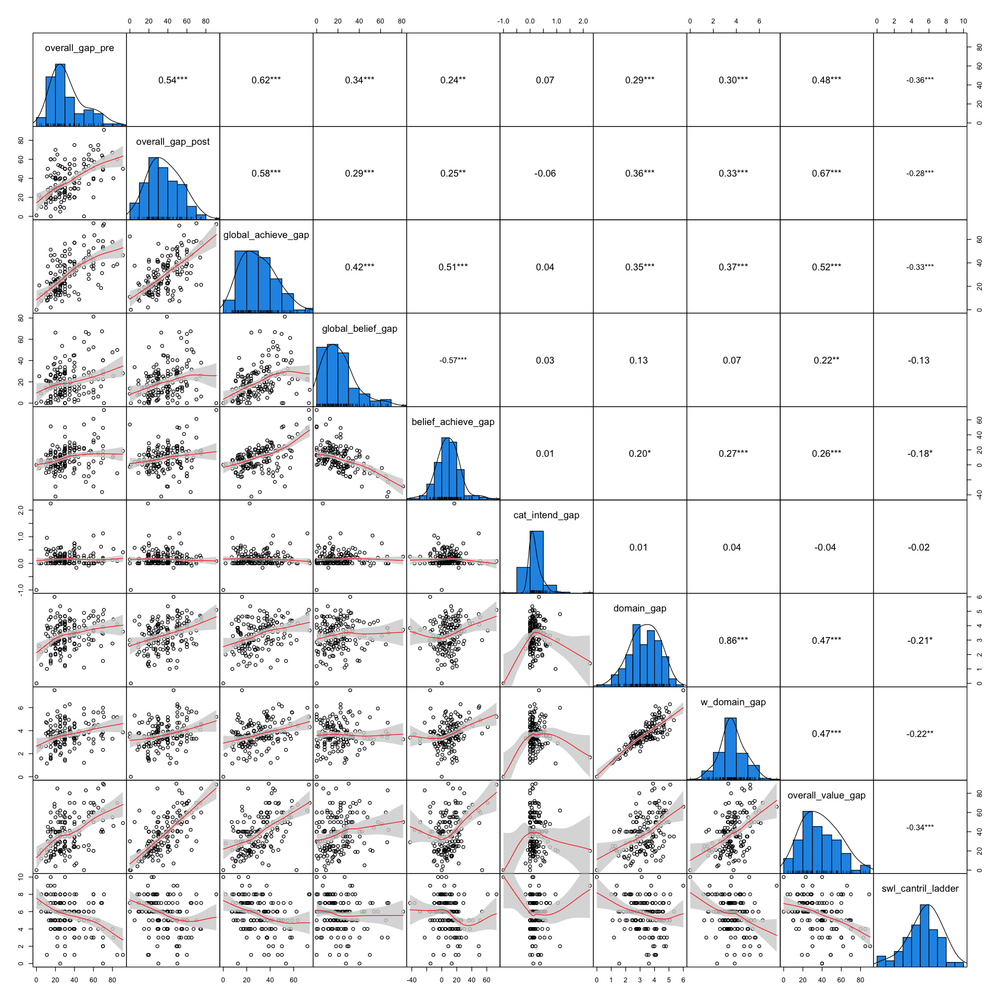

In [197]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

Interesting that the `SWL` score is only associated with `global_achieve` and `weighted domain`...(and `value gap`, but that is something else)

Correlation is about as strong as with any of the self-report validation measures...

### Gap + Self Esteem

In [589]:
df = merge(x=ib_measures_df, y=dplyr::select(validation_measures, c(subjectID, self_esteem_single_1)) ,
           by="subjectID", all.x=TRUE)

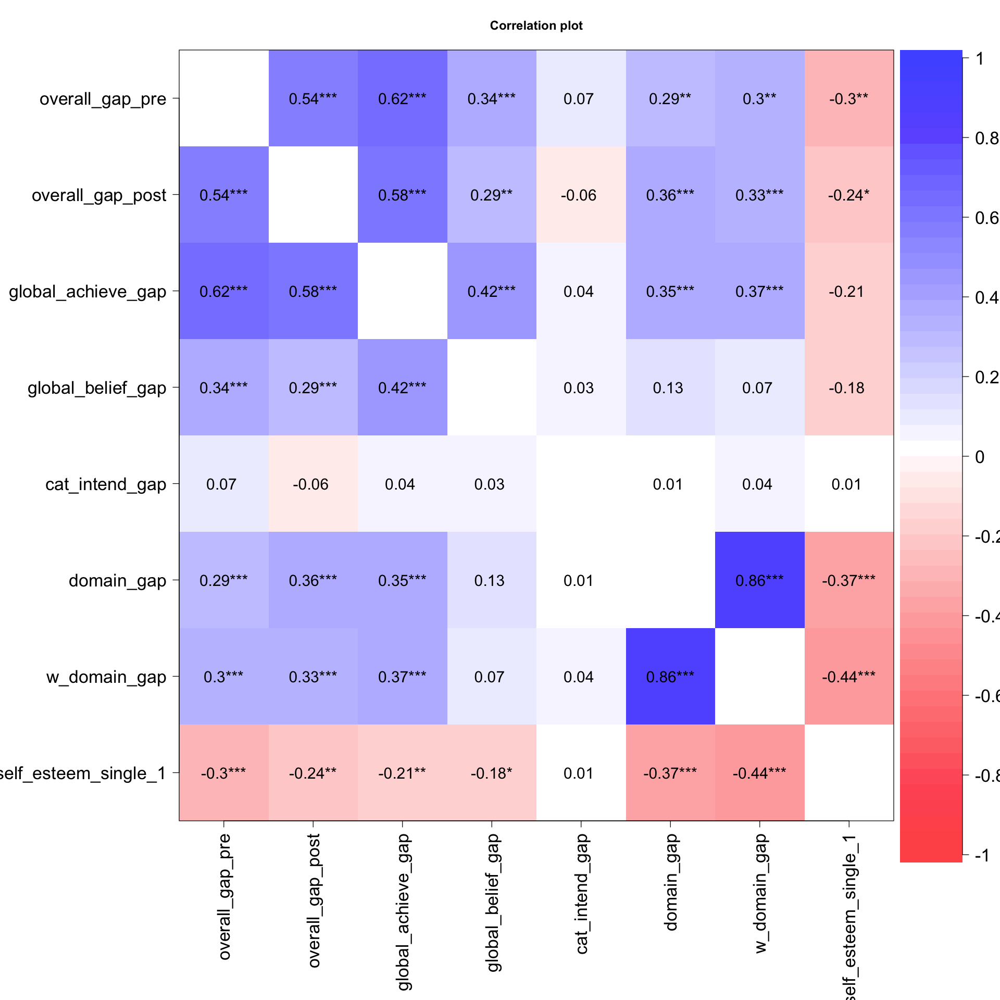

In [590]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, las = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

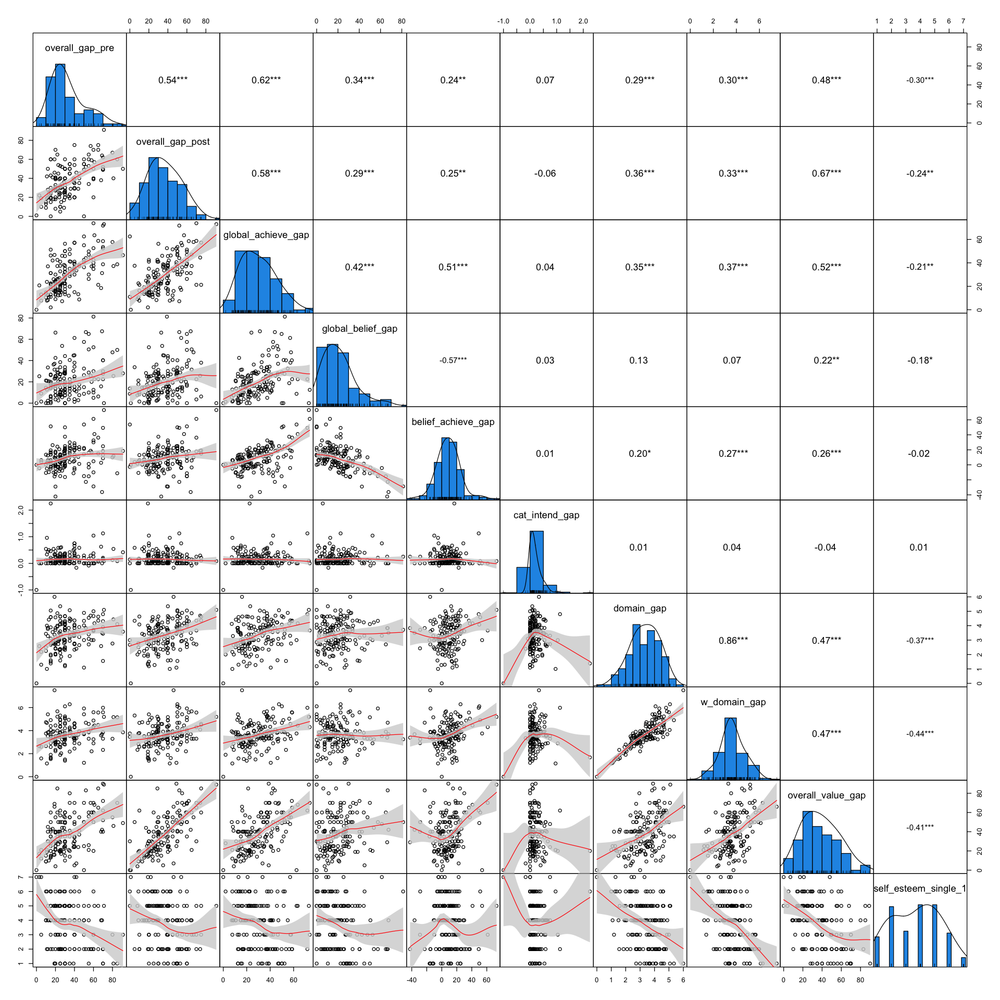

In [185]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

Interesting that the largest negative correlation is with the value gap...

and other significant correlations are with the `domain gaps` **only**

### Eisenhower + Validation.1

In [201]:
# int representing number of measure columns
dim(validation_measures)[2]

[1] 24

In [202]:
# just take the first have of validation measures so we can see what is going on
df = merge(x=select(validation_measures, 1,2:12), y=eisen_quad,
           by="subjectID", all.x=TRUE)

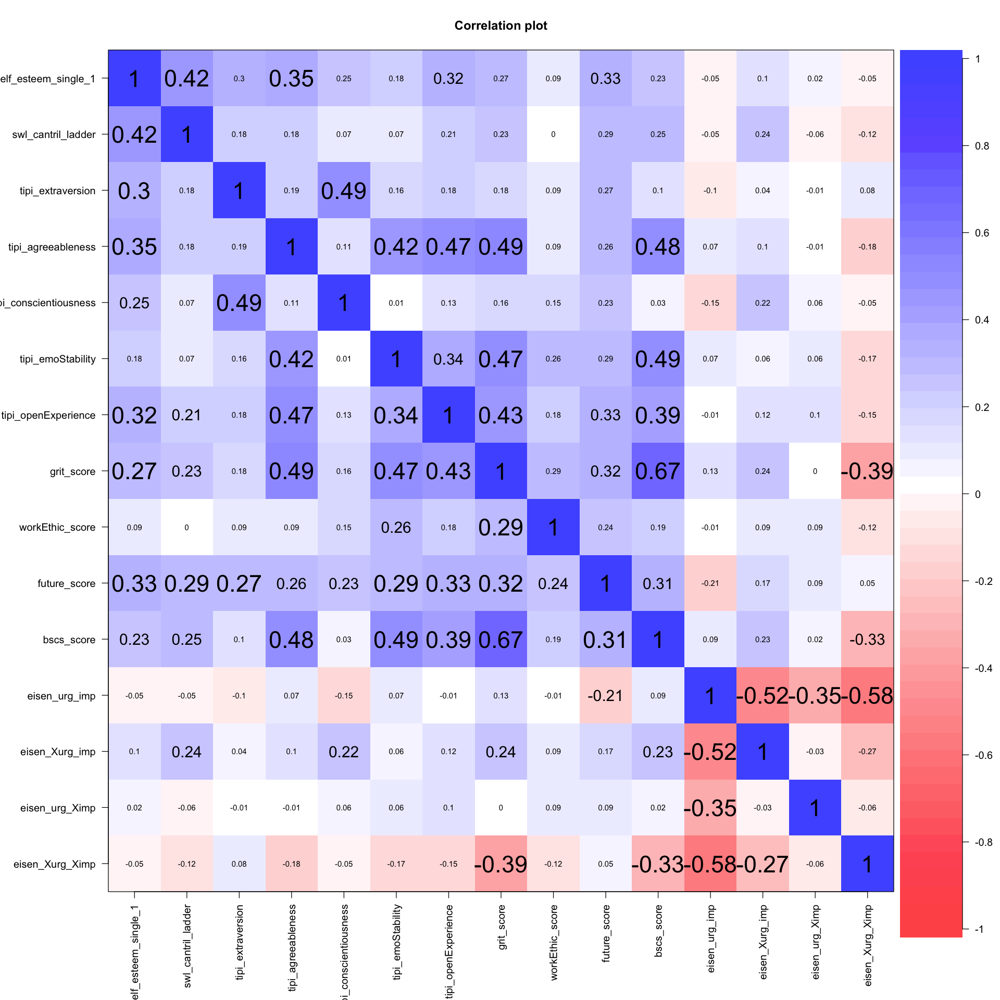

In [203]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, las = 2)

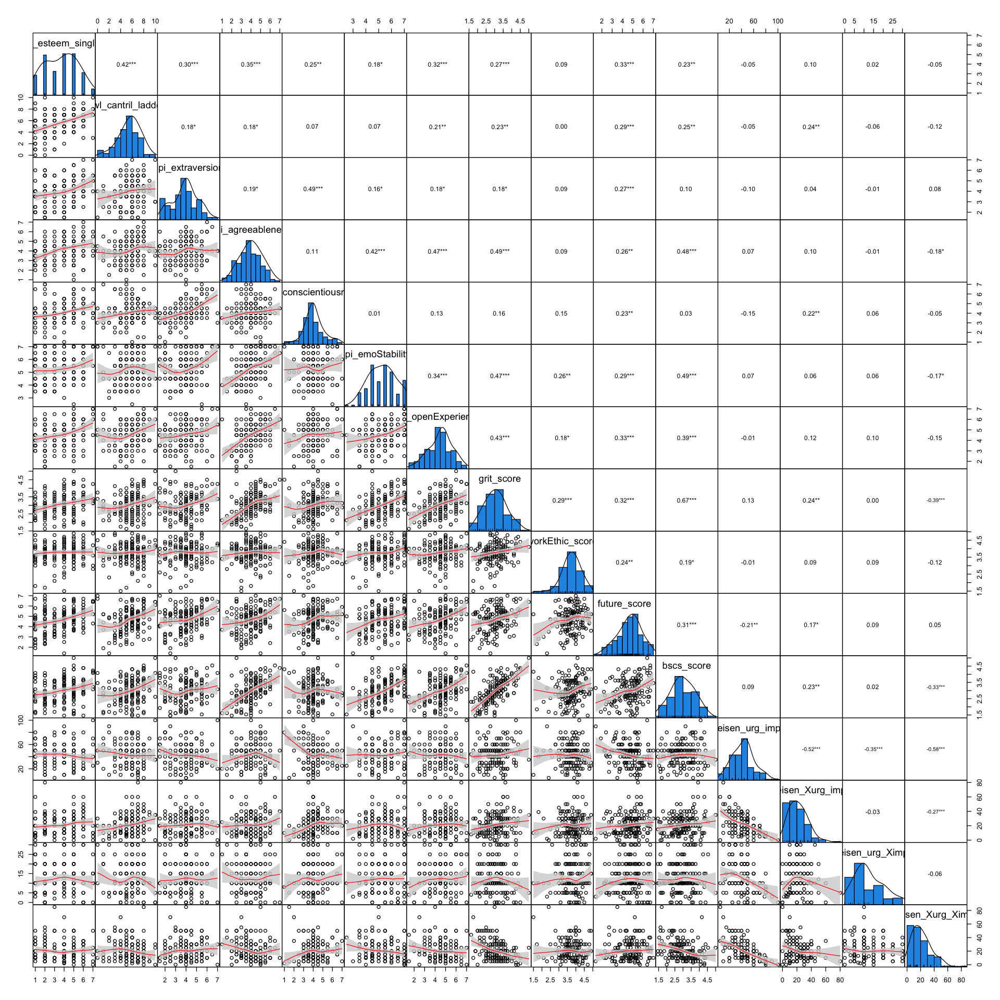

In [204]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Eisenhower + Validation.2

In [205]:
# int representing number of measure columns
dim(validation_measures)[2]

[1] 24

In [206]:
# second half of validation measures
df = merge(x=select(validation_measures, 1,13:24), y=eisen_quad,
           by="subjectID", all.x=TRUE)

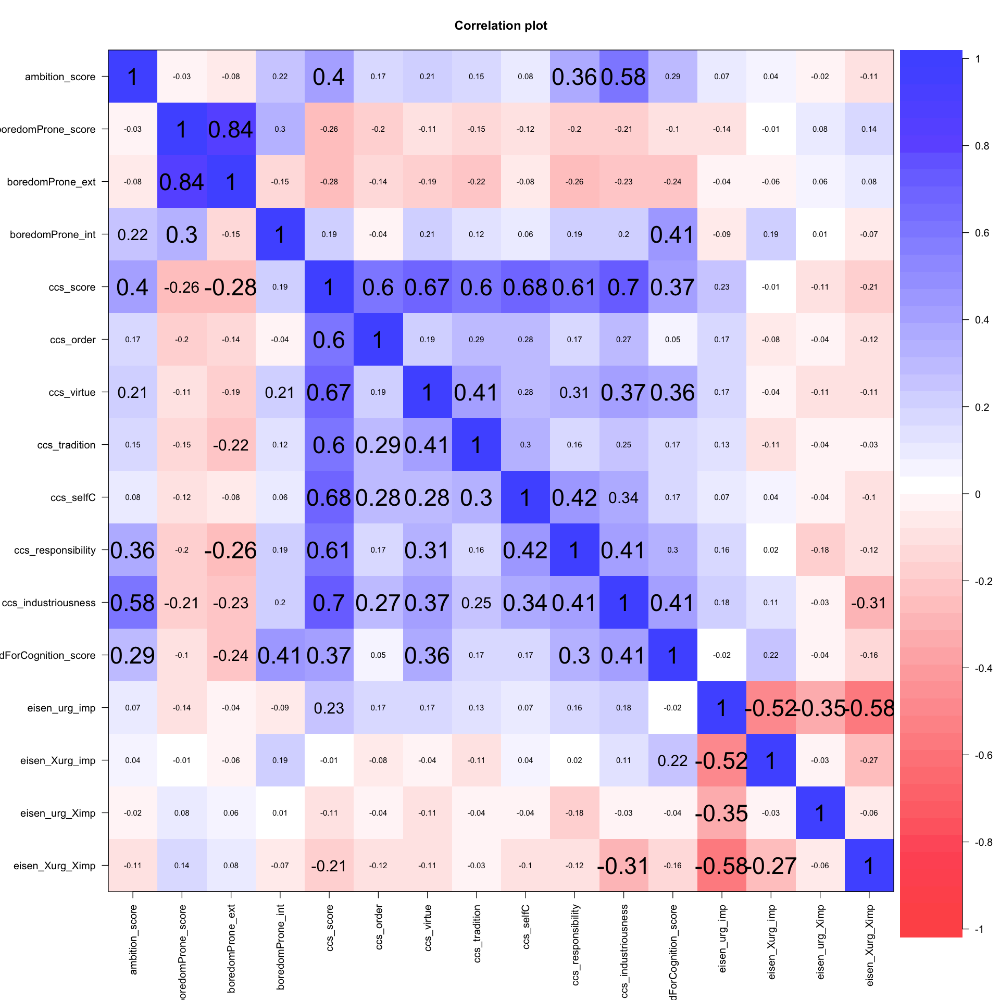

In [207]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, las = 2)

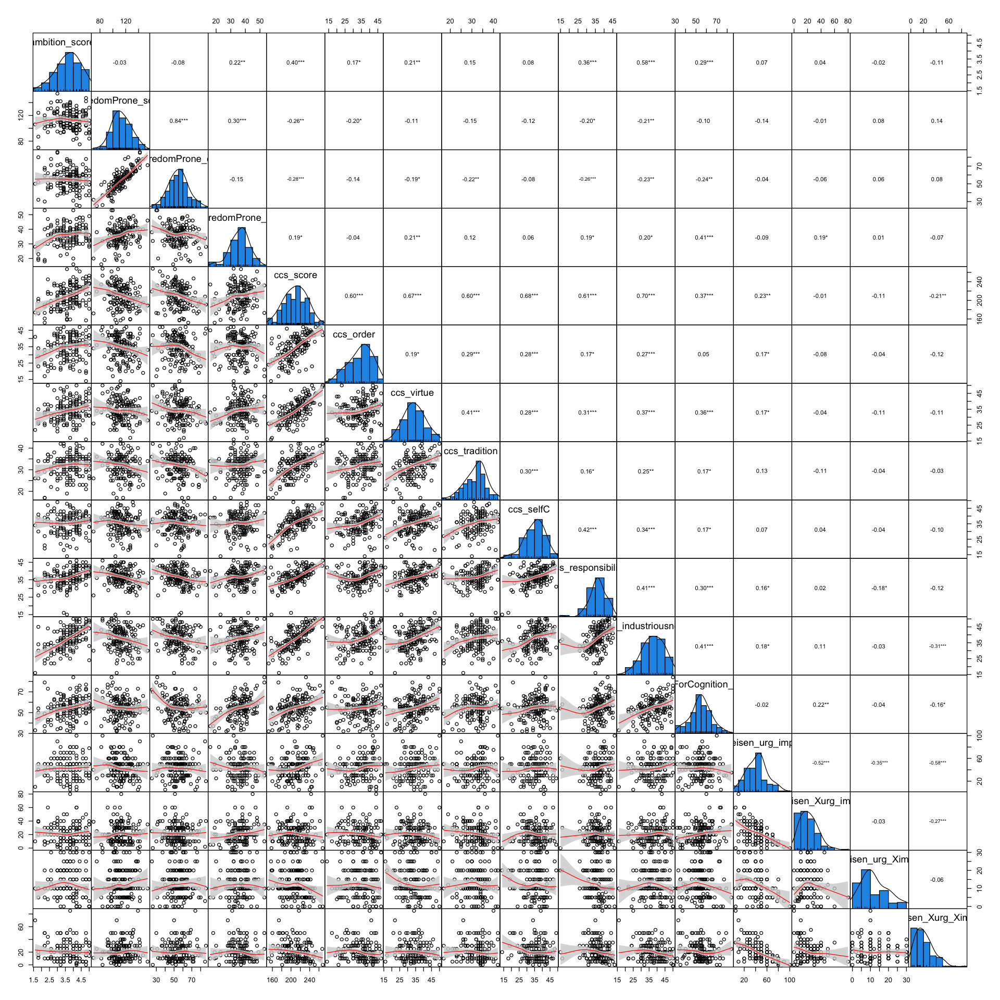

In [208]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Gap + Eisenhower

In [209]:
df = merge(x=ib_measures_df, y=eisen_quad,
           by="subjectID", all.x=TRUE)

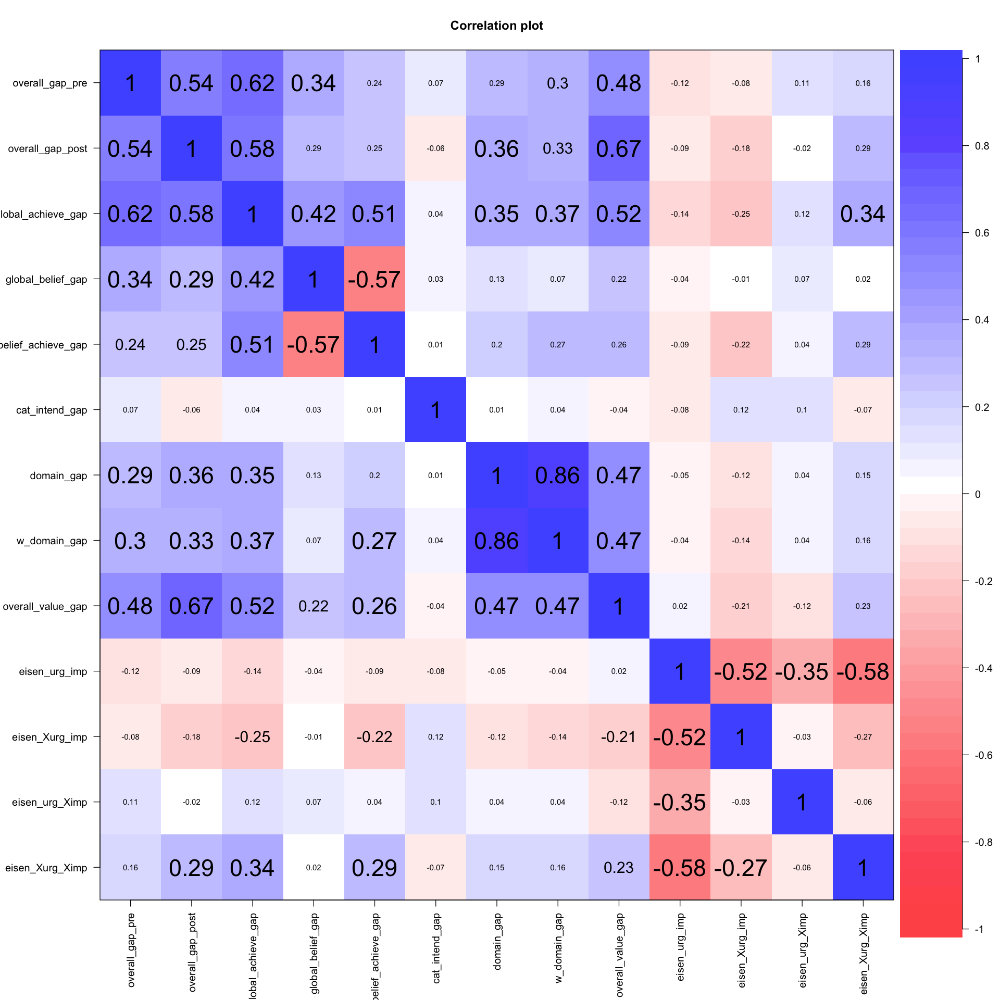

In [210]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, las = 2)

Kind of nice how the not `urgent important` quadrant is most negatively correlated with all the measures of all quadrants and `not urgent not important` is most positively correlated...

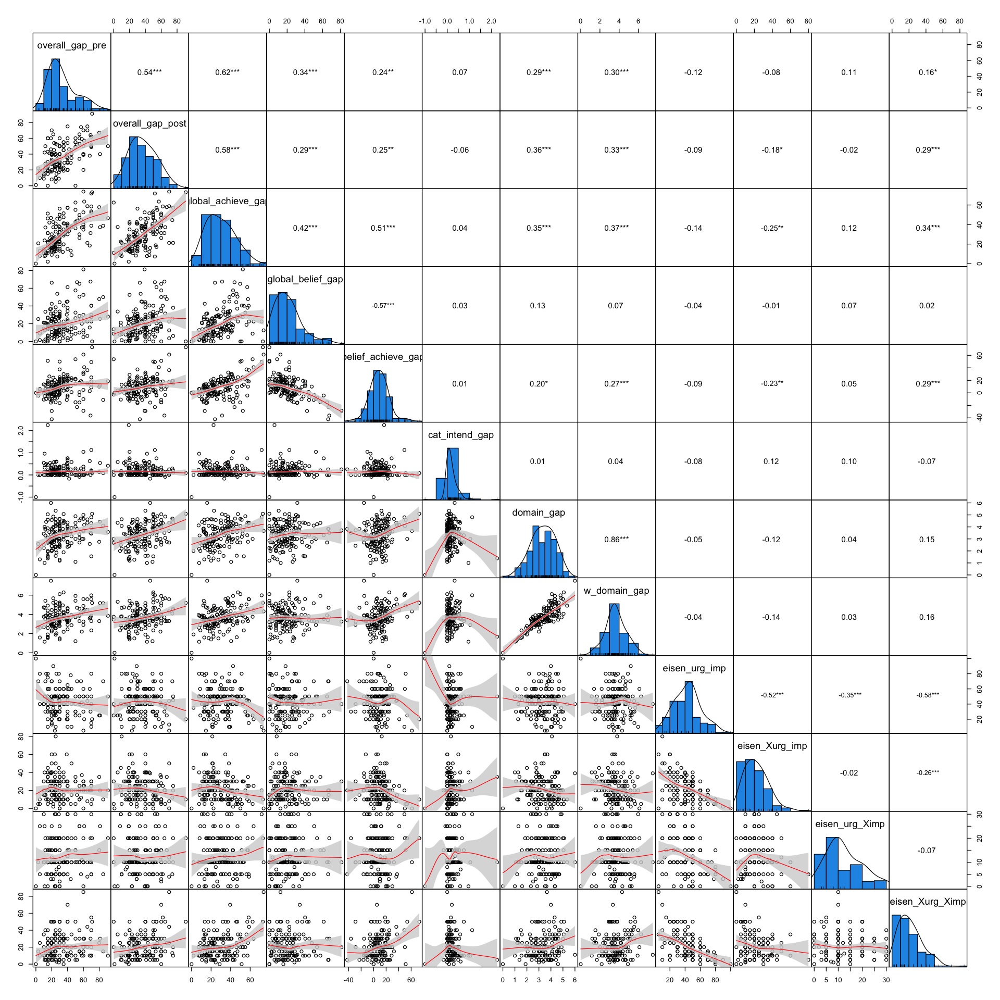

In [78]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

In SONA sample seems that the only correlation is with the not urgenet not important and the domain gap...

---

Generally seems that there is a **negative** correlation between the `URGENT IMPORTANT` quadrant and most gaps. Strongest for `domain gap`...

And overall much smaller negative correlations for `NOT URGENT IMPORTANT`.

Conversely, **positive** correlations between `NOT URGENT NOT IMPORTANT` quadrant and most gaps.

### Gap + Gap Feelings

Text from the survey question:

> **Gap Feelings**
>
>We have asked you a number of questions about your intentions and your behavior.
>
>With this in mind, could you please let us know how you honestly FEEL about your own intention-behavior gap? 
>
>To remind you, this is the difference between the actions and goals you plan to take and what you actually do, as well as the gap between the values you want to fulfill and how well you are actually fulfilling them.

Answers were 1-7 Likert scale going from `Very Bad` to `Very Good`

In [605]:
gap_feels = as.data.frame(qn_df) %>%
    dplyr::select(subjectID, meta_gap_feelings_1) %>%
    lapply(as.numeric) %>%
    data.frame()

In [606]:
df = merge(x=ib_measures_df, y=gap_feels,
           by="subjectID", all.x=TRUE)

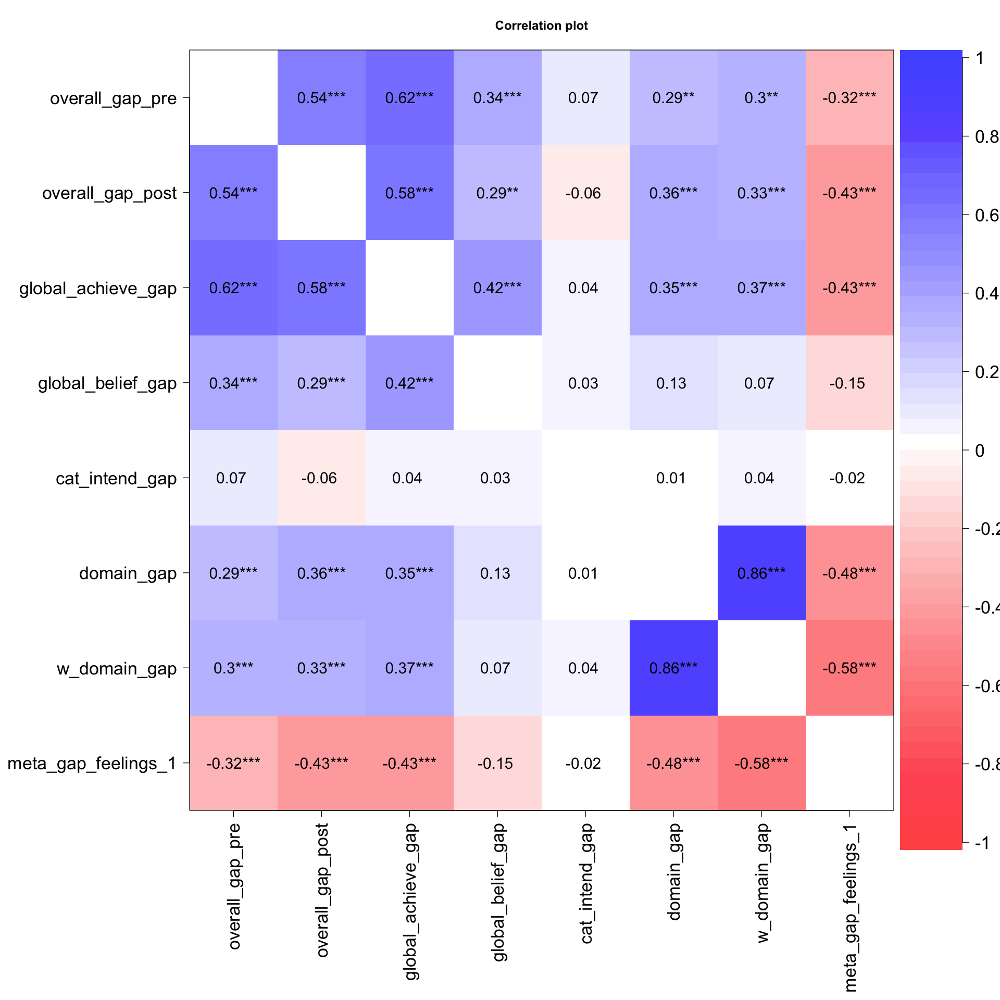

In [608]:
cor.plot(df[,2:dim(df)[2]], cex = 1.5, las = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=12)

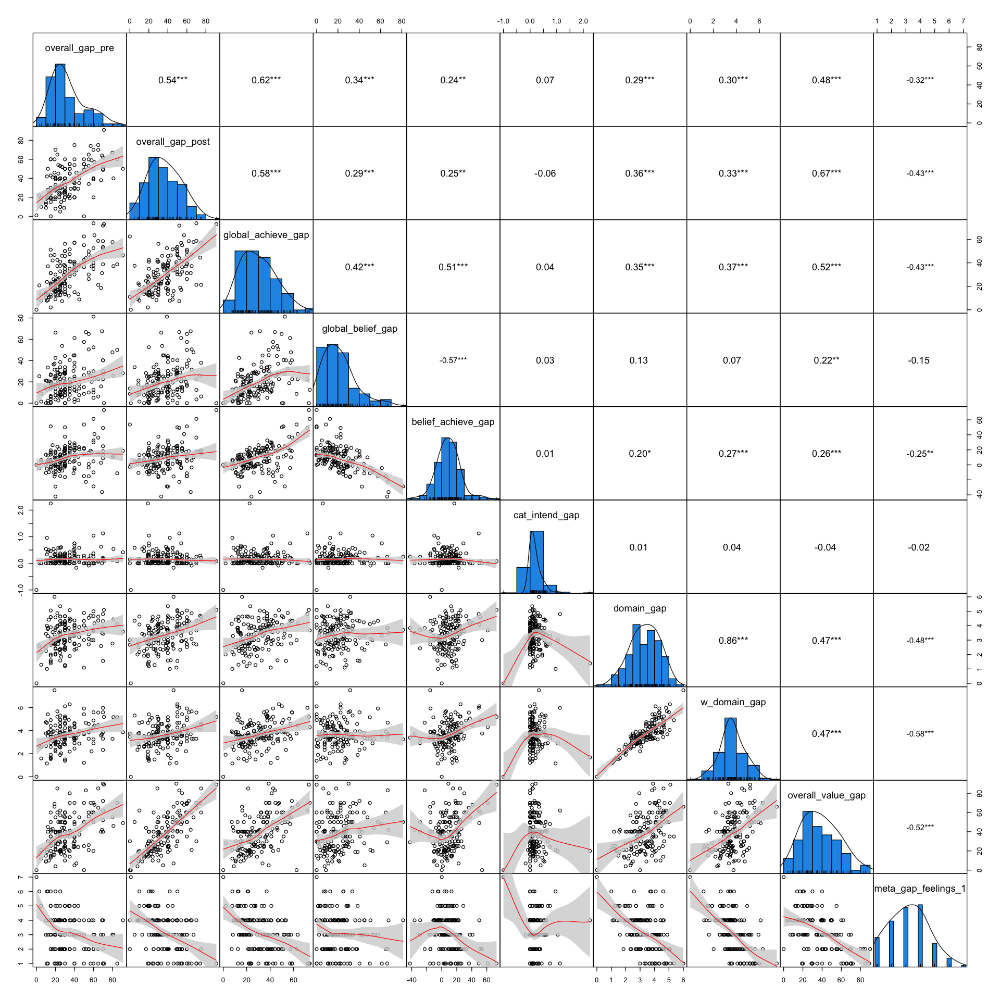

In [214]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Ambition Scale + Domain Goal Style (modest/ambitious)

Interestingly there does not seem to be a strong correlation (and such that there is is **negative**) between the score on the `ambition scale` and the `domain_ambition` measure...

In [215]:
# Calculate goal ambition
goal_ambition = qn_df %>%
    as_tibble() %>%
    select(contains('ib_domains_style')) %>%
    lapply(as.numeric) %>%
    as_tibble() %>%
    rowMeans(na.rm = TRUE)

In [216]:
ambition_test = validation_measures %>%
    select(c('subjectID', 'ambition_score')) %>%
as_tibble()

ambition_test$goal_ambition = goal_ambition

In [217]:
cor(ambition_test$goal_ambition, ambition_test$ambition_score, use = "complete.obs")

[1] -0.1223015

In [218]:
m = lm(ambition_score ~ goal_ambition, data=ambition_test)
summary(m)


Call:
lm(formula = ambition_score ~ goal_ambition, data = ambition_test)

Residuals:
     Min       1Q   Median       3Q      Max 
-2.14026 -0.46433  0.07802  0.54894  1.42020 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    3.99617    0.21252  18.804   <2e-16 ***
goal_ambition -0.09140    0.05996  -1.524     0.13    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.775 on 153 degrees of freedom
  (1 observation deleted due to missingness)
Multiple R-squared:  0.01496,	Adjusted R-squared:  0.008519 
F-statistic: 2.323 on 1 and 153 DF,  p-value: 0.1295


# Predictive Models

Looking at the domain measures, which ones are associated with the size of the gap?

Note:
- `gapcause` goes from *completely external* to *completely internal*
- `goal_style` goes from *very modest* to *very ambitious*
    - this has now been renamed to reflect the variable more accurately

## Model Selection Tools

In [20]:
library(caret) # or easy machine learning workflow
library(leaps) # for computing best subsets regression

Loading required package: lattice


Attaching package: ‘caret’


The following object is masked from ‘package:purrr’:

    lift




For ML Cross Valildation adding some helper functions from [this tutorial](http://www.sthda.com/english/articles/37-model-selection-essentials-in-r/155-best-subsets-regression-essentials-in-r/)

---

1. `get_model_formula()`, allowing to access easily the formula of the models returned by the function `regsubsets()`. 

In [21]:
# id: model id
# object: regsubsets object
# data: data used to fit regsubsets
# outcome: outcome variable
get_model_formula <- function(id, object, outcome){
  # get models data
  models <- summary(object)$which[id,-1]
  # Get outcome variable
  #form <- as.formula(object$call[[2]])
  #outcome <- all.vars(form)[1]
  # Get model predictors
  predictors <- names(which(models == TRUE))
  predictors <- paste(predictors, collapse = "+")
  # Build model formula
  as.formula(paste0(outcome, "~", predictors))
}

2. `get_cv_error()`, to get the cross-validation (CV) error for a given model:

In [22]:
# 10 fold cv
get_cv_error <- function(model.formula, data){
  set.seed(1)
  train.control <- trainControl(method = "cv", number = 10)
  cv <- train(model.formula, data = data, method = "lm",
              trControl = train.control)
  cv$results$RMSE
}

## Domain Success

What predicts domain success (i.e. the reciprocal of the gap)?

What variables are in the "best" model when taking into account the various dimensions of the gap we measured.

**Note** We measure both `success` in achieving your goals in each domain in which you have goals as well as `satisfaction` (the idea being that you may not be completely successful but you may be completely satisfied - or vice versa). However we expect these two measures to be HIGHLY correlated.

In [19]:
cor(scaled_domains_long$domains_success, scaled_domains_long$domains_satis)

[1] 0.7326139

In [77]:
# rename style to ambitious to reflect the measurement better
scaled_domains_long = scaled_domains_long %>% 
  rename(
    domains_ambitious = domains_style,
    )

In [78]:
names(scaled_domains_long)

[1] "domain_num"         "subjectID"          "domains_specific"  
 [4] "domains_success"    "domains_satis"      "domains_import"    
 [7] "domains_ambitious"  "domains_internal"   "domains_external"  
[10] "domains_gapcause"   "domain_gap"         "w_domain_gap"      
[13] "domain_names"       "domain_names_short"

In [79]:
all_domain_measures = c('domains_internal',
                        'domains_external',
                        'domains_specific',
                        'domains_import',
                        'domains_ambitious',
                        'domains_gapcause',
                        'domains_satis',
                        'domain_gap',
                        'subjectID'
                      )

### Quick Look (MLM)

Note that adding in `satisfaction` changes the model quite a bit. 

It has a very large effect and makes other measures more significant but with smaller effects.

In [85]:
# A quick look at a model with everything, nested by subject

m <- lmer(domain_gap ~ domains_internal + domains_external + domains_specific 
          + domains_import + domains_ambitious + domains_gapcause + domains_satis 
          + (1 | subjectID),
        data = scaled_domains_long[, all_domain_measures])
summary(m)

Linear mixed model fit by REML. t-tests use Satterthwaite's method [
lmerModLmerTest]
Formula: domain_gap ~ domains_internal + domains_external + domains_specific +  
    domains_import + domains_ambitious + domains_gapcause + domains_satis +  
    (1 | subjectID)
   Data: scaled_domains_long[, all_domain_measures]

REML criterion at convergence: 7226.2

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-4.4796 -0.5716  0.0052  0.6036  4.3928 

Random effects:
 Groups    Name        Variance Std.Dev.
 subjectID (Intercept) 0.1771   0.4208  
 Residual              0.9126   0.9553  
Number of obs: 2539, groups:  subjectID, 151

Fixed effects:
                    Estimate Std. Error         df t value Pr(>|t|)    
(Intercept)          6.94583    0.11898 1448.12217  58.378  < 2e-16 ***
domains_internal    -0.07358    0.01635 2233.29394  -4.501 7.12e-06 ***
domains_external     0.01430    0.01242 2147.42926   1.151 0.249661    
domains_specific    -0.07927    0.01313 2509.91628  -

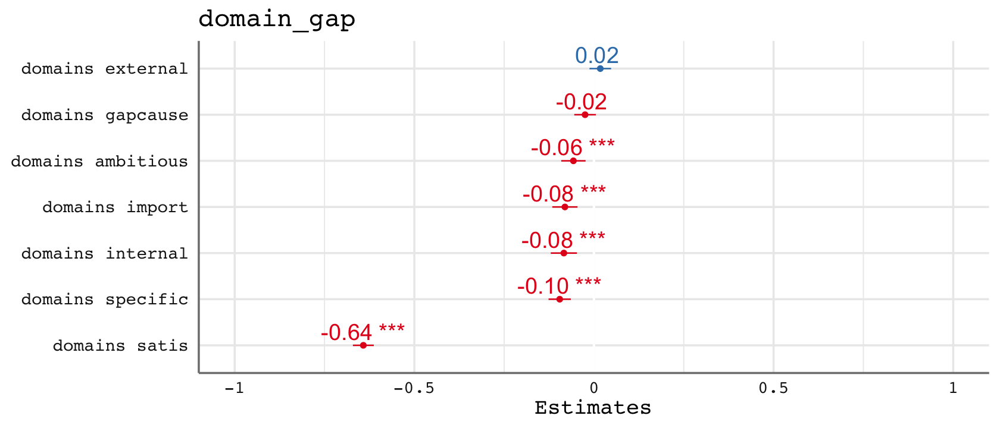

In [86]:
options(repr.plot.width = 14, repr.plot.height = 6)

plot_model(m, 
           type = "std",
           sort.est = TRUE,
           show.values = TRUE,
           value.offset = .3,
           value.size = 8,
           axis.lim = c(-0.1, 0.3)
          ) + theme_sjplot2(base_size = 22, base_family = "Courier")

### Find Best Model

In [72]:
# not using subject atm
# would be good to be able to fit all the models as nested within subject...

all_domain_measures = c('domains_internal',
                        'domains_external',
                        'domains_specific',
                        'domains_import',
                        'domains_style',
                        'domains_gapcause',
                        'domains_satis',
                        'domain_gap'
                       )

In [73]:
models <- regsubsets(domain_gap~.,
                     data = scaled_domains_long[,c(all_domain_measures)],
                     nvmax = 7)
summary(models)

Subset selection object
Call: regsubsets.formula(domain_gap ~ ., data = scaled_domains_long[, 
    c(all_domain_measures)], nvmax = 7)
7 Variables  (and intercept)
                 Forced in Forced out
domains_internal     FALSE      FALSE
domains_external     FALSE      FALSE
domains_specific     FALSE      FALSE
domains_import       FALSE      FALSE
domains_style        FALSE      FALSE
domains_gapcause     FALSE      FALSE
domains_satis        FALSE      FALSE
1 subsets of each size up to 7
Selection Algorithm: exhaustive
         domains_internal domains_external domains_specific domains_import
1  ( 1 ) " "              " "              " "              " "           
2  ( 1 ) " "              " "              " "              "*"           
3  ( 1 ) " "              " "              "*"              "*"           
4  ( 1 ) "*"              " "              "*"              "*"           
5  ( 1 ) "*"              " "              "*"              "*"           
6  ( 1 ) "*"       

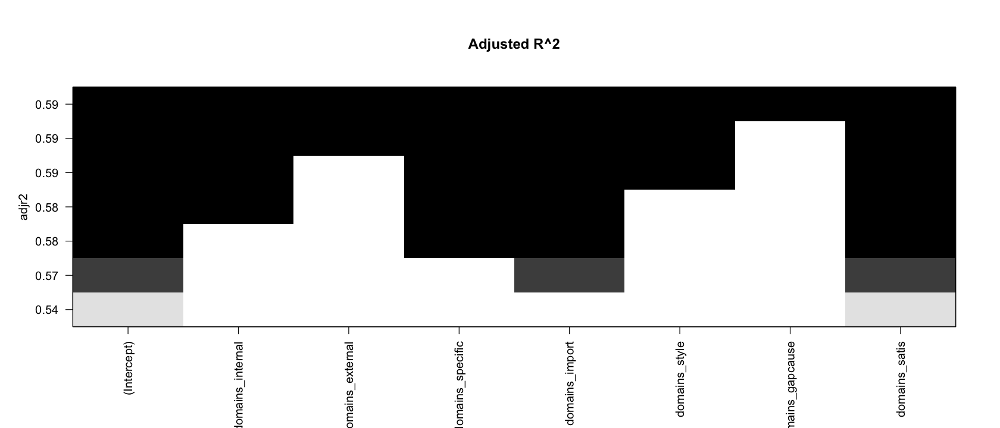

In [74]:
plot(models, scale = "adjr2", main = "Adjusted R^2")

In [75]:
# model selection criteria
res.sum <- summary(models)
data.frame(
  Adj.R2 = which.max(res.sum$adjr2),
  CP = which.min(res.sum$cp),
  BIC = which.min(res.sum$bic)
)

Adj.R2,CP,BIC
<int>,<int>,<int>
7,7,5


##### Cross Validation

[1] 1.092292 1.053260 1.036957 1.034139 1.032619 1.032625 1.032385

domain_gap ~ domains_internal + domains_external + domains_specific + 
    domains_import + domains_style + domains_gapcause + domains_satis
<environment: 0x12b61a128>

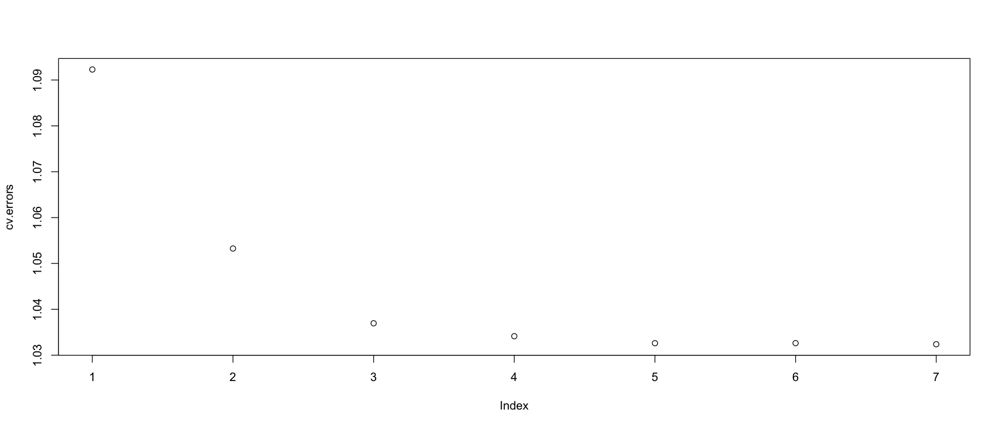

In [76]:
model.ids <- 1:7
cv.errors <-  map(model.ids, get_model_formula, models, "domain_gap") %>%
  map(get_cv_error, data = scaled_domains_long[, all_domain_measures]) %>%
  unlist()
cv.errors # list errors
plot(cv.errors) # plot errors
get_model_formula(which.min(cv.errors), models, "domain_gap") # best model

### Predicted by domain variables

In [12]:
names(scaled_domains_long)

[1] "domain_num"         "subjectID"          "domains_specific"  
 [4] "domains_success"    "domains_satis"      "domains_import"    
 [7] "domains_style"      "domains_internal"   "domains_external"  
[10] "domains_gapcause"   "domain_gap"         "w_domain_gap"      
[13] "domain_names"       "domain_names_short"

In [17]:
m <- lm(domain_gap ~ domains_internal + domains_external + domains_specific + domains_import + domains_style + domains_gapcause + domains_satis,
        data = scaled_domains_long)
summary(m)


Call:
lm(formula = domain_gap ~ domains_internal + domains_external + 
    domains_specific + domains_import + domains_style + domains_gapcause + 
    domains_satis, data = scaled_domains_long)

Residuals:
    Min      1Q  Median      3Q     Max 
-4.6007 -0.6520 -0.0068  0.6798  4.3241 

Coefficients:
                 Estimate Std. Error t value Pr(>|t|)    
(Intercept)       6.95451    0.10164  68.423  < 2e-16 ***
domains_internal -0.04560    0.01458  -3.127 0.001785 ** 
domains_external  0.01607    0.01091   1.472 0.141136    
domains_specific -0.09227    0.01264  -7.302 3.77e-13 ***
domains_import   -0.51638    0.09771  -5.285 1.37e-07 ***
domains_style    -0.04660    0.01369  -3.404 0.000675 ***
domains_gapcause -0.01738    0.01212  -1.433 0.151850    
domains_satis    -0.60052    0.01222 -49.152  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.033 on 2531 degrees of freedom
Multiple R-squared:  0.5878,	Adjusted R-squared:

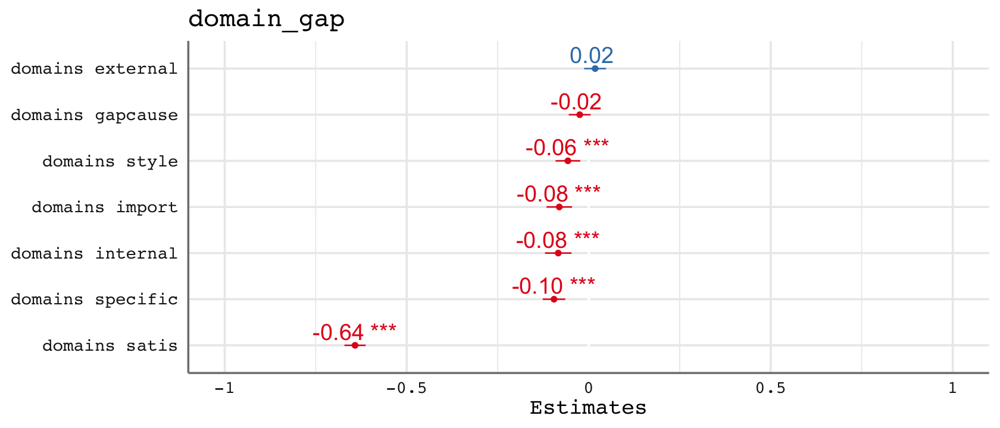

In [28]:
options(repr.plot.width = 14, repr.plot.height = 6)

plot_model(m, 
           type = "std",
           sort.est = TRUE,
           show.values = TRUE,
           value.offset = .3,
           value.size = 8,
           axis.lim = c(-0.1, 0.3)
          ) + theme_sjplot2(base_size = 22, base_family = "Courier")

In [190]:
sjPlot::tab_model(m)

Loading required namespace: broom.mixed

Loading required namespace: broom.mixed



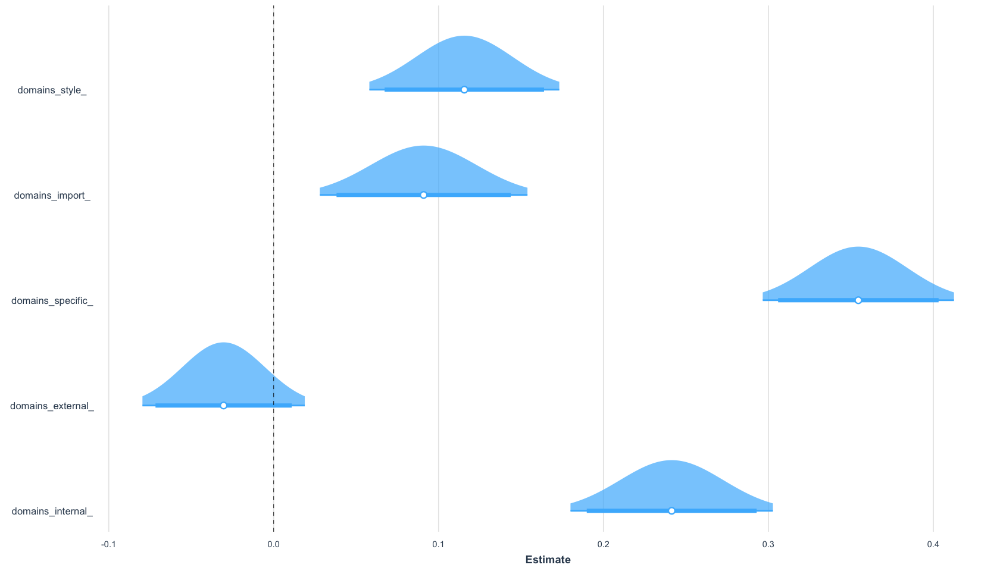

In [87]:
# using jtools
# https://cran.r-project.org/web/packages/jtools/vignettes/summ.html

plot_summs(m, scale = TRUE, plot.distributions = TRUE, inner_ci_level = .9)

#### Bayesian Estimate


SAMPLING FOR MODEL 'continuous' NOW (CHAIN 1).
Chain 1: 
Chain 1: Gradient evaluation took 2.4e-05 seconds
Chain 1: 1000 transitions using 10 leapfrog steps per transition would take 0.24 seconds.
Chain 1: Adjust your expectations accordingly!
Chain 1: 
Chain 1: 
Chain 1: Iteration:    1 / 2000 [  0%]  (Warmup)
Chain 1: Iteration:  200 / 2000 [ 10%]  (Warmup)
Chain 1: Iteration:  400 / 2000 [ 20%]  (Warmup)
Chain 1: Iteration:  600 / 2000 [ 30%]  (Warmup)
Chain 1: Iteration:  800 / 2000 [ 40%]  (Warmup)
Chain 1: Iteration: 1000 / 2000 [ 50%]  (Warmup)
Chain 1: Iteration: 1001 / 2000 [ 50%]  (Sampling)
Chain 1: Iteration: 1200 / 2000 [ 60%]  (Sampling)
Chain 1: Iteration: 1400 / 2000 [ 70%]  (Sampling)
Chain 1: Iteration: 1600 / 2000 [ 80%]  (Sampling)
Chain 1: Iteration: 1800 / 2000 [ 90%]  (Sampling)
Chain 1: Iteration: 2000 / 2000 [100%]  (Sampling)
Chain 1: 
Chain 1:  Elapsed Time: 0.058142 seconds (Warm-up)
Chain 1:                0.246721 seconds (Sampling)
Chain 1:              

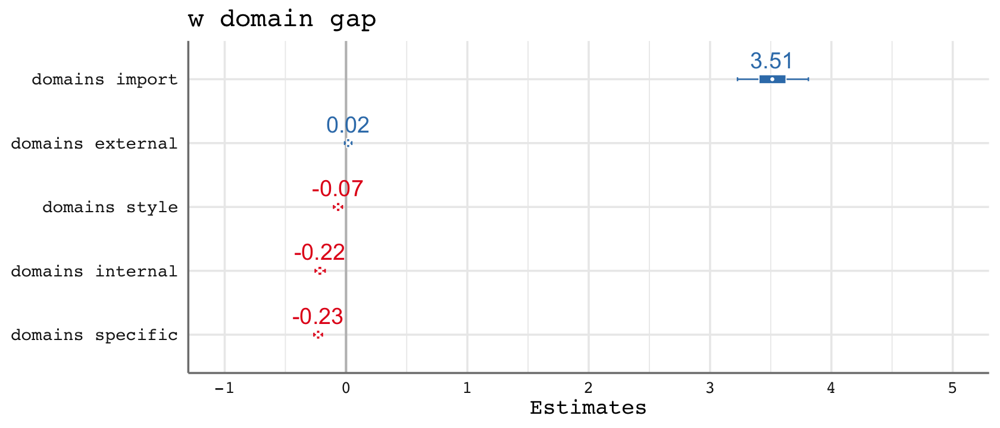

In [627]:
if (require("rstanarm", quietly = TRUE)) {
  # make sure we apply a nice theme
  theme_set(theme_sjplot2(base_size = 22, base_family = "Courier"))
  
  m <- stan_glm(w_domain_gap ~ domains_internal + domains_external + domains_specific + domains_import + domains_style,
                data = scaled_domains_long,
                chains = 1)
  
  # default model
  plot_model(m)
  # same model, with mean point estimate, dot-style for point estimate
  # and different inner/outer probabilities of the HDI
  plot_model(
      m,
      bpe = "mean",
      bpe.style = "dot",
      prob.inner = .5,
      prob.outer = .9,
      sort.est = TRUE, 
      show.values = TRUE, 
      value.offset = .3, 
      value.size = 8,
      vline.color = "grey"
  )
    
}

### Predicted by goal setting style

## Domain Satisfaction

Note that since `domain success` and `domain satisfaction` are correlated that we should probably use a multivariate linear model.

Multivariate linear models should be used when:
1. You have more than one dependent variable for the same set of predictors
2. Your DVs are correlated

In [185]:
m <- lm(domains_satis ~ domains_success,
        data = scaled_domains_long)
summary(m)


Call:
lm(formula = domains_satis ~ domains_success, data = scaled_domains_long)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.1818 -0.7532 -0.0389  0.5325  5.6754 

Coefficients:
                Estimate Std. Error t value Pr(>|t|)    
(Intercept)      0.51502    0.05430   9.484   <2e-16 ***
domains_success  0.80955    0.01493  54.214   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.209 on 2537 degrees of freedom
Multiple R-squared:  0.5367,	Adjusted R-squared:  0.5365 
F-statistic:  2939 on 1 and 2537 DF,  p-value: < 2.2e-16


In [186]:
glance(m) %>%
    select(AIC, BIC)

AIC,BIC
<dbl>,<dbl>
8171.352,8188.871


In [187]:
m <- lm(domains_satis ~ domains_success + domains_import,
        data = scaled_domains_long)
summary(m)


Call:
lm(formula = domains_satis ~ domains_success + domains_import, 
    data = scaled_domains_long)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.1307 -0.8122 -0.0394  0.6097  5.8307 

Coefficients:
                Estimate Std. Error t value Pr(>|t|)    
(Intercept)      0.82918    0.10352   8.010 1.73e-15 ***
domains_success  0.82690    0.01567  52.754  < 2e-16 ***
domains_import  -0.32455    0.09112  -3.562 0.000375 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.206 on 2536 degrees of freedom
Multiple R-squared:  0.539,	Adjusted R-squared:  0.5387 
F-statistic:  1483 on 2 and 2536 DF,  p-value: < 2.2e-16


In [188]:
glance(m) %>%
    select(AIC, BIC)

AIC,BIC
<dbl>,<dbl>
8160.683,8184.041


In [189]:
m <- lm(domains_satis ~ domains_success * domains_import,
        data = scaled_domains_long)
summary(m)


Call:
lm(formula = domains_satis ~ domains_success * domains_import, 
    data = scaled_domains_long)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.3520 -0.7630 -0.0142  0.5302  5.9799 

Coefficients:
                               Estimate Std. Error t value Pr(>|t|)    
(Intercept)                     1.55903    0.21324   7.311 3.53e-13 ***
domains_success                 0.57537    0.06618   8.694  < 2e-16 ***
domains_import                 -0.95170    0.18429  -5.164 2.60e-07 ***
domains_success:domains_import  0.20886    0.05340   3.911 9.41e-05 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.202 on 2535 degrees of freedom
Multiple R-squared:  0.5418,	Adjusted R-squared:  0.5413 
F-statistic: 999.2 on 3 and 2535 DF,  p-value: < 2.2e-16


In [190]:
glance(m) %>%
    select(AIC, BIC)

AIC,BIC
<dbl>,<dbl>
8147.405,8176.603


In [644]:
m <- lm(domains_satis ~ domain_gap * domains_import + domains_internal,
        data = scaled_domains_long)
summary(m)


Call:
lm(formula = domains_satis ~ domain_gap * domains_import + domains_internal, 
    data = scaled_domains_long)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.3266 -0.7627  0.0225  0.5145  6.1316 

Coefficients:
                          Estimate Std. Error t value Pr(>|t|)    
(Intercept)                5.53653    0.29612  18.697  < 2e-16 ***
domain_gap                -0.56782    0.06603  -8.599  < 2e-16 ***
domains_import             0.27667    0.23927   1.156 0.247668    
domains_internal           0.06251    0.01634   3.826 0.000133 ***
domain_gap:domains_import -0.20361    0.05327  -3.822 0.000135 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.199 on 2534 degrees of freedom
Multiple R-squared:  0.5444,	Adjusted R-squared:  0.5437 
F-statistic: 757.1 on 4 and 2534 DF,  p-value: < 2.2e-16


In [642]:
glance(m) %>%
    dplyr::select(AIC, BIC)

AIC,BIC
<dbl>,<dbl>
8134.779,8169.816


In [199]:
m <- lm(domains_satis ~ domains_internal + domains_external + domains_specific + domains_style + domains_success*domains_import,
        data = scaled_domains_long)
summary(m)


Call:
lm(formula = domains_satis ~ domains_internal + domains_external + 
    domains_specific + domains_style + domains_success * domains_import, 
    data = scaled_domains_long)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.3415 -0.7756  0.0161  0.5321  6.0529 

Coefficients:
                                Estimate Std. Error t value Pr(>|t|)    
(Intercept)                     1.531347   0.213366   7.177 9.31e-13 ***
domains_internal                0.063356   0.016894   3.750 0.000181 ***
domains_external                0.022871   0.012481   1.832 0.067008 .  
domains_specific                0.004407   0.014822   0.297 0.766244    
domains_style                  -0.010704   0.015922  -0.672 0.501450    
domains_success                 0.567283   0.066383   8.546  < 2e-16 ***
domains_import                 -1.169129   0.195766  -5.972 2.67e-09 ***
domains_success:domains_import  0.204004   0.053396   3.821 0.000136 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 

In [200]:
glance(m) %>%
    select(AIC, BIC)

AIC,BIC
<dbl>,<dbl>
8137.206,8189.762


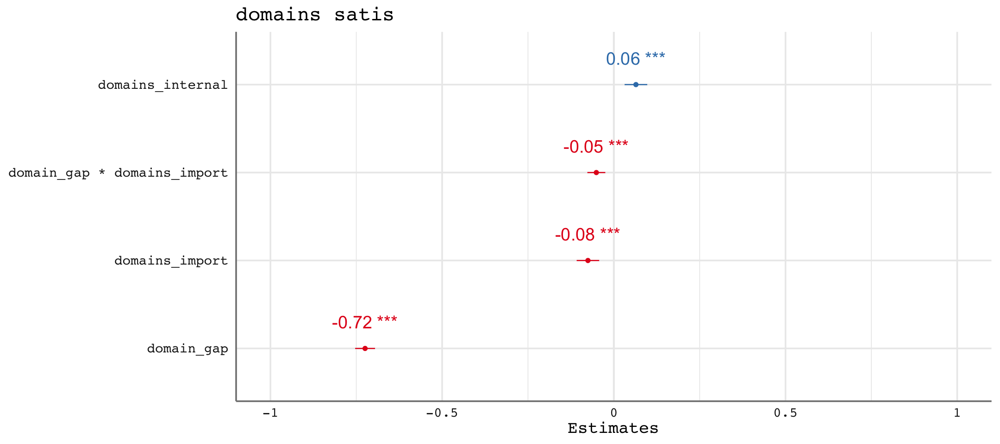

In [645]:
options(repr.plot.width = 18, repr.plot.height = 8)
plot_model(m, type = "std", sort.est = TRUE, show.values = TRUE, value.offset = .3, value.size = 8) + theme_sjplot2(base_size = 22, base_family = "Courier")


In [195]:
sjPlot::tab_model(m)

### Bayesian Estimate


SAMPLING FOR MODEL 'continuous' NOW (CHAIN 1).
Chain 1: 
Chain 1: Gradient evaluation took 2.5e-05 seconds
Chain 1: 1000 transitions using 10 leapfrog steps per transition would take 0.25 seconds.
Chain 1: Adjust your expectations accordingly!
Chain 1: 
Chain 1: 
Chain 1: Iteration:    1 / 2000 [  0%]  (Warmup)
Chain 1: Iteration:  200 / 2000 [ 10%]  (Warmup)
Chain 1: Iteration:  400 / 2000 [ 20%]  (Warmup)
Chain 1: Iteration:  600 / 2000 [ 30%]  (Warmup)
Chain 1: Iteration:  800 / 2000 [ 40%]  (Warmup)
Chain 1: Iteration: 1000 / 2000 [ 50%]  (Warmup)
Chain 1: Iteration: 1001 / 2000 [ 50%]  (Sampling)
Chain 1: Iteration: 1200 / 2000 [ 60%]  (Sampling)
Chain 1: Iteration: 1400 / 2000 [ 70%]  (Sampling)
Chain 1: Iteration: 1600 / 2000 [ 80%]  (Sampling)
Chain 1: Iteration: 1800 / 2000 [ 90%]  (Sampling)
Chain 1: Iteration: 2000 / 2000 [100%]  (Sampling)
Chain 1: 
Chain 1:  Elapsed Time: 0.175013 seconds (Warm-up)
Chain 1:                0.415972 seconds (Sampling)
Chain 1:              

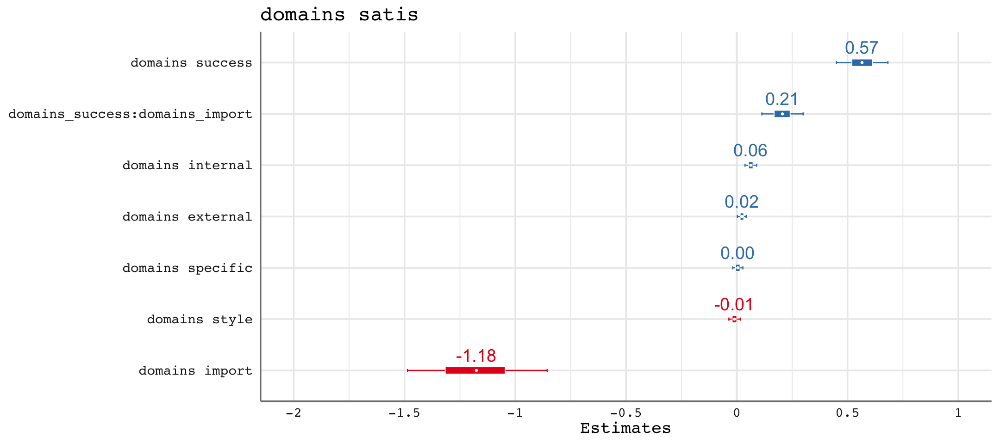

In [202]:
if (require("rstanarm", quietly = TRUE)) {
  # make sure we apply a nice theme
  theme_set(theme_sjplot2(base_size = 22, base_family = "Courier"))
  
  m <- stan_glm(domains_satis ~ domains_internal + domains_external + domains_specific + domains_style + domains_success*domains_import,
                data = scaled_domains_long,
                chains = 1)
  
  # default model
  plot_model(m)
  # same model, with mean point estimate, dot-style for point estimate
  # and different inner/outer probabilities of the HDI
  plot_model(
    m, 
    bpe = "mean",
    bpe.style = "dot",
    prob.inner = .5,
    prob.outer = .9,
      sort.est = TRUE, show.values = TRUE, value.offset = .3, value.size = 8
  )
}

---

** Note to self:** Can create formatted tables of model results using `sjPlot`

```sjPlot:: tab_model(m)```

More info at [link](https://lmudge13.github.io/sample_code/mixed_effects.html)

---

## Life Outcomes

Can we see any associations between life outcomes and the intention behavior gap?

In [591]:
print(names(demographics))

 [1] "subjectID"            "StartDate"            "LocationLatitude"    
 [4] "LocationLongitude"    "gender"               "age"                 
 [7] "education"            "ethnicity"            "father_education"    
[10] "mother_education"     "marital_status"       "employment_status"   
[13] "children_1"           "income"               "parents_income"      
[16] "net_worth"            "parents_net_worth"    "housing_status"      
[19] "macarthur_sss"        "macarthur_sss_parent" "job"                 
[22] "accomplishments"      "weight"               "height"              
[25] "bmi"                  "sat_score"            "gre_score_verbal"    
[28] "gre_score_quant"      "gpa_highschool"       "gpa_undergrad"       


In [592]:
# loading google sheet where coding of accomplishments (1-7) is done
library(googlesheets4)

accomps = read_sheet("https://docs.google.com/spreadsheets/d/1NvRw00M79UANZkY0hGJ6A_E8IWg-pviysdbLOONZkYM/edit?usp=sharing")

Auto-refreshing stale OAuth token.

✔ Reading from Coding Accomplishments.

✔ Range Sheet1.



In [593]:
# add accomplishment score
# for now only one score (mine)
# once there are more after validating that they correlate we will average the scores

demographics$accomp_score = accomps$accomp_rate_1

In [89]:
demo_slx = demographics %>%
    as_tibble() %>%
    dplyr::select(macarthur_sss, macarthur_sss_parent, gpa_highschool, bmi, accomp_score) %>%
    lapply(as.numeric) %>%
    as_tibble() %>%
    mutate(subjectID = 1:length(qn_df$subjectID)) # add subject id

In [90]:
head(demo_slx, 3)

macarthur_sss,macarthur_sss_parent,gpa_highschool,bmi,accomp_score,subjectID
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
8,6,11,24.37878,NA,1
5,3,12,21.02642,NA,2
6,7,13,23.43164,NA,3


### Correlations

In [91]:
df = merge(x=ib_measures_df, y=demo_slx,
           by="subjectID", all.x=TRUE)

Warning message in sqrt(n - 2):
“NaNs produced”
Warning message in corr.test(r, adjust = adjust):
“Number of subjects must be greater than 3 to find confidence intervals.”
Warning message in sqrt(n[lower.tri(n)] - 3):
“NaNs produced”


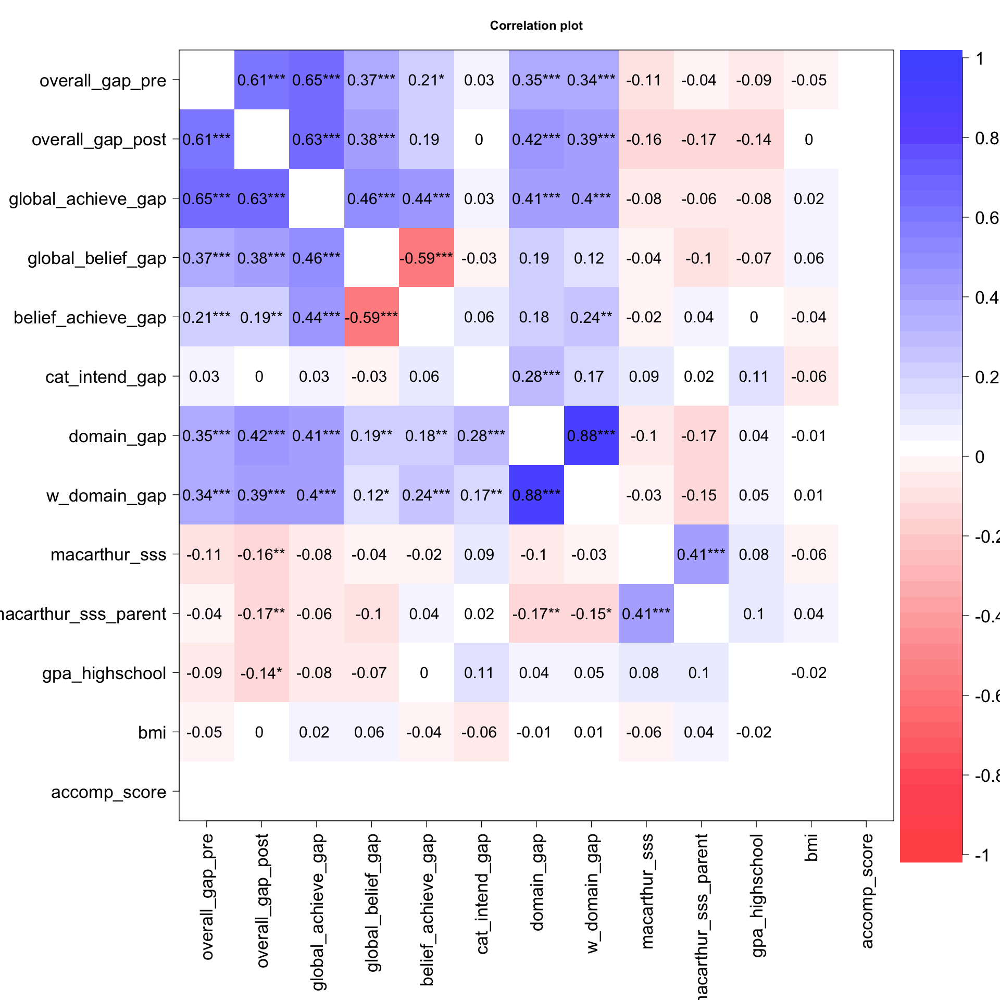

In [92]:
options(repr.plot.width = 16, repr.plot.height = 16)

cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 12”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 1”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  -0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 12”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 1”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  -0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 12”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 1”
Warning message in simpleLoess(y, x, w, span, degree = degr

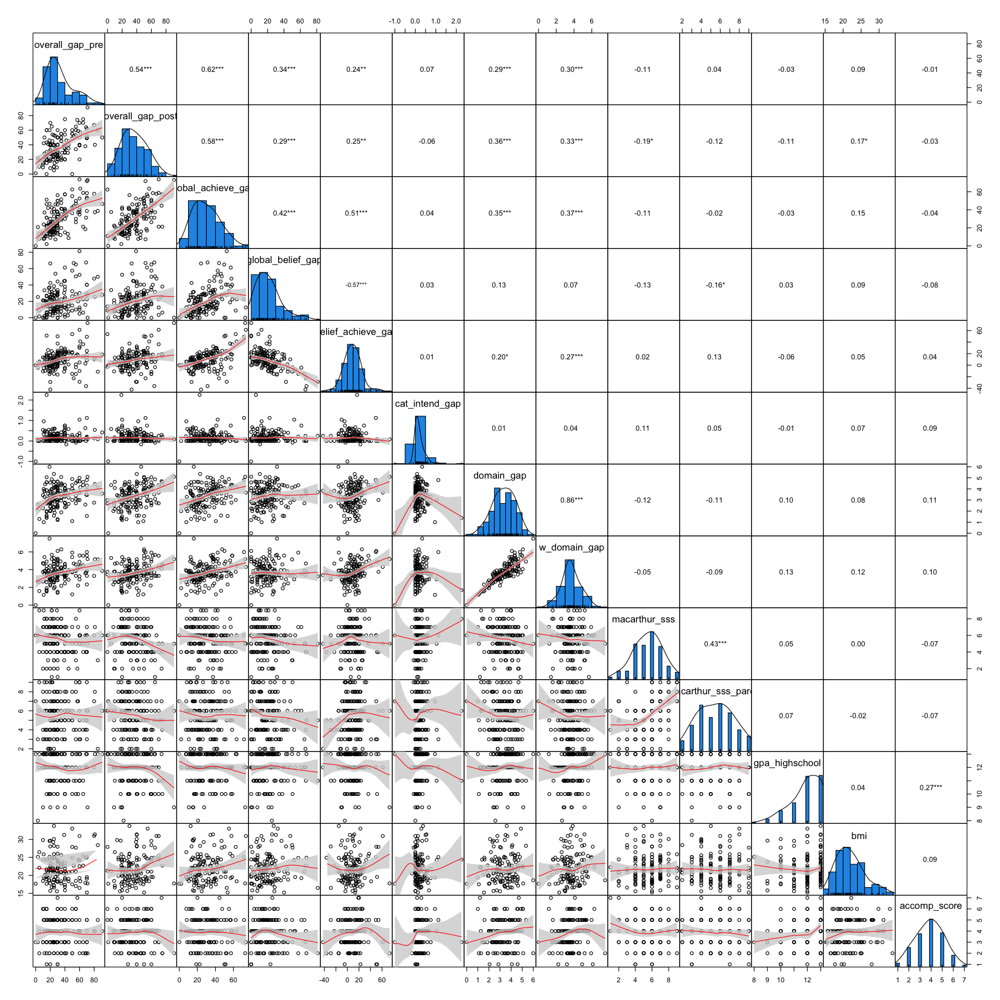

In [15]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

In [603]:
m <-lm(gpa_highschool ~ w_domain_gap, data = df)
summary(m)


Call:
lm(formula = gpa_highschool ~ w_domain_gap, data = df)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.7532 -0.8033  0.1737  1.0047  1.6052 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  11.39480    0.30866  36.917   <2e-16 ***
w_domain_gap  0.13548    0.08059   1.681   0.0948 .  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.127 on 154 degrees of freedom
Multiple R-squared:  0.01802,	Adjusted R-squared:  0.01164 
F-statistic: 2.826 on 1 and 154 DF,  p-value: 0.09477


## Goal Style

`plan_goal_select`

>**Planning | Goal Selection**
> 
>Do you agree with the statement:
>
> "It is easy for me to figure out which goal is most important to pursue at a given time."

 

 

In [93]:
goal_pheno = qn_df %>%
    as_tibble() %>%
    select(subjectID, starts_with('goals_'), contains('plan_')) %>%
    select(-contains('eisen')) %>%
    lapply(as.numeric) %>%
    as_tibble()

In [94]:
colnames(goal_pheno)<-gsub("_1","",colnames(goal_pheno))

In [95]:
head(goal_pheno, 3)

subjectID,goals_ambition,goals_pragmaticR,goals_variability,goals_conflic,plan_detailed,plan_variation,plan_goalnum,plan_goal_select,plan_goal_focus,plan_contingencies
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,7,6,5,5,6,6,7,7,6,4
2,3,4,5,6,2,2,3,1,1,1
3,3,2,4,6,6,2,5,5,3,4


### Correlations

In [98]:
df = merge(x=goal_pheno, y=dplyr::select(ib_measures_df, subjectID, domain_gap),
           by="subjectID", all.x=TRUE)

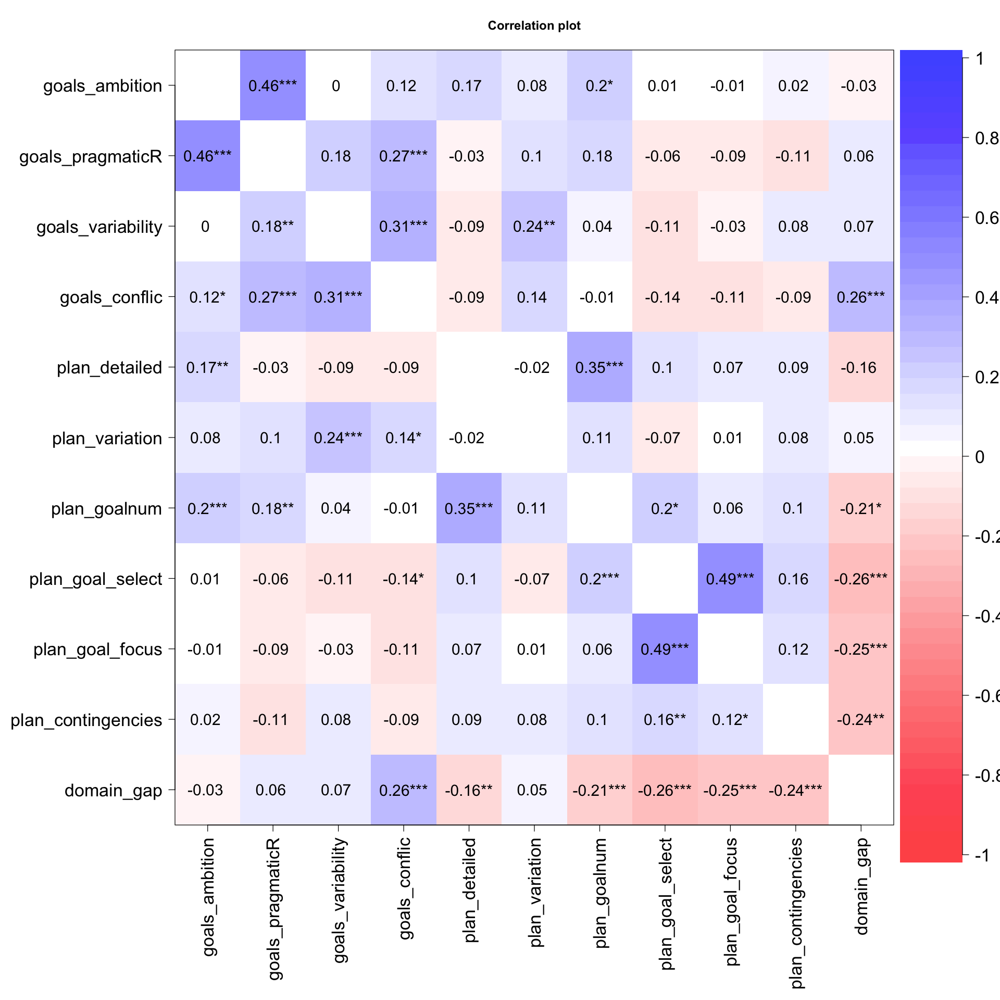

In [99]:
options(repr.plot.width = 16, repr.plot.height = 16)

cor.plot(df[,2:dim(df)[2]], cex = 1.5, xlas = 2, stars = TRUE, diag = FALSE, cex.axis = 1.7, MAR=11)

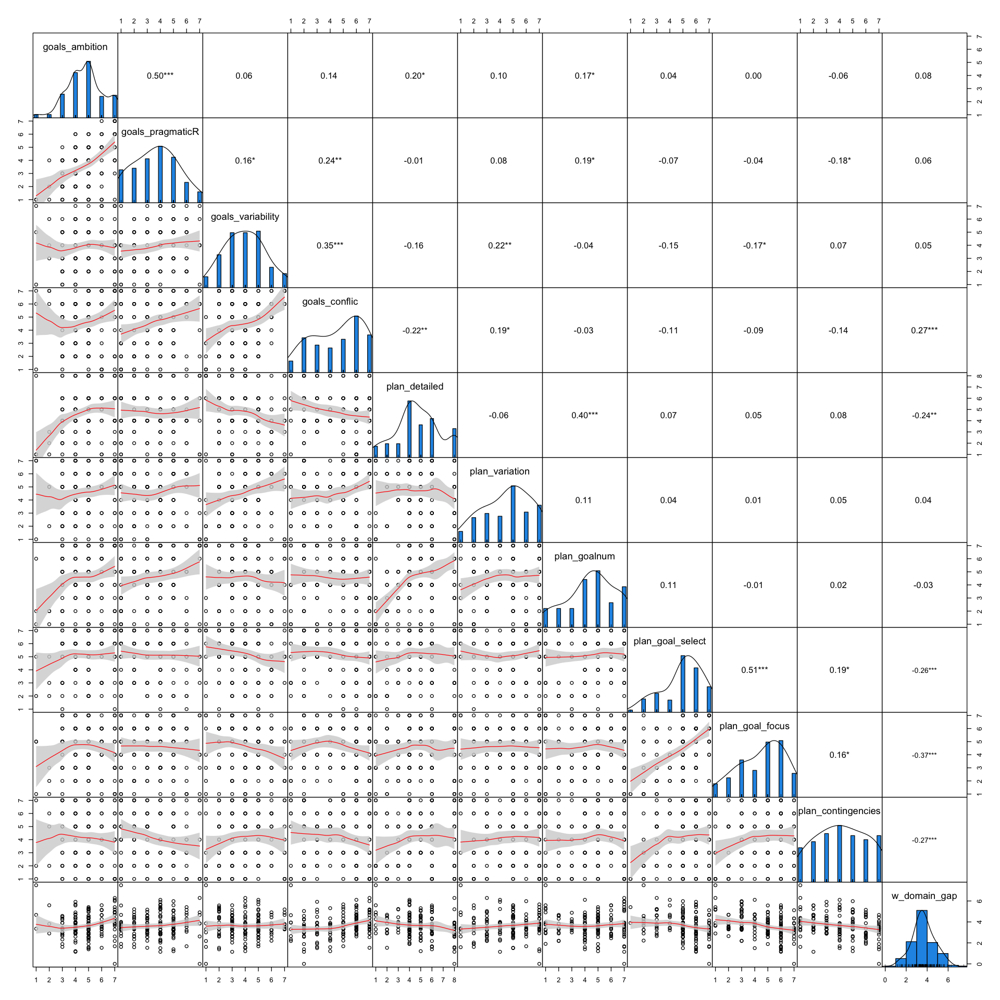

In [28]:
pairs.panels(df[,2:dim(df)[2]],
             smooth = TRUE,      # If TRUE, draws loess smooths
             scale = FALSE,      # If TRUE, scales the correlation text font
             density = TRUE,     # If TRUE, adds density plots and histograms
             ellipses = FALSE,    # If TRUE, draws ellipses
             method = "pearson", # Correlation method (also "spearman" or "kendall")
             pch = 21,           # pch symbol
             lm = FALSE,         # If TRUE, plots linear fit rather than the LOESS (smoothed) fit
             cor = TRUE,         # If TRUE, reports correlations
             jiggle = FALSE,     # If TRUE, data points are jittered
             factor = 2,         # Jittering factor
             hist.col = 4,       # Histograms color
             stars = TRUE,       # If TRUE, adds significance level with stars
             ci = TRUE,
             cex.labels=1.4,
            gap=0)          # If TRUE, adds confidence intervals

### Linear Model

In [29]:
colnames(df)

[1] "subjectID"          "goals_ambition"     "goals_pragmaticR"  
 [4] "goals_variability"  "goals_conflic"      "plan_detailed"     
 [7] "plan_variation"     "plan_goalnum"       "plan_goal_select"  
[10] "plan_goal_focus"    "plan_contingencies" "w_domain_gap"

In [41]:
m <- lm(w_domain_gap ~ goals_conflic + plan_detailed + plan_goal_focus + plan_contingencies,
        data = df)
summary(m)


Call:
lm(formula = w_domain_gap ~ goals_conflic + plan_detailed + plan_goal_focus + 
    plan_contingencies, data = df)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.2642 -0.6980 -0.0791  0.6217  2.7530 

Coefficients:
                   Estimate Std. Error t value Pr(>|t|)    
(Intercept)         5.06088    0.42038  12.039  < 2e-16 ***
goals_conflic       0.10379    0.04338   2.393   0.0180 *  
plan_detailed      -0.10106    0.04259  -2.373   0.0189 *  
plan_goal_focus    -0.20690    0.04726  -4.378 2.22e-05 ***
plan_contingencies -0.10969    0.04213  -2.604   0.0101 *  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.9835 on 151 degrees of freedom
Multiple R-squared:  0.2531,	Adjusted R-squared:  0.2333 
F-statistic: 12.79 on 4 and 151 DF,  p-value: 5.45e-09


In [38]:
glance(m) %>%
    select(AIC, BIC)

AIC,BIC
<dbl>,<dbl>
446.2636,467.6126


In [30]:
m <- lm(w_domain_gap ~ goals_ambition + goals_pragmaticR + goals_variability + goals_conflic + plan_detailed + plan_variation + plan_goalnum + plan_goal_select + plan_goal_focus + plan_contingencies,
        data = df)
summary(m)


Call:
lm(formula = w_domain_gap ~ goals_ambition + goals_pragmaticR + 
    goals_variability + goals_conflic + plan_detailed + plan_variation + 
    plan_goalnum + plan_goal_select + plan_goal_focus + plan_contingencies, 
    data = df)

Residuals:
     Min       1Q   Median       3Q      Max 
-2.71975 -0.55768 -0.09925  0.60757  2.76416 

Coefficients:
                    Estimate Std. Error t value Pr(>|t|)    
(Intercept)         5.147991   0.543803   9.467  < 2e-16 ***
goals_ambition      0.112006   0.069867   1.603 0.111081    
goals_pragmaticR   -0.068818   0.058564  -1.175 0.241886    
goals_variability  -0.070963   0.058989  -1.203 0.230937    
goals_conflic       0.116588   0.047379   2.461 0.015040 *  
plan_detailed      -0.139241   0.048427  -2.875 0.004645 ** 
plan_variation      0.005133   0.046708   0.110 0.912651    
plan_goalnum        0.045805   0.050230   0.912 0.363339    
plan_goal_select   -0.060325   0.062837  -0.960 0.338642    
plan_goal_focus    -0.190985   0.

In [31]:
glance(m) %>%
    select(AIC, BIC)

AIC,BIC
<dbl>,<dbl>
450.6531,487.2513


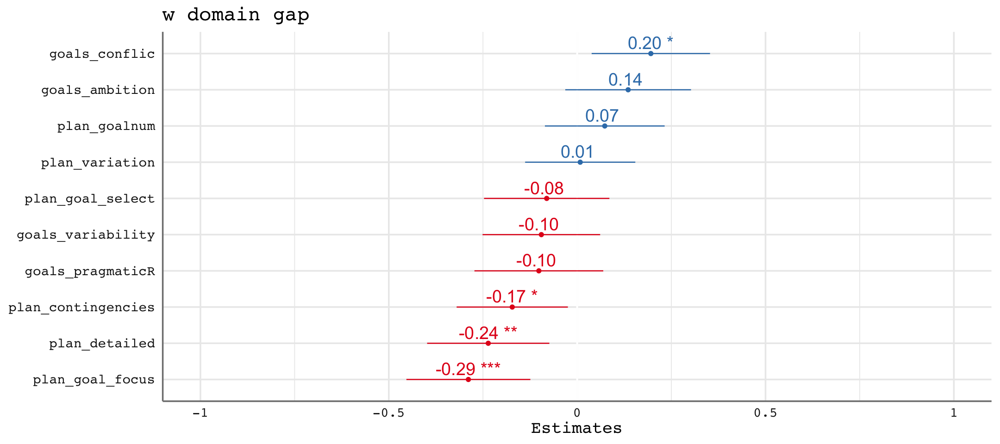

In [32]:
options(repr.plot.width = 18, repr.plot.height = 8)
plot_model(m, type = "std", sort.est = TRUE, show.values = TRUE, value.offset = .3, value.size = 8) + theme_sjplot2(base_size = 22, base_family = "Courier")


In [195]:
sjPlot::tab_model(m)

### Bayesian Estimate


SAMPLING FOR MODEL 'continuous' NOW (CHAIN 1).
Chain 1: 
Chain 1: Gradient evaluation took 0.000272 seconds
Chain 1: 1000 transitions using 10 leapfrog steps per transition would take 2.72 seconds.
Chain 1: Adjust your expectations accordingly!
Chain 1: 
Chain 1: 
Chain 1: Iteration:    1 / 2000 [  0%]  (Warmup)
Chain 1: Iteration:  200 / 2000 [ 10%]  (Warmup)
Chain 1: Iteration:  400 / 2000 [ 20%]  (Warmup)
Chain 1: Iteration:  600 / 2000 [ 30%]  (Warmup)
Chain 1: Iteration:  800 / 2000 [ 40%]  (Warmup)
Chain 1: Iteration: 1000 / 2000 [ 50%]  (Warmup)
Chain 1: Iteration: 1001 / 2000 [ 50%]  (Sampling)
Chain 1: Iteration: 1200 / 2000 [ 60%]  (Sampling)
Chain 1: Iteration: 1400 / 2000 [ 70%]  (Sampling)
Chain 1: Iteration: 1600 / 2000 [ 80%]  (Sampling)
Chain 1: Iteration: 1800 / 2000 [ 90%]  (Sampling)
Chain 1: Iteration: 2000 / 2000 [100%]  (Sampling)
Chain 1: 
Chain 1:  Elapsed Time: 0.068987 seconds (Warm-up)
Chain 1:                0.087621 seconds (Sampling)
Chain 1:             

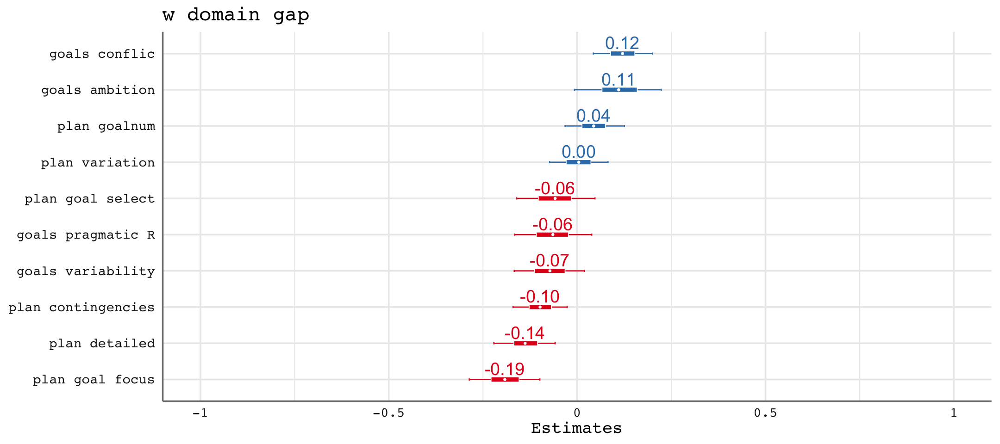

In [42]:
if (require("rstanarm", quietly = TRUE)) {
  # make sure we apply a nice theme
  theme_set(theme_sjplot2(base_size = 22, base_family = "Courier"))
  
  m <- stan_glm(w_domain_gap ~ goals_ambition + goals_pragmaticR + goals_variability + goals_conflic + plan_detailed + plan_variation + plan_goalnum + plan_goal_select + plan_goal_focus + plan_contingencies,
                data = df,
                chains = 1)
  
  # default model
  plot_model(m)
  # same model, with mean point estimate, dot-style for point estimate
  # and different inner/outer probabilities of the HDI
  plot_model(
      m, 
      bpe = "mean",
      bpe.style = "dot",
      prob.inner = .5,
      prob.outer = .9,
      sort.est = TRUE, show.values = TRUE, value.offset = .3, value.size = 8
  )
}

### Clustering

In [650]:
library(cluster)

In [652]:
analysis_data = df %>%
  column_to_rownames("subjectID") # This converts the varietals column to rownames so it won't interfere with analyses but will label cases

In [655]:
#=== Example 9.2: Create a Distance Matrix ====
#Create and View a Distance Matrix using a Squared Euclidean Distance measure
distance_matrix = analysis_data %>%
  dist(method="euclidean") %>% # This line creates the distance matrix
  .**2 # This squares every value in the distance matrix

In [656]:
#=== Example 9.3: Run a Hierarchical Cluster Analysis ====
#Conduct an agglomerative hierarchical cluster analysis using Ward's Method
hierarchical_cluster = distance_matrix %>%
  hclust(method="ward.D")

,step,cluster.1,cluster.2,distance
,<dbl>,<dbl>,<dbl>,<dbl>
1,1,-82,-120,5.31
2,2,-5,-59,5.45
3,3,-15,-141,6.08
4,4,-20,-67,6.26
5,5,-107,-112,7.15
6,6,-22,-153,7.20


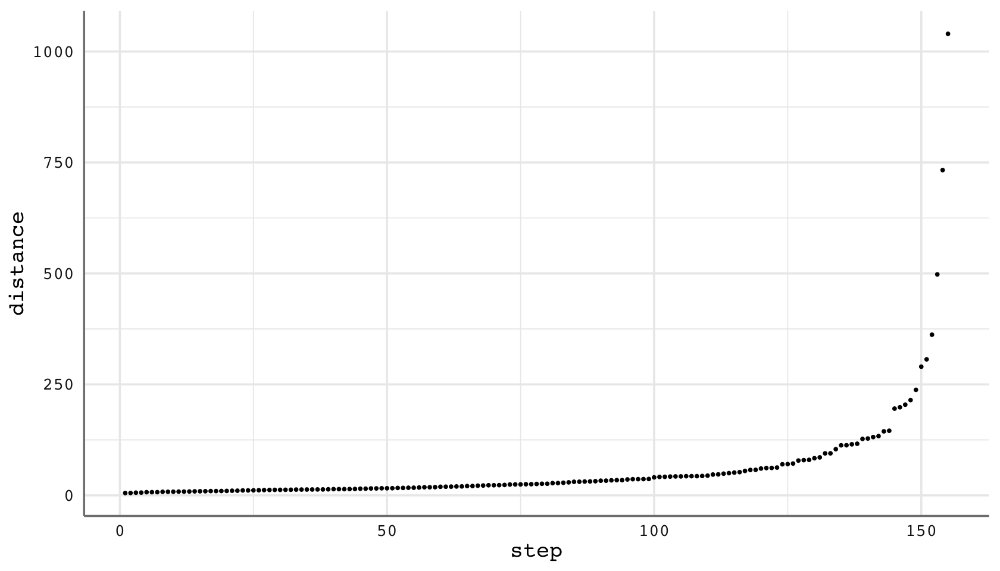

In [659]:
#=== Example 9.4: Evaluate Agglomeration Tables and Plots ====
#Print a table similar to an Agglomeration Schedule
agglomeration_schedule = data.frame(step     = 1:length(hierarchical_cluster$height), # Make step an explicit column
                                    cluster  = hierarchical_cluster$merge, 
                                    distance = hierarchical_cluster$height) %>% # Create a data frame from values in the hierarchical cluster results
  round(2) # Make the distances a bit more human-readable (at least easier to read, for me)

# View Agglomeration Schedule
agglomeration_schedule %>%
  head()

#Print a reversed Scree plot
options(repr.plot.width = 14, repr.plot.height = 8)
agglomeration_schedule %>%
  ggplot(aes(x = step, y = distance)) + 
  geom_point()

In [666]:
#=== Example 9.5: Save Cluster Memberships ====
# Note, in this example, we've decided to use 4 clusters
dataset = df %>%
  cbind(clusters = cutree(hierarchical_cluster, k=3))

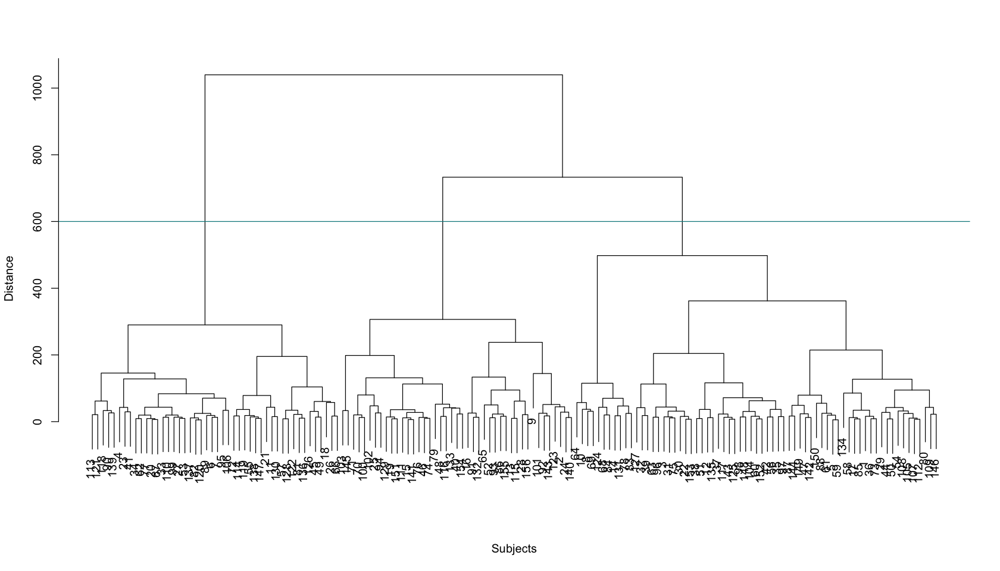

In [667]:
#=== Example 9.6: Create a Visualization ====
hierarchical_cluster %>%
  plot(xlab="Subjects", main = "", sub = "", ylab = "Distance")
abline(h=600, col="turquoise4")

In [669]:
print(colnames(df))

 [1] "subjectID"          "goals_ambition"     "goals_pragmaticR"  
 [4] "goals_variability"  "goals_conflic"      "plan_detailed"     
 [7] "plan_variation"     "plan_goalnum"       "plan_goal_select"  
[10] "plan_goal_focus"    "plan_contingencies" "w_domain_gap"      


In [675]:
#=== Example 9.7: K-Means Cluster Analysis ====
# First, use your hierarchically derived clusters to export starting centres for K-Means
hierarchical_centres = dataset %>%
  group_by(clusters) %>%
  summarize(ambition_mean = mean(goals_ambition),
            pragmaticR_mean   = mean(goals_pragmaticR),
            variability_mean   = mean(goals_variability),
            conflict_mean = mean(goals_conflic),
            detailed_mean   = mean(plan_detailed),
            variation_mean   = mean(plan_variation),
            goalnum_mean = mean(plan_goalnum),
            prioritize_mean   = mean(plan_goal_select),
            focus1_mean   = mean(plan_goal_focus),
            contingencies_mean   = mean(plan_contingencies),
            w_domain_gap_mean   = mean(w_domain_gap)
           ) %>%
  dplyr::select(ambition_mean, 
                pragmaticR_mean, 
                variability_mean,
                conflict_mean,
                detailed_mean,
                variation_mean,
                goalnum_mean,
                prioritize_mean,
                focus1_mean,
                contingencies_mean,
                w_domain_gap_mean)

In [676]:
hierarchical_centres

ambition_mean,pragmaticR_mean,variability_mean,conflict_mean,detailed_mean,variation_mean,goalnum_mean,prioritize_mean,focus1_mean,contingencies_mean,w_domain_gap_mean
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
4.970149,4.014925,3.850746,5.074627,4.955224,4.925373,5.641791,5.268657,4.626866,3.537313,3.856929
4.395349,3.767442,4.860465,5.465116,3.418605,4.581395,3.046512,3.906977,3.488372,3.697674,4.044965
4.652174,2.913043,3.217391,2.978261,5.760870,3.956522,4.217391,5.565217,5.369565,5.369565,3.022831


In [677]:
# Next, use hierarchically derived cluster means as start values to k-means
kmeans_cluster = analysis_data %>%
  kmeans(hierarchical_centres, iter.max = 100, algorithm="MacQueen")

# Examine the descriptive stats for each cluster
kmeans_cluster$centers %>%
  print

  goals_ambition goals_pragmaticR goals_variability goals_conflic plan_detailed
1       5.372881         4.406780          4.389831      5.847458      4.983051
2       4.176471         3.705882          4.735294      5.205882      3.000000
3       4.396825         2.841270          3.095238      3.015873      5.523810
  plan_variation plan_goalnum plan_goal_select plan_goal_focus
1       5.305085     5.491525         5.152542        4.457627
2       4.441176     2.588235         3.676471        3.558824
3       3.888889     4.619048         5.523810        5.126984
  plan_contingencies w_domain_gap
1           4.000000     3.980822
2           3.205882     3.940067
3           4.730159     3.215352


In [686]:
#=== Example 9.8: K-Medoids Cluster Analysis ====
kmedoids_cluster = analysis_data %>%
  pam(3) # specify number of clusters

# See the cluster assignments
analysis_data %>%
  cbind(kmedoids_cluster$clustering)
# See the medoids
## Note, they are ordered by cluster number (i.e., row 1 == Cluster 1, ...))
analysis_data %>%
  rownames_to_column("Varietal") %>%
  slice(kmedoids_cluster$id.med)

,goals_ambition,goals_pragmaticR,goals_variability,goals_conflic,plan_detailed,plan_variation,plan_goalnum,plan_goal_select,plan_goal_focus,plan_contingencies,w_domain_gap,kmedoids_cluster$clustering
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,7,6,5,5,6,6,7,7,6,4,1.680000,1
2,3,4,5,6,2,2,3,1,1,1,3.900000,2
3,3,2,4,6,6,2,5,5,3,4,3.288462,2
4,6,6,2,1,8,2,1,7,6,1,3.937500,3
5,5,4,3,7,5,5,5,6,5,3,2.914773,1
6,4,1,3,3,4,2,5,7,6,4,3.196429,3
7,5,2,4,3,6,3,5,6,6,5,4.935000,3
8,7,6,2,5,6,7,5,1,1,1,5.410714,2
9,1,1,1,1,1,1,1,2,1,1,7.500000,3


Varietal,goals_ambition,goals_pragmaticR,goals_variability,goals_conflic,plan_detailed,plan_variation,plan_goalnum,plan_goal_select,plan_goal_focus,plan_contingencies,w_domain_gap
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
27,5,3,3,5,5,5,5,5,5,5,2.558824
19,5,4,4,6,5,5,5,4,3,3,4.575000
20,4,4,4,3,4,4,4,5,5,4,3.000000


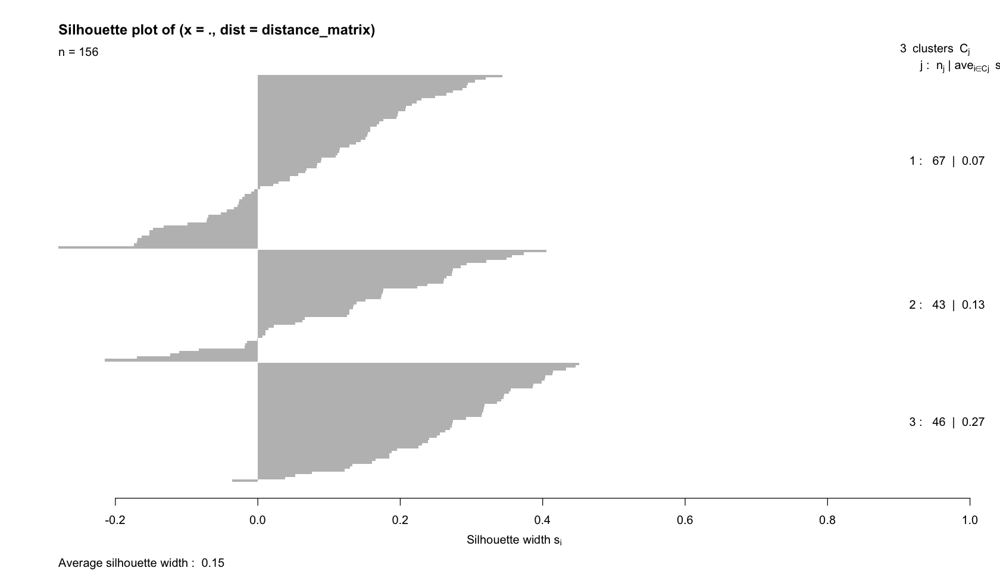

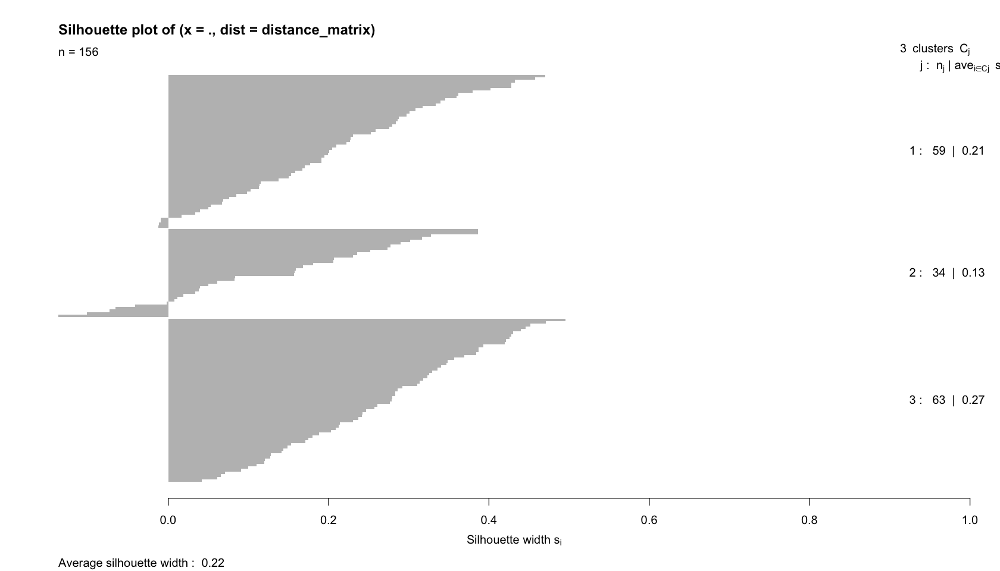

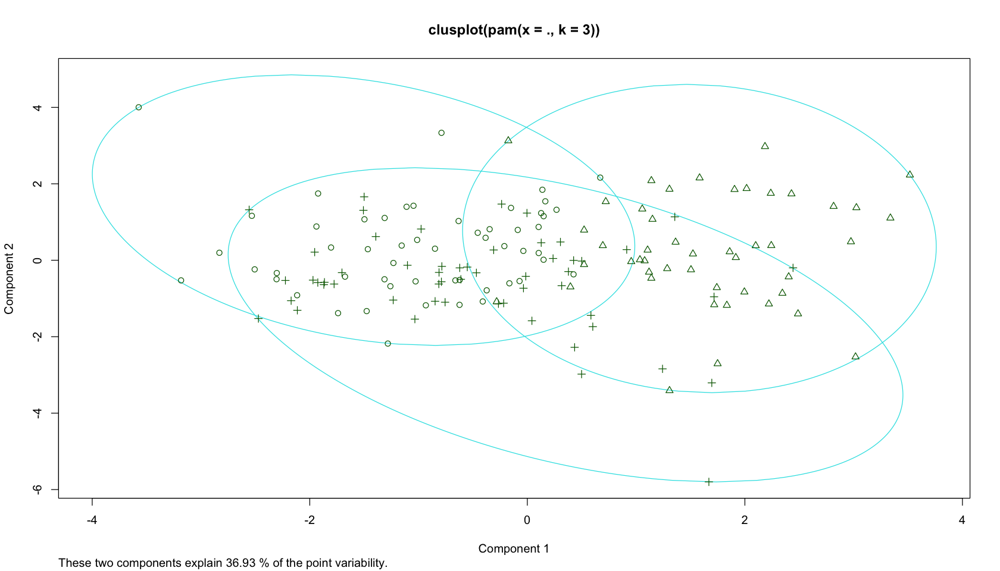

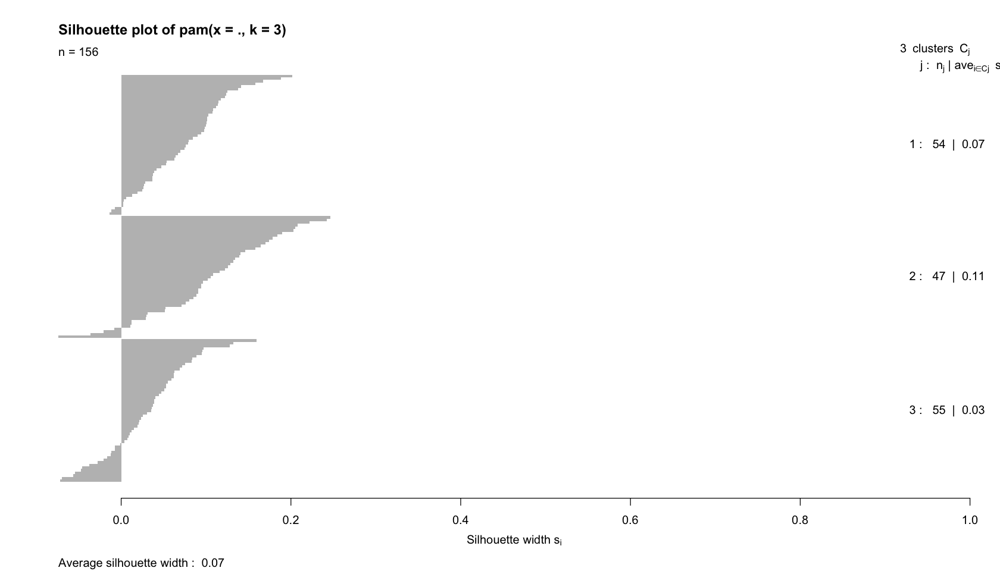

In [687]:
#=== Example 9.9: Evaluating Cluster Structure With Silhouette Statistics ====
# For hierarchical cluster analysis
hierarchical_cluster %>% 
  cutree(k=3) %>% 
  silhouette(distance_matrix) %>% 
  plot

# For k-means cluster analysis
kmeans_cluster$cluster %>%
  silhouette(distance_matrix) %>%
  plot

# For k-medoids
kmedoids_cluster %>%
  plot

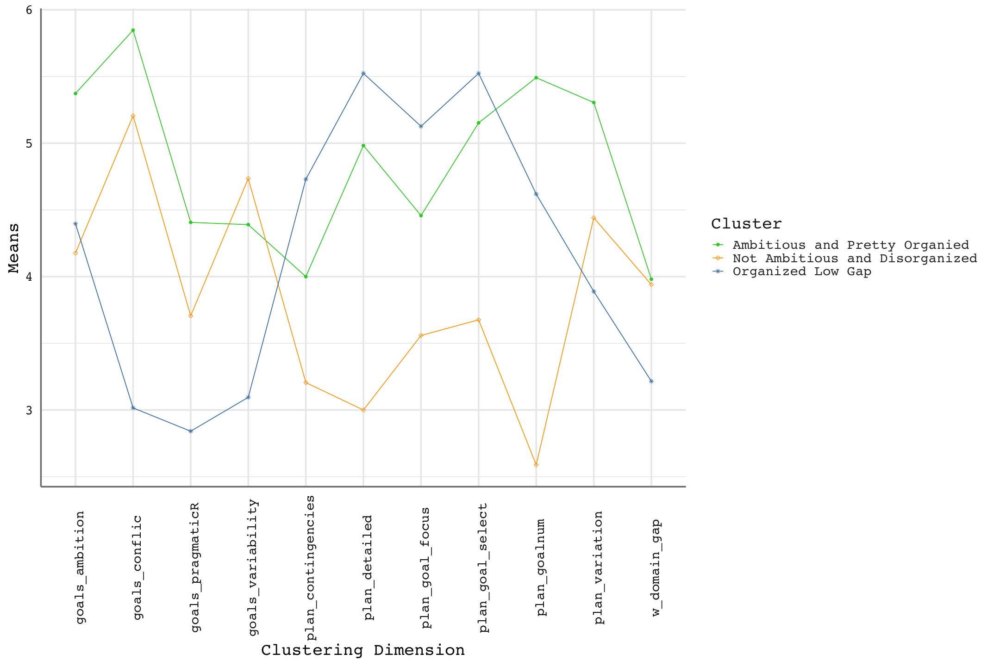

In [696]:
options(repr.plot.width = 18, repr.plot.height = 12)


#=== Example 9.10: Visualizing and Naming Clusters ====
# Create plot of the centres
kmeans_cluster$centers %>%
  as_tibble %>% # The cluster centres are in a matrix by default, so ggplot will need it to be a data frame or tibble
  rownames_to_column("Cluster") %>% # This will provide labels for the clusters
  gather(key = "Clustering Dimension", value = "Means", -Cluster) %>% # This transforms the data into "long form" (think back to MLM Lecture)
  ggplot(aes(x=`Clustering Dimension`, y = Means, group = Cluster, colour = Cluster, shape = Cluster)) + # Call to ggplot
  geom_point() + # Add points
theme(axis.text.x = element_text(angle = 90)) +
  scale_shape_manual(labels = c("Ambitious and Pretty Organied", "Not Ambitious and Disorganized", "Organized Low Gap"),
                     values = c(19, 5, 8)) + # Use some custom point shapes -- this is totally unnecessary
  geom_line() + # Add lines
  scale_color_manual(labels = c("Ambitious and Pretty Organied", "Not Ambitious and Disorganized", "Organized Low Gap"),
                     values = c("limegreen", "orange", "steelblue")) # Use some custom colours -- this is totally unnecessary


# Clustering

## Goal Style

Looking at `plan_` and `goal_` elements

Do people cluster together?

How do clusters relate to the gap?

### Clustering By Subject

## Goal Domains

In [ ]:
# Are there specific domains where gap is more related to self-esteem, subjective well being...
# go domain by domain
# how do domains relate to each other?
# better in family domain worse in exercise?? etc...
# factor analysis of domains

In [249]:
# create df
df = merge(x=scaled_domains_long, y=validation_measures ,
           by="subjectID", all.x=TRUE)

In [250]:
for (i in 1:32) {
    m = lm(swl_cantril_ladder ~ w_domain_gap, data = df[df$domain_num==i,])
    print(paste0(df[df$domain_num==i,]$domain_names[1], ': ', round(summary(m)$coefficients[2,4],3)))
}

[1] "Diet: 0.002"
[1] "Exercise: 0.01"
[1] "Mental Health/Personal Care: 0.068"
[1] "Medical health (doctor/dentist checkups, screenings, safe sex, etc.): 0.295"
[1] "Sleep: 0.087"
[1] "Alcohol/drug consumption: 0.951"
[1] "Time spent online (non-work related, not social media): 0.667"
[1] "Time on phone (non-work related): 0.503"
[1] "Playing video games: 0.4"
[1] "Reading: 0.139"
[1] "Social Media: 0.346"
[1] "Sports (playing): 0.843"
[1] "Watching TV/Streaming: 0.131"
[1] "Relationship with family: 0.233"
[1] "Relationships with close friends: 0.068"
[1] "Relationship with partner: 0.584"
[1] "Social life: 0.011"
[1] "Cleaning: 0.842"
[1] "Housework (non-cleaning): 0.581"
[1] "Cooking/preparing meals: 0.42"
[1] "Schoolwork or Job (includes homemaker): 0.057"
[1] "Pro-environmental behavior: 0.296"
[1] "Cultural activities: 0.527"
[1] "Learning for fun: 0.215"
[1] "Self-Improvement: 0.002"
[1] "Volunteering: 0.772"
[1] "Community involvement: 0.721"
[1] "Administrative work (taxes, b

In [251]:
for (i in 1:32) {
    m = lm(self_esteem_single_1 ~ w_domain_gap, data = df[df$domain_num==i,])
    print(paste0(df[df$domain_num==i,]$domain_names[1], ': ', round(summary(m)$coefficients[2,4],3)))

}

[1] "Diet: 0.042"
[1] "Exercise: 0"
[1] "Mental Health/Personal Care: 0"
[1] "Medical health (doctor/dentist checkups, screenings, safe sex, etc.): 0.022"
[1] "Sleep: 0"
[1] "Alcohol/drug consumption: 0.058"
[1] "Time spent online (non-work related, not social media): 0.005"
[1] "Time on phone (non-work related): 0.029"
[1] "Playing video games: 0.166"
[1] "Reading: 0.234"
[1] "Social Media: 0.078"
[1] "Sports (playing): 0.001"
[1] "Watching TV/Streaming: 0.365"
[1] "Relationship with family: 0.007"
[1] "Relationships with close friends: 0.167"
[1] "Relationship with partner: 0.086"
[1] "Social life: 0.006"
[1] "Cleaning: 0.498"
[1] "Housework (non-cleaning): 0.968"
[1] "Cooking/preparing meals: 0.494"
[1] "Schoolwork or Job (includes homemaker): 0"
[1] "Pro-environmental behavior: 0.181"
[1] "Cultural activities: 0.389"
[1] "Learning for fun: 0.091"
[1] "Self-Improvement: 0"
[1] "Volunteering: 0.008"
[1] "Community involvement: 0.023"
[1] "Administrative work (taxes, banking, etc.): 0

### Correlation of Weighted Domain Gaps

In [254]:
# Create wide DF
df_wide = df %>%
    as_tibble() %>%
    select(subjectID, domain_names_short, w_domain_gap, swl_cantril_ladder, self_esteem_single_1) %>%
    spread(domain_names_short, w_domain_gap)

In [327]:
# rename cols for legibility
df_wide = df_wide %>%
    rename("SWL" = "swl_cantril_ladder",
           "Self Esteem" = "self_esteem_single_1"
          )

In [255]:
head(df_wide, 3)

subjectID,swl_cantril_ladder,self_esteem_single_1,Admin,Alcohol/drug,Cleaning,Community involvement,Cooking,Culture,Diet,⋯,Self-Improvement,Sleep,Social life,Social Media,Sports,Time Management,TV/Streaming,Video games,Volunteering,Work
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,9,6,NA,1.5,4.5,NA,NA,2.25,1.875,⋯,3.75,1.50,1.875,3.0,NA,NA,1.875,NA,2.25,1.875
2,5,2,NA,NA,NA,NA,NA,NA,NA,⋯,NA,NA,6.750,NA,NA,NA,NA,NA,NA,NA
3,6,2,NA,NA,3.0,1.875,1.5,NA,2.250,⋯,3.75,2.25,3.750,4.5,4.5,NA,4.500,4.5,3.75,1.875


In [358]:
dim(df_wide)

[1] 151  35

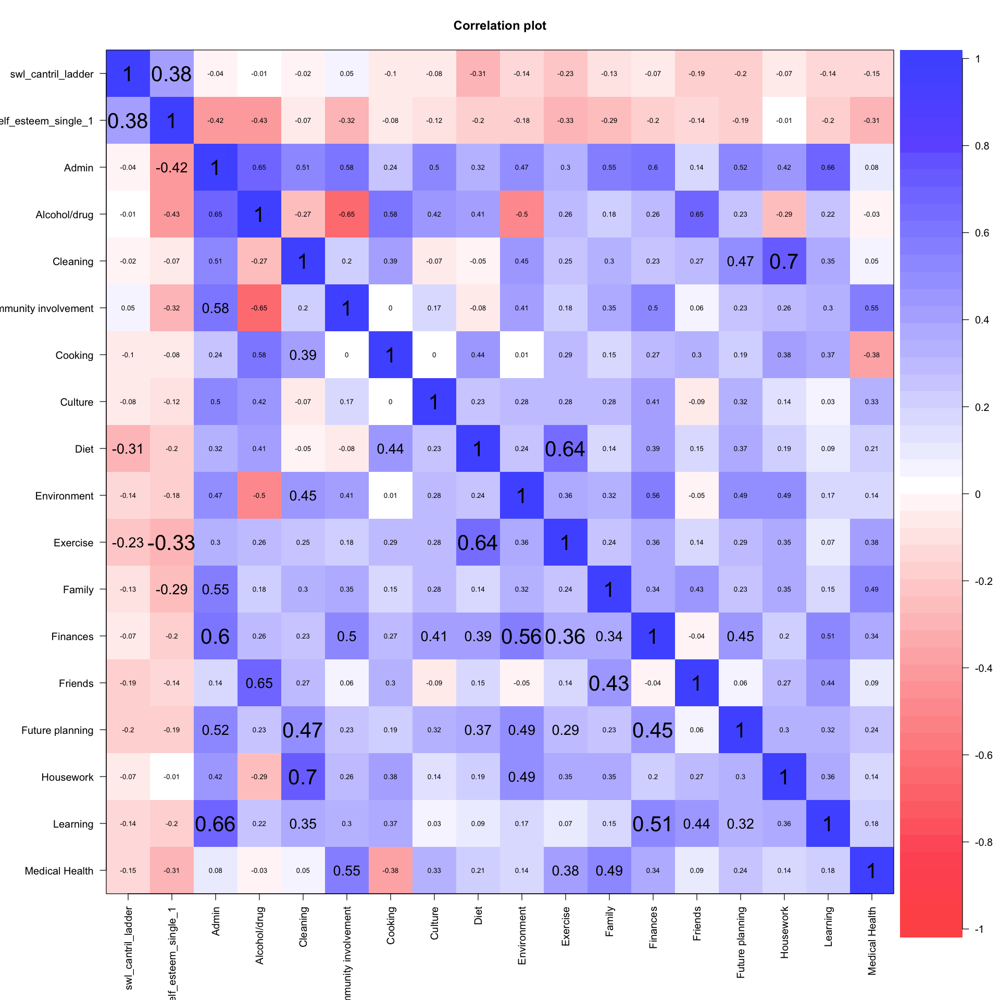

In [281]:
# set plot size
options(repr.plot.width = 16, repr.plot.height = 16)

cor.plot(df_wide[,2:19], cex = 1.35, xlas = 2)

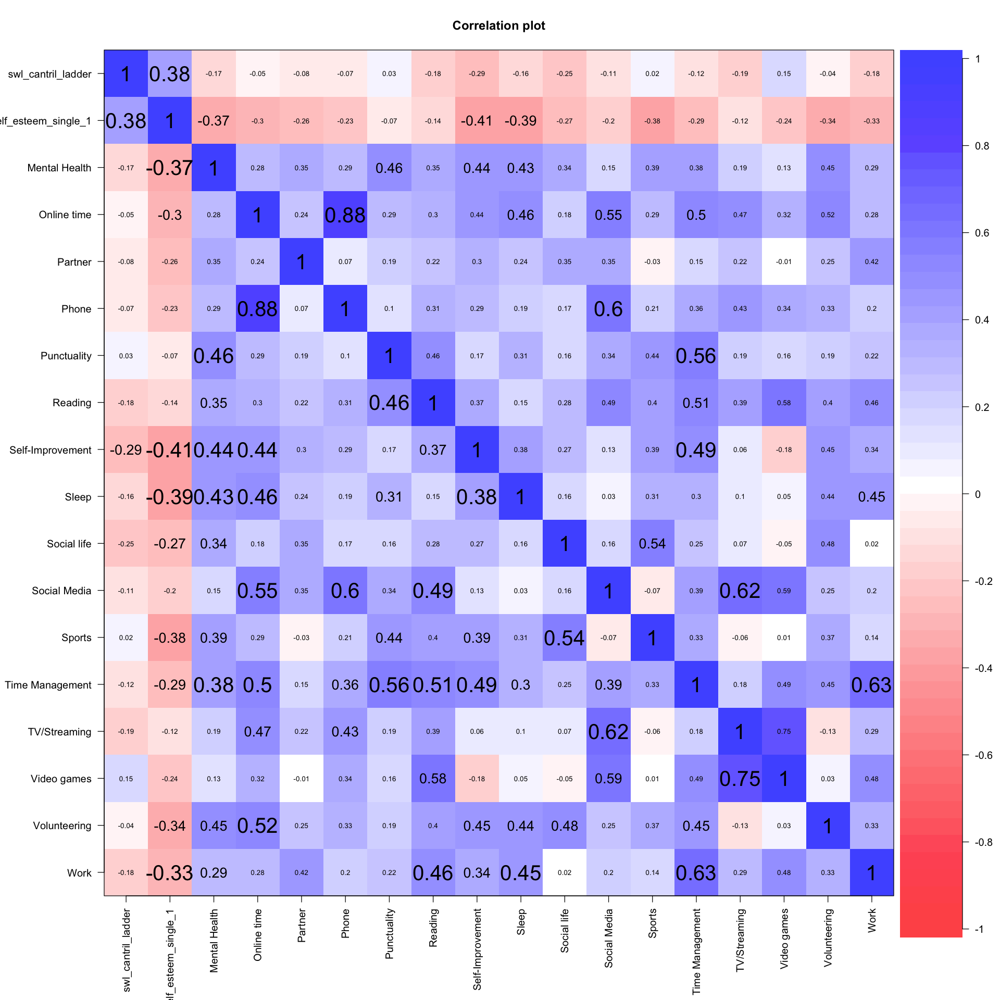

In [280]:
cor.plot(df_wide[,c(2:3,20:35)], cex = 1.35, xlas = 2)

#### Item-Item Correlations (+ SWL/Self Esteem)

In [374]:
# use pairwise.complete.obs since it is a sparse matrix with NAs in some domains for each subject
item_item = cor(df_wide[,4:35], use="pairwise.complete.obs")

In [423]:
item = list()
threshold = list()

for (i in 1:32) {
    item[i] = names(item_item[i,][i])
    threshold[i] = sum(item_item[i,]> 0.3 | item_item[i,]< -0.3)   
#    print(paste0(item, ': ', threshold, ' correlations > |.3|'))
}

# create item-item df
df = data.frame(item = unlist(item),
                threshold = unlist(threshold))

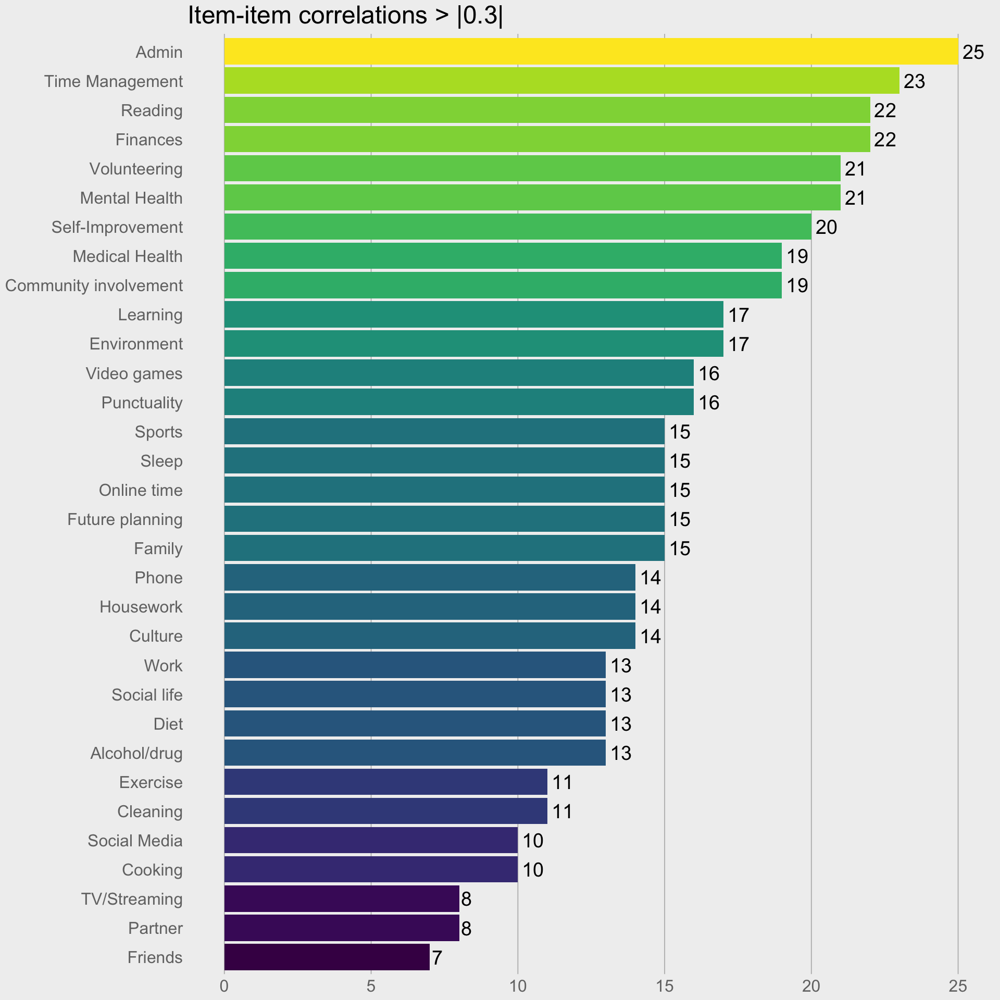

In [430]:
options(repr.plot.width = 16, repr.plot.height = 16)

ggplot(df, aes(x= reorder(item, threshold), y=threshold, fill = threshold)) +
    geom_bar(stat='identity') +
    geom_text(aes(label=threshold), hjust=-0.2, colour = "black", size=8) +
    ggtitle("Item-item correlations > |0.3|") +
    scale_fill_viridis() +
    coord_flip() +
    theme_538() +
    theme(text = element_text(size=24),
          axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          legend.position = "none"
         )

##### Largest Item-Item Correlations

In [328]:
library(regclass)

In [330]:
df = all_correlations(as.data.frame(df_wide[,2:dim(df_wide)[2]]), type="pearson", interest=NA, sorted="strength")
df$vars = paste0(df$var1, ' x ', df$var2)

In [334]:
head(df)

,var1,var2,correlation,pval,vars
,<chr>,<chr>,<dbl>,<dbl>,<chr>
1,Alcohol/drug,Community involvement,-0.6546412,0.110575805,Alcohol/drug x Community involvement
2,Cooking,Video games,-0.5567258,0.038654049,Cooking x Video games
3,Alcohol/drug,Environment,-0.5036358,0.203215263,Alcohol/drug x Environment
4,Alcohol/drug,Video games,-0.4883005,0.266220712,Alcohol/drug x Video games
5,Self Esteem,Alcohol/drug,-0.4311154,0.057722744,Self Esteem x Alcohol/drug
6,Self Esteem,Admin,-0.4246317,0.007878585,Self Esteem x Admin


In [772]:
cor(ib_measures_df$subjectID, ib_measures_df$w_domain_gap)

[1] -0.02431918

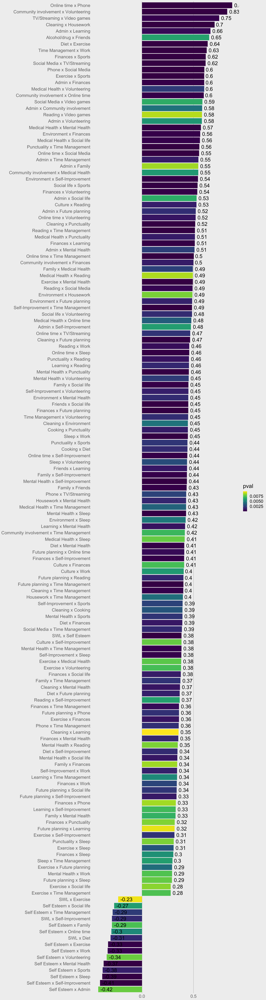

In [346]:
options(repr.plot.width = 16, repr.plot.height = 60)

ggplot(df[df$pval<0.01,], aes(x= reorder(vars, correlation), y=correlation, fill = pval)) +
    geom_bar(stat='identity') +
    geom_text(aes(label=round(correlation,2)), hjust=-0.2, colour = "black", size=8) +
    scale_fill_viridis() +
    coord_flip() +
    theme_538() +
    theme(text = element_text(size=24),
          axis.title.x = element_blank(),
          axis.title.y = element_blank())

#### Item-Total Correlation

In [433]:
# add the weighted gap (TOTAL)
df = merge(df_wide, select(ib_measures_df, subjectID, w_domain_gap), 
           by="subjectID")

In [434]:
# use pairwise.complete.obs since it is a sparse matrix with NAs in some domains for each subject
item_total = cor(df[,4:36], use="pairwise.complete.obs")

In [453]:
domains = row.names(as.data.frame(item_total))
cors = as.data.frame(item_total)[,33]

df = data.frame(domains, cors)

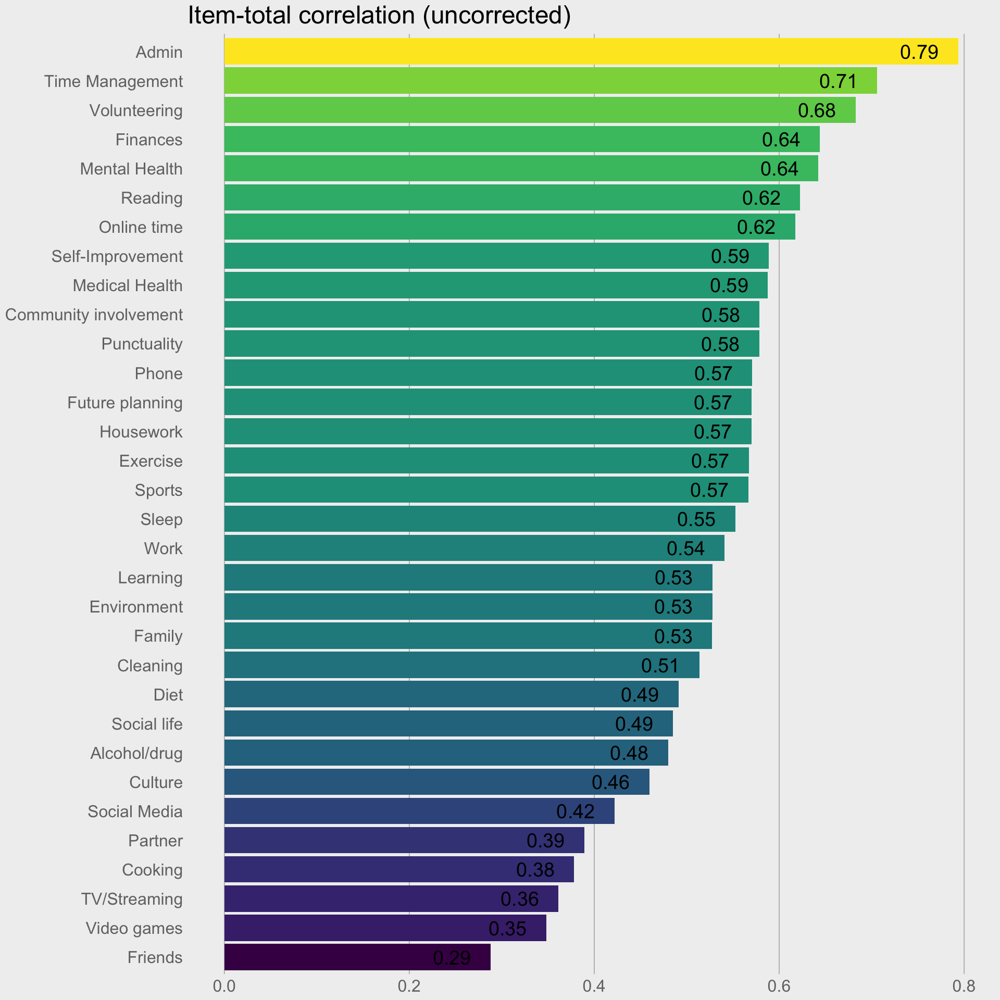

In [476]:
options(repr.plot.width = 16, repr.plot.height = 16)

ggplot(df[df$domains!='w_domain_gap',], aes(x= reorder(domains, cors), y=cors, fill = cors)) +
    geom_bar(stat='identity') +
    geom_text(aes(label=round(cors, 2)), hjust=+1.5, colour = "black", size=8) +
    ggtitle("Item-total correlation (uncorrected)") +
    scale_fill_viridis() +
    coord_flip() +
    theme_538() +
    theme(text = element_text(size=24),
          axis.title.x = element_blank(),
          axis.title.y = element_blank(),
          legend.position = "none"
         )

### EFA

In [477]:
head(df_wide, 2)

subjectID,SWL,Self Esteem,Admin,Alcohol/drug,Cleaning,Community involvement,Cooking,Culture,Diet,⋯,Self-Improvement,Sleep,Social life,Social Media,Sports,Time Management,TV/Streaming,Video games,Volunteering,Work
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,9,6,NA,1.5,4.5,NA,NA,2.25,1.875,⋯,3.75,1.5,1.875,3,NA,NA,1.875,NA,2.25,1.875
2,5,2,NA,NA,NA,NA,NA,NA,NA,⋯,NA,NA,6.750,NA,NA,NA,NA,NA,NA,NA


In [611]:
f = fa(r=item_item, nfactors = 3, rotate = 'varimax', SMC=FALSE, fm='minres')

Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
In smc, smcs < 0 were set to .0

Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
In smc, smcs < 0 were set to .0

Warning message in cor.smooth(model):
“Matrix was not positive definite, smoothing was done”
Warning message in cor.smooth(r):
“Matrix was not positive definite, smoothing was done”
Warning message in log(det(m.inv.r)):
“NaNs produced”
Warning message in fa.stats(r = r, f = f, phi = phi, n.obs = n.obs, np.obs = np.obs, :
“The estimated weights for the factor scores are probably incorrect.  Try a different factor score estimation method.”
Warning message in fac(r = r, nfactors = nfactors, n.obs = n.obs, rotate = rotate, :
“An ultra-Heywood case was detected.  Examine the results carefully”


In [612]:
fa.sort(f)

Factor Analysis using method =  minres
Call: fa(r = item_item, nfactors = 3, rotate = "varimax", SMC = FALSE, 
    fm = "minres")
Standardized loadings (pattern matrix) based upon correlation matrix
                        MR1   MR2   MR3   h2    u2 com
Admin                  0.81  0.08  0.36 0.79  0.21 1.4
Volunteering           0.79  0.14 -0.29 0.72  0.28 1.3
Environment            0.68  0.14 -0.27 0.56  0.44 1.4
Finances               0.66  0.17  0.14 0.48  0.52 1.2
Self-Improvement       0.64  0.09  0.08 0.43  0.57 1.1
Community involvement  0.61  0.38 -0.48 0.75  0.25 2.6
Mental Health          0.60  0.24  0.15 0.45  0.55 1.5
Exercise               0.54  0.07  0.23 0.35  0.65 1.4
Sports                 0.54  0.03  0.28 0.37  0.63 1.5
Housework              0.52  0.20 -0.01 0.31  0.69 1.3
Time Management        0.51  0.49  0.13 0.52  0.48 2.1
Future planning        0.51  0.20  0.17 0.33  0.67 1.6
Social life            0.49  0.15  0.15 0.29  0.71 1.4
Sleep                  0.49  0.

### Cronbach's Alpha

In [503]:
#calculate Cronbach's Alpha with 95% confidence interval
alpha(df_wide[,4:35])

Number of categories should be increased  in order to count frequencies. 

Warning message in cor.smooth(r):
“Matrix was not positive definite, smoothing was done”
Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
In smc, smcs < 0 were set to .0

Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
In smc, smcs < 0 were set to .0

Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
In smc, smcs < 0 were set to .0

Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
In smc, smcs < 0 were set to .0

Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
In smc, smcs < 0 were set to .0

Warning message in cor.smooth(R):
“Matrix was not positive definite, smoothing was done”
In smc, smcs < 0 were set to .0

Warning message


Reliability analysis   
Call: alpha(x = df_wide[, 4:35])

  raw_alpha std.alpha G6(smc) average_r S/N    ase mean  sd median_r
      0.92      0.92    0.95      0.27  12 0.0094    4 1.1     0.28

 lower alpha upper     95% confidence boundaries
0.9 0.92 0.94 

 Reliability if an item is dropped:
                      raw_alpha std.alpha G6(smc) average_r S/N alpha se var.r
Admin                      0.92      0.92    0.97      0.26  11   0.0100 0.039
Alcohol/drug               0.92      0.92    0.96      0.28  12   0.0091 0.034
Cleaning                   0.92      0.92    0.95      0.27  12   0.0096 0.041
Community involvement      0.92      0.92    0.96      0.27  11   0.0098 0.038
Cooking                    0.92      0.92    0.97      0.28  12   0.0093 0.038
Culture                    0.92      0.92    0.95      0.27  12   0.0096 0.042
Diet                       0.92      0.92    0.95      0.28  12   0.0094 0.041
Environment                0.92      0.92    0.97      0.27  11   0.00

### Multivariate Regression

In [348]:
# test if outcome variables are correlated...
cor(validation_measures$swl_cantril_ladder, validation_measures$self_esteem_single_1)

[1] 0.4230171

In [354]:
# add weighted domain gap to wide df of domains
df = merge(df_wide, ib_measures_df, by = "subjectID")

m = lm(cbind(SWL, `Self Esteem`) ~ w_domain_gap,
   data=df)

summary(m)

Response SWL :

Call:
lm(formula = SWL ~ w_domain_gap, data = df)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.9813 -1.1503  0.2278  1.3441  4.8855 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)    6.7052     0.5555  12.070   <2e-16 ***
w_domain_gap  -0.3110     0.1436  -2.166   0.0319 *  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.904 on 149 degrees of freedom
Multiple R-squared:  0.03053,	Adjusted R-squared:  0.02402 
F-statistic: 4.692 on 1 and 149 DF,  p-value: 0.0319


Response Self Esteem :

Call:
lm(formula = `Self Esteem` ~ w_domain_gap, data = df)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.0726 -1.0913  0.1058  1.2209  3.2116 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)    5.9587     0.4372  13.631   <2e-16 ***
w_domain_gap  -0.6163     0.1130  -5.455    2e-07 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1



In [115]:
rbind(x, summary(m)$coefficients[2,]) 

ERROR: Error in rbind(x, summary(m)$coefficients[2, ]): object 'x' not found


In [ ]:
# test-retest?
# look at prescreen...

**Domain Gap Ideas**
- what is the average gap if grouped by how important the goal is?
- what is the average gap if grouped by external motivation vs. internal motivation?
- etc...

In [ ]:
# STRETCH
# word cloud of values

## Validation Measures + Weighted Gap

### Clustering

In [721]:
df = merge(x=dplyr::select(validation_measures, subjectID, grit_score, workEthic_score, future_score, bscs_score, ambition_score, ccs_score, needForCognition_score),
           y=dplyr::select(ib_measures_df, subjectID, w_domain_gap),
           by="subjectID", all.x=TRUE)

In [722]:
print(names(df))

[1] "subjectID"              "grit_score"             "workEthic_score"       
[4] "future_score"           "bscs_score"             "ambition_score"        
[7] "ccs_score"              "needForCognition_score" "w_domain_gap"          


In [723]:
analysis_data = df %>%
  mutate_at(.vars=c("grit_score", "workEthic_score", "future_score",
                    "bscs_score", "ambition_score", "ccs_score",
                    "needForCognition_score", "w_domain_gap"
                   ), scale) %>% # Standardize the data because they were recorded on different scales
  column_to_rownames("subjectID") # This converts the varietals column to rownames so it won't interfere with analyses but will label cases

In [755]:
analysis_data = rename(analysis_data, c("zw_domain_gap" = "w_domain_gap"))

In [756]:
#=== Example 9.2: Create a Distance Matrix ====
#Create and View a Distance Matrix using a Squared Euclidean Distance measure
distance_matrix = analysis_data %>%
  dist(method="euclidean") %>% # This line creates the distance matrix
  .**2 # This squares every value in the distance matrix

In [757]:
#=== Example 9.3: Run a Hierarchical Cluster Analysis ====
#Conduct an agglomerative hierarchical cluster analysis using Ward's Method
hierarchical_cluster = distance_matrix %>%
  hclust(method="ward.D")

,step,cluster.1,cluster.2,distance
,<dbl>,<dbl>,<dbl>,<dbl>
1,1,-105,-120,0.65
2,2,-40,-86,0.77
3,3,-97,-153,0.92
4,4,-19,-93,0.92
5,5,-10,-111,1.02
6,6,-7,-56,1.02


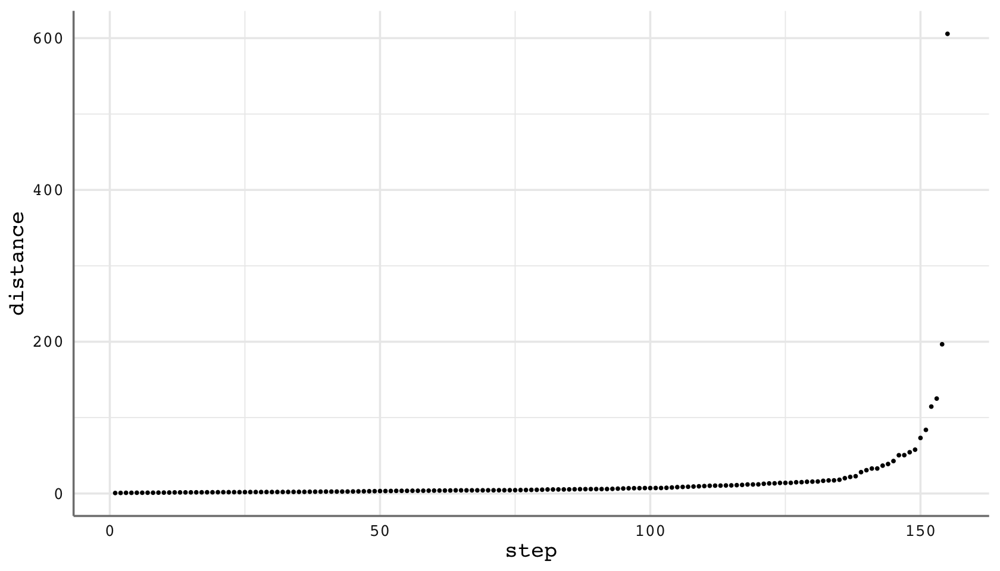

In [758]:
#=== Example 9.4: Evaluate Agglomeration Tables and Plots ====
#Print a table similar to an Agglomeration Schedule
agglomeration_schedule = data.frame(step     = 1:length(hierarchical_cluster$height), # Make step an explicit column
                                    cluster  = hierarchical_cluster$merge, 
                                    distance = hierarchical_cluster$height) %>% # Create a data frame from values in the hierarchical cluster results
  round(2) # Make the distances a bit more human-readable (at least easier to read, for me)

# View Agglomeration Schedule
agglomeration_schedule %>%
  head()

#Print a reversed Scree plot
options(repr.plot.width = 14, repr.plot.height = 8)
agglomeration_schedule %>%
  ggplot(aes(x = step, y = distance)) + 
  geom_point()

In [759]:
#=== Example 9.5: Save Cluster Memberships ====
# Note, in this example, we've decided to use 3 clusters
dataset = df %>%
  cbind(clusters = cutree(hierarchical_cluster, k=2))

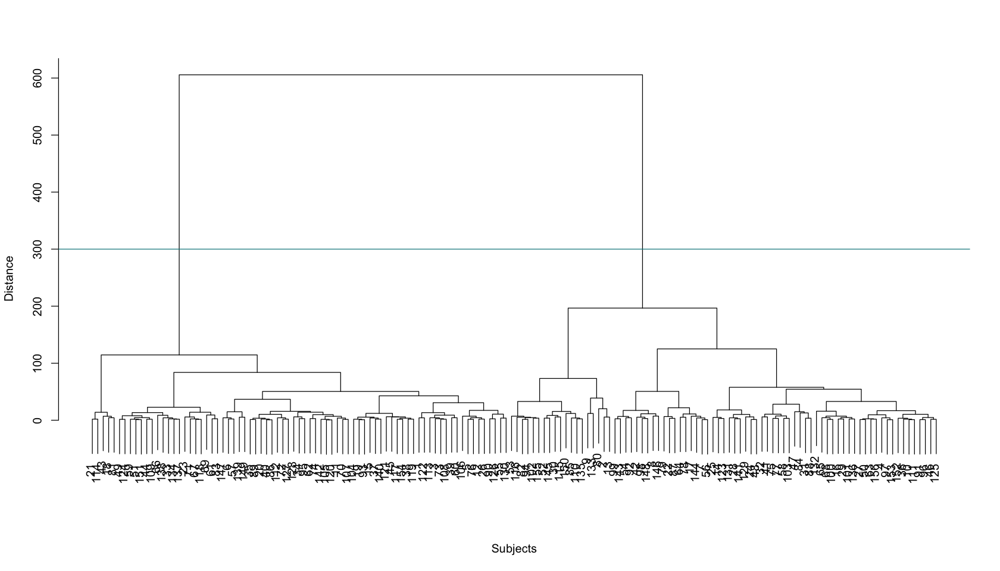

In [760]:
#=== Example 9.6: Create a Visualization ====
hierarchical_cluster %>%
  plot(xlab="Subjects", main = "", sub = "", ylab = "Distance")
abline(h=300, col="turquoise4")

In [761]:
print(colnames(df))

[1] "subjectID"              "grit_score"             "workEthic_score"       
[4] "future_score"           "bscs_score"             "ambition_score"        
[7] "ccs_score"              "needForCognition_score" "w_domain_gap"          


In [762]:
#=== Example 9.7: K-Means Cluster Analysis ====
# First, use your hierarchically derived clusters to export starting centres for K-Means
hierarchical_centres = dataset %>%
  group_by(clusters) %>%
  summarize(ambition = mean(scale(ambition_score)),
            grit   = mean(scale(grit_score)),
            work_ethic   = mean(scale(workEthic_score)),
            future = mean(scale(future_score)),
            self_control   = mean(scale(bscs_score)),
            conscientiousness   = mean(scale(ccs_score)),
            nf_cognition = mean(scale(needForCognition_score)),
            zw_domain_gap   = mean(scale(w_domain_gap))
           ) %>%
  dplyr::select(ambition,
                grit,
                work_ethic,
                future,
                self_control,
                conscientiousness,
                nf_cognition,
                zw_domain_gap)

In [763]:
hierarchical_centres

ambition,grit,work_ethic,future,self_control,conscientiousness,nf_cognition,zw_domain_gap
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
-4.540554e-17,2.599058e-16,-3.984373e-16,-1.341031e-17,-1.135216e-16,7.05013e-17,3.205782e-16,-2.323290e-18
-1.020790e-16,-1.653254e-17,3.357235e-16,1.245721e-16,-2.669879e-16,-1.08765e-16,3.237400e-16,-2.926138e-16


In [764]:
# Next, use hierarchically derived cluster means as start values to k-means
kmeans_cluster = analysis_data %>%
  kmeans(hierarchical_centres, iter.max = 100, algorithm="MacQueen")

# Examine the descriptive stats for each cluster
kmeans_cluster$centers %>%
  print

  grit_score workEthic_score future_score bscs_score ambition_score  ccs_score
1 -0.7899793      -0.5272136   -0.4411879 -0.7635735     -0.4866075 -0.6992602
2  0.5642709       0.3765811    0.3151342  0.5454097      0.3475768  0.4994716
  needForCognition_score zw_domain_gap
1             -0.5710361     0.4735144
2              0.4078830    -0.3382246


In [765]:
#=== Example 9.8: K-Medoids Cluster Analysis ====
kmedoids_cluster = analysis_data %>%
  pam(2) # specify number of clusters

# See the cluster assignments
analysis_data %>%
  cbind(kmedoids_cluster$clustering)
# See the medoids
## Note, they are ordered by cluster number (i.e., row 1 == Cluster 1, ...))
analysis_data %>%
  rownames_to_column("Varietal") %>%
  slice(kmedoids_cluster$id.med)

,grit_score,workEthic_score,future_score,bscs_score,ambition_score,ccs_score,needForCognition_score,zw_domain_gap,kmedoids_cluster$clustering
,"<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>",<int>
1,-0.08310426,1.12974342,-0.67341568,0.32789453,-0.8869934,-0.85800765,-0.16074744,-1.76541087,1
2,-1.22700995,-3.35093386,-2.06946680,-1.54731493,-1.9176896,-2.02772595,-0.55878872,0.21118674,1
3,-0.46440616,0.46593938,0.46087585,0.43207283,-0.3716453,0.68769153,0.33680416,-0.33330221,2
4,-0.84570805,-0.36381568,0.63538224,-1.02642341,0.6590510,0.93834545,-1.25536096,0.24457521,1
5,0.67949954,0.79784140,0.46087585,0.32789453,0.6590510,1.48142895,1.03337640,-0.66601951,2
6,0.10754669,0.46593938,0.80988863,0.74460774,-0.6293193,0.81301849,-1.95193320,-0.41524461,2
7,0.10754669,1.46164544,-0.76066888,-0.29717529,0.6590510,0.43703761,-0.35976808,1.13270860,2
8,0.10754669,-0.03191366,1.76967377,0.01535962,1.4320731,1.14722372,2.22750024,1.55626523,2
9,-0.08310426,-3.18498285,-1.63320083,1.05714265,-2.4330377,-1.56819377,-0.06123712,3.41648016,1


Varietal,grit_score,workEthic_score,future_score,bscs_score,ambition_score,ccs_score,needForCognition_score,zw_domain_gap
<chr>,"<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>","<dbl[,1]>"
10,-1.4176609,-0.5297667,-0.3244029,-0.4013536,-0.3716453,-0.5655781,-0.7578094,0.02198539
51,0.4888486,0.1340374,0.1118631,0.8487860,0.9167250,0.8130185,0.1377835,-0.09656788


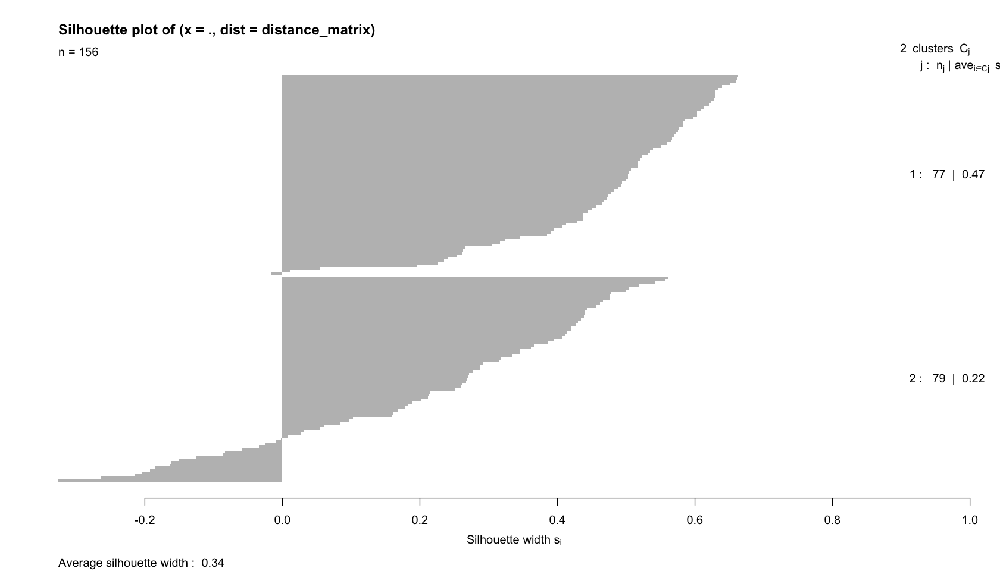

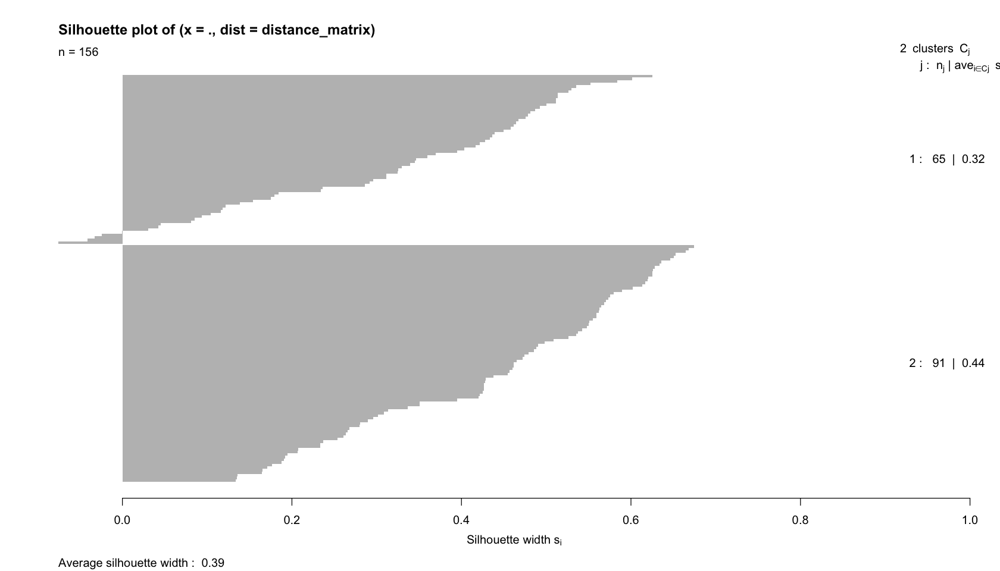

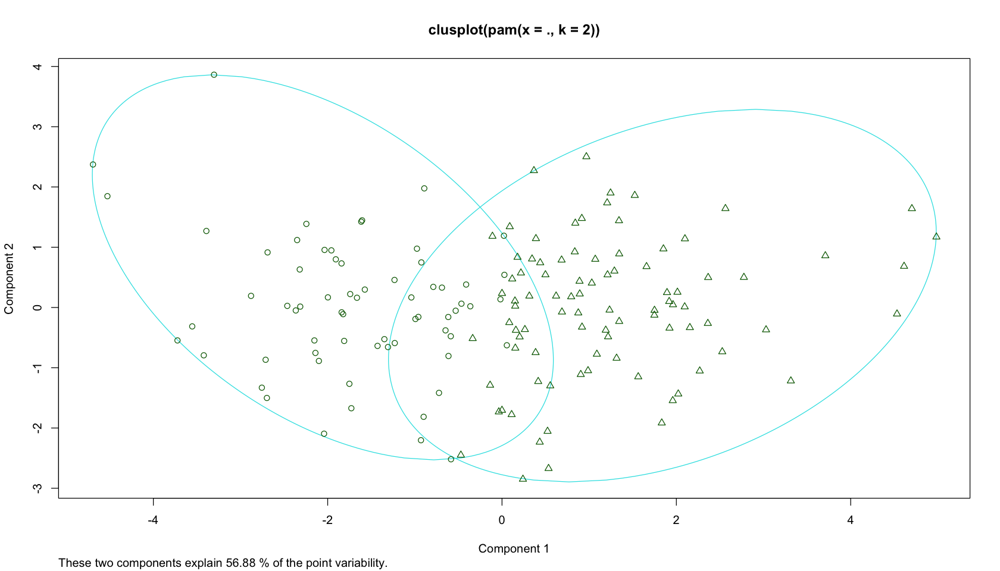

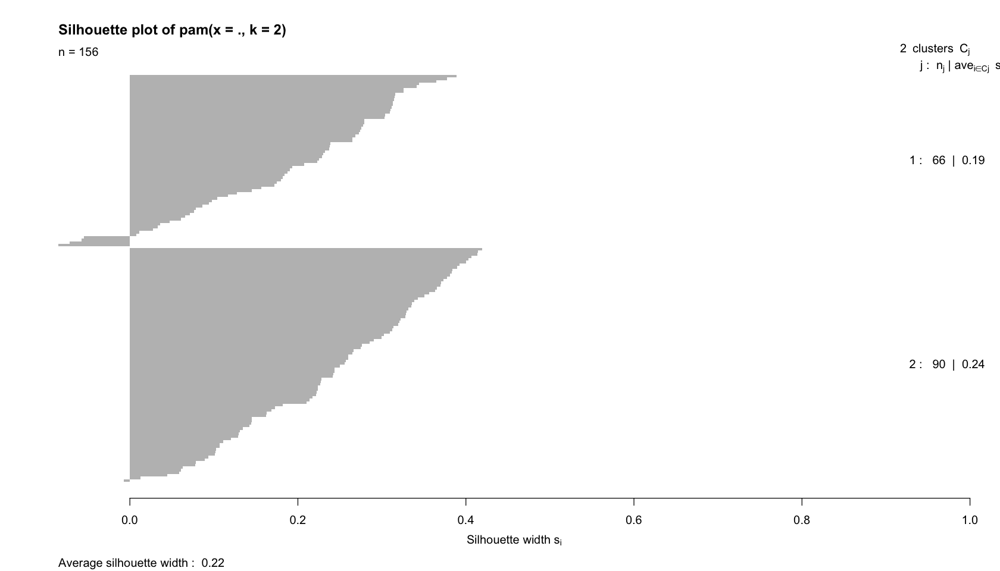

In [766]:
#=== Example 9.9: Evaluating Cluster Structure With Silhouette Statistics ====
# For hierarchical cluster analysis
hierarchical_cluster %>% 
  cutree(k=2) %>% 
  silhouette(distance_matrix) %>% 
  plot

# For k-means cluster analysis
kmeans_cluster$cluster %>%
  silhouette(distance_matrix) %>%
  plot

# For k-medoids
kmedoids_cluster %>%
  plot

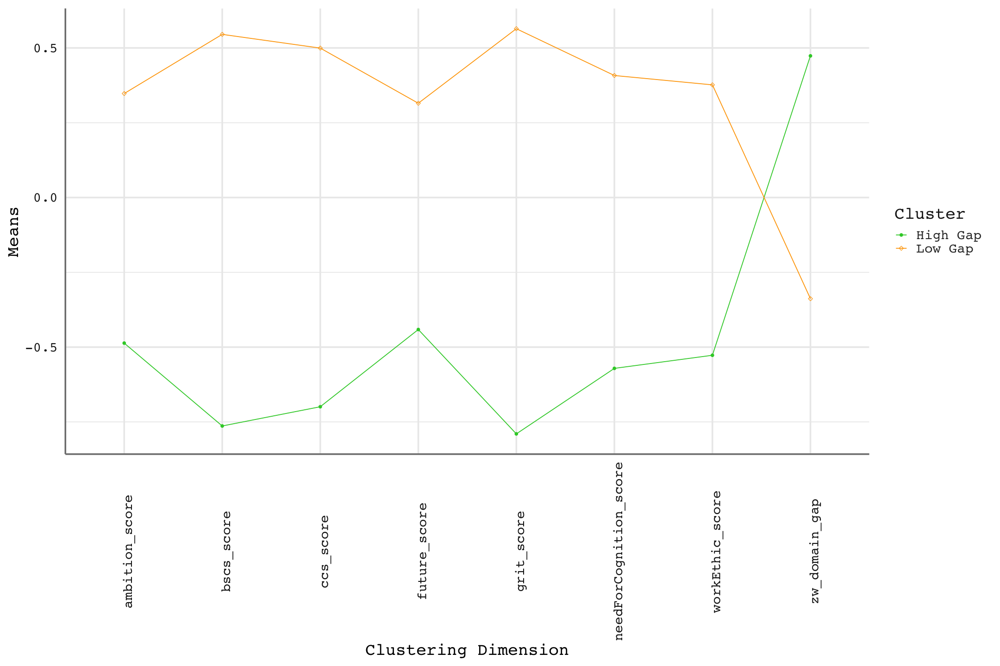

In [768]:
options(repr.plot.width = 18, repr.plot.height = 12)


#=== Example 9.10: Visualizing and Naming Clusters ====
# Create plot of the centres
kmeans_cluster$centers %>%
  as_tibble %>% # The cluster centres are in a matrix by default, so ggplot will need it to be a data frame or tibble
  rownames_to_column("Cluster") %>% # This will provide labels for the clusters
  gather(key = "Clustering Dimension", value = "Means", -Cluster) %>% # This transforms the data into "long form" (think back to MLM Lecture)
  ggplot(aes(x=`Clustering Dimension`, y = Means, group = Cluster, colour = Cluster, shape = Cluster)) + # Call to ggplot
  geom_point() + # Add points
  theme(axis.text.x = element_text(angle = 90)) +
  scale_shape_manual(labels = c("High Gap", "Low Gap"),
                     values = c(19, 5)) + # Use some custom point shapes -- this is totally unnecessary
  geom_line() + # Add lines
  scale_color_manual(labels = c("High Gap", "Low Gap"),
                     values = c("limegreen", "orange")) # Use some custom colours -- this is totally unnecessary


## Domain General Individual Prediction

`df_wide` contains weighted gaps for each domain

What is the error if we subtract the mean of a subject's weigthed gap from each domain's weighted gap vs. subtracting the sample mean?

In [800]:
# get mean weighted gap of sample
samp_wGap_mean = mean(ib_measures_df$w_domain_gap)

In [805]:
# how many domains for each subject
domain_count = rowSums(!is.na(df_wide[,4:35]))

In [801]:
head(df_wide[,4:35])

Admin,Alcohol/drug,Cleaning,Community involvement,Cooking,Culture,Diet,Environment,Exercise,Family,⋯,Self-Improvement,Sleep,Social life,Social Media,Sports,Time Management,TV/Streaming,Video games,Volunteering,Work
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
NA,1.5,4.500,NA,NA,2.25,1.875,4.5,1.500,1.875,⋯,3.75,1.500,1.875,3.0,NA,NA,1.875,NA,2.250,1.875
NA,NA,NA,NA,NA,NA,NA,NA,3.750,NA,⋯,NA,NA,6.750,NA,NA,NA,NA,NA,NA,NA
NA,NA,3.000,1.875,1.5,NA,2.250,NA,4.500,5.625,⋯,3.75,2.250,3.750,4.5,4.5,NA,4.500,4.5,3.750,1.875
6.00,NA,NA,NA,NA,NA,NA,NA,3.375,NA,⋯,4.50,NA,NA,NA,NA,NA,NA,NA,NA,2.250
NA,NA,1.875,4.500,NA,4.50,3.750,3.0,3.750,3.750,⋯,2.25,1.875,3.000,NA,1.5,2.25,NA,NA,3.375,NA
2.25,NA,2.250,NA,7.5,NA,9.000,NA,9.000,NA,⋯,6.75,NA,NA,NA,4.5,3.75,5.625,1.5,NA,4.500


I think technically to be more accurate I should **not include** the subject whose error I am calculating in the mean...

In [811]:
# average error compared to mean?
df_wide$wGap_mse_samp = rowSums((df_wide[,4:35] - samp_wGap_mean)^2, na.rm=TRUE)/domain_count

In [ ]:
for (i in 1:32) {
        df_wide$wGap_mse_samp[i] = rowSums((df_wide[i,4:35] - sub_wGap_mean[i])^2, na.rm=TRUE)/domain_count[i]
}

In [812]:
# calculate weighted mean for each subject
sub_wGap_mean = rowMeans(df_wide[,4:35], na.rm=TRUE)

In [826]:
# average error compared to subject's mean of OTHER categories?
df_wide$wGap_mse_sub = NA

for (i in 1:151) {
        df_wide$wGap_mse_sub[i] = rowSums((df_wide[i,4:35] - sub_wGap_mean[i])^2, na.rm=TRUE)/domain_count[i]
}

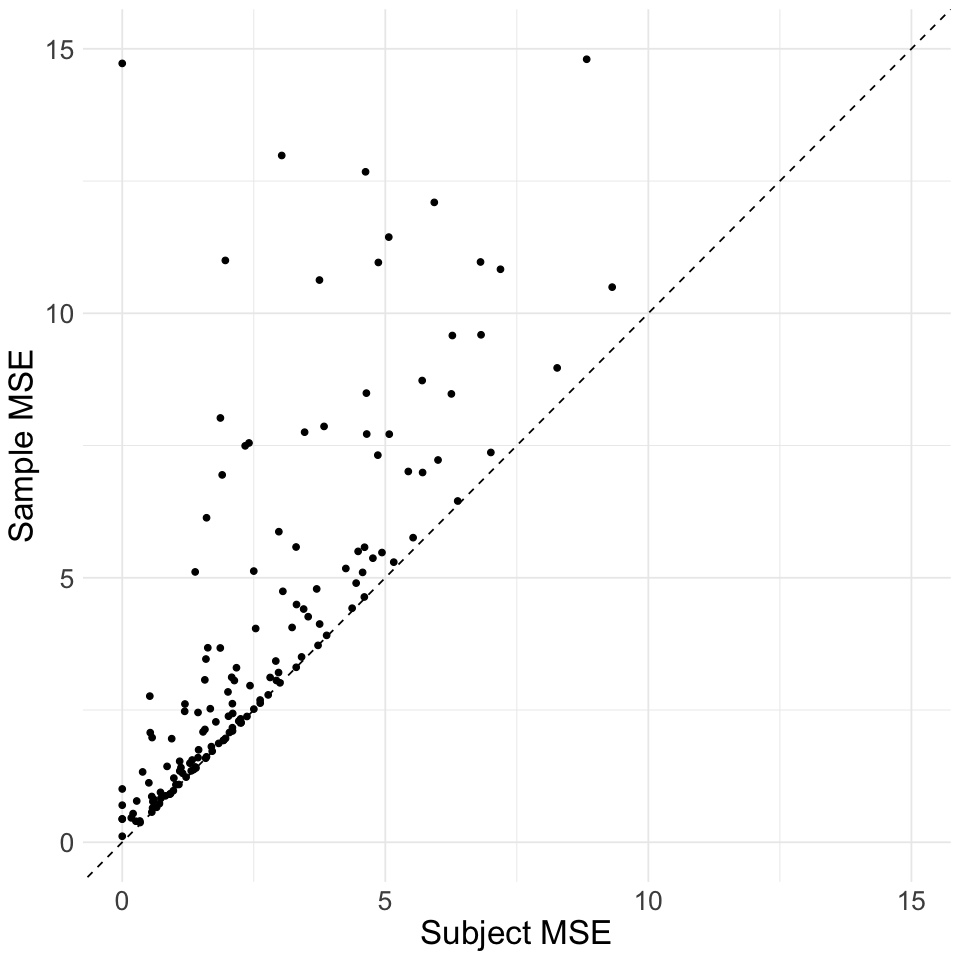

In [839]:
# plot sample vs. subject mse
options(repr.plot.width = 8, repr.plot.height = 8)


ggplot(df_wide, aes(x=wGap_mse_sub, y=wGap_mse_samp)) +
    geom_point() +
geom_abline(intercept = 0, slope=1, lty = 2) +
xlim(0,15) +
ylim(0,15) +
xlab("Subject MSE") + 
ylab("Sample MSE") +
theme_minimal() +
theme(text = element_text(size=20))

## Prescreen

In [770]:
head(qn_df)

StartDate,EndDate,Status,IPAddress,Progress,Duration (in seconds),Finished,RecordedDate,ResponseId,RecipientLastName,⋯,time_sec_work_ethic,time_grit_short,time_tipi,time_debrief,time_need_for_cognition,time_boredom_prone,time_ccs,time_ambition_scale_end,id,subjectID
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
2021-10-21 12:52:22,2021-10-21 13:19:04,0,49.37.163.176,100,1601,1,2021-10-21 13:19:05,R_1ocMarIuuEmzOT7,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,24005,1
2021-10-21 12:51:24,2021-10-21 13:19:37,0,99.227.68.31,100,1693,1,2021-10-21 13:19:38,R_2zUSamRVIcHsqpL,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,24392,2
2021-10-21 12:41:20,2021-10-21 13:31:59,0,138.51.86.46,100,3039,1,2021-10-21 13:32:01,R_1Kxo8rJQWmvddix,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,23419,3
2021-10-21 12:44:29,2021-10-21 13:37:24,0,174.117.46.184,100,3174,1,2021-10-21 13:37:24,R_sMzvZRbS3o4Rkbv,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,23868,4
2021-10-21 12:42:04,2021-10-21 13:41:28,0,47.55.236.122,100,3563,1,2021-10-21 13:41:28,R_2chWUqXeBfeFDc9,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,23502,5
2021-10-21 12:51:57,2021-10-21 13:46:01,0,24.77.3.23,100,3244,1,2021-10-21 13:46:02,R_1I43p6dNAgKoLnI,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,22672,6


In [ ]:
# Calculate Item discrimination index (Boateng)